# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [01:26, 2.09MB/s]                                                                             
SVHN Testing Set: 64.3MB [00:31, 2.05MB/s]                                                                             


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [14]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

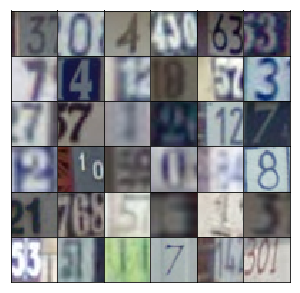

In [15]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [16]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [17]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [18]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [19]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.reshape(tf.layers.dense(z, 4*4*512), (-1,4,4,512))
        x = tf.layers.batch_normalization(x)
        x = tf.maximum(alpha*x, x)
        
        # conv2
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x)
        x = tf.maximum(alpha*x, x)
        
        # conv3
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x)
        x = tf.maximum(alpha*x, x)
        
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, 3, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [28]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x = tf.maximum(alpha*x, x)
        
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha*x, x)
        
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha*x, x)
        
        flat = tf.reshape(x, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [29]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [30]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [31]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [32]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [33]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [38]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1742... Generator Loss: 0.4902
Epoch 1/25... Discriminator Loss: 0.1829... Generator Loss: 2.1353
Epoch 1/25... Discriminator Loss: 0.0517... Generator Loss: 4.3358
Epoch 1/25... Discriminator Loss: 0.0383... Generator Loss: 4.0889
Epoch 1/25... Discriminator Loss: 0.0378... Generator Loss: 4.2420
Epoch 1/25... Discriminator Loss: 0.0526... Generator Loss: 3.2662
Epoch 1/25... Discriminator Loss: 0.0371... Generator Loss: 4.2358
Epoch 1/25... Discriminator Loss: 0.0389... Generator Loss: 5.2946
Epoch 1/25... Discriminator Loss: 0.0390... Generator Loss: 3.8366
Epoch 1/25... Discriminator Loss: 0.0856... Generator Loss: 5.6008


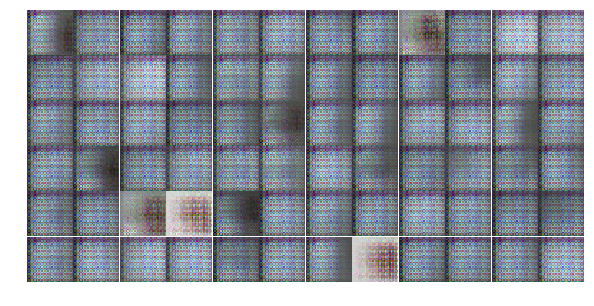

Epoch 1/25... Discriminator Loss: 0.0238... Generator Loss: 4.2029
Epoch 1/25... Discriminator Loss: 0.6862... Generator Loss: 6.4427
Epoch 1/25... Discriminator Loss: 0.2036... Generator Loss: 2.2316
Epoch 1/25... Discriminator Loss: 0.1284... Generator Loss: 3.4099
Epoch 1/25... Discriminator Loss: 0.2478... Generator Loss: 2.1571
Epoch 1/25... Discriminator Loss: 0.1276... Generator Loss: 4.7457
Epoch 1/25... Discriminator Loss: 0.1473... Generator Loss: 3.6475
Epoch 1/25... Discriminator Loss: 0.3618... Generator Loss: 4.4837
Epoch 1/25... Discriminator Loss: 0.1789... Generator Loss: 3.0694
Epoch 1/25... Discriminator Loss: 0.2175... Generator Loss: 2.3544


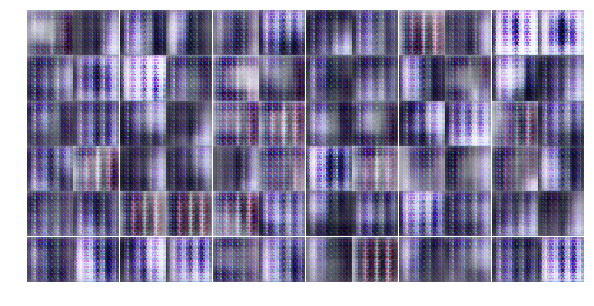

Epoch 1/25... Discriminator Loss: 0.1659... Generator Loss: 2.6634
Epoch 1/25... Discriminator Loss: 0.2485... Generator Loss: 2.9812
Epoch 1/25... Discriminator Loss: 0.1125... Generator Loss: 3.8692
Epoch 1/25... Discriminator Loss: 0.1906... Generator Loss: 2.5874
Epoch 1/25... Discriminator Loss: 0.2798... Generator Loss: 2.7057
Epoch 1/25... Discriminator Loss: 0.3265... Generator Loss: 2.5666
Epoch 1/25... Discriminator Loss: 0.1667... Generator Loss: 3.6815
Epoch 1/25... Discriminator Loss: 0.1056... Generator Loss: 3.7722
Epoch 1/25... Discriminator Loss: 0.4791... Generator Loss: 5.8399
Epoch 1/25... Discriminator Loss: 0.1973... Generator Loss: 2.8273


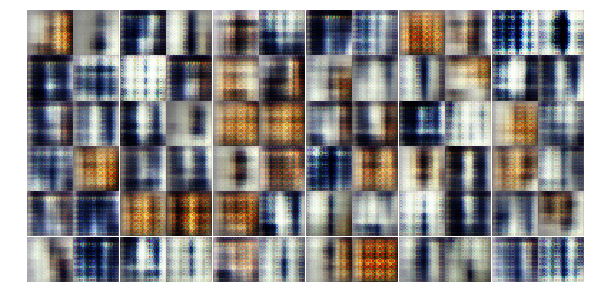

Epoch 1/25... Discriminator Loss: 0.1711... Generator Loss: 3.0760
Epoch 1/25... Discriminator Loss: 0.1748... Generator Loss: 2.9437
Epoch 1/25... Discriminator Loss: 0.2152... Generator Loss: 2.5966
Epoch 1/25... Discriminator Loss: 0.3708... Generator Loss: 2.5116
Epoch 1/25... Discriminator Loss: 0.3704... Generator Loss: 2.5211
Epoch 1/25... Discriminator Loss: 0.2828... Generator Loss: 3.1464
Epoch 1/25... Discriminator Loss: 0.2138... Generator Loss: 2.4527
Epoch 1/25... Discriminator Loss: 0.1617... Generator Loss: 2.7572
Epoch 1/25... Discriminator Loss: 0.5248... Generator Loss: 1.9533
Epoch 1/25... Discriminator Loss: 0.2499... Generator Loss: 2.2662


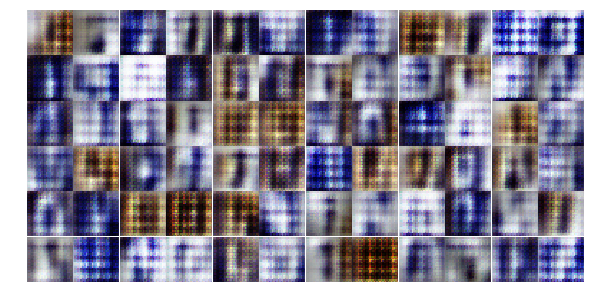

Epoch 1/25... Discriminator Loss: 0.1324... Generator Loss: 3.1348
Epoch 1/25... Discriminator Loss: 0.4728... Generator Loss: 1.4987
Epoch 1/25... Discriminator Loss: 0.1700... Generator Loss: 3.5973
Epoch 1/25... Discriminator Loss: 0.3465... Generator Loss: 2.4012
Epoch 1/25... Discriminator Loss: 0.2019... Generator Loss: 3.4452
Epoch 1/25... Discriminator Loss: 0.1873... Generator Loss: 2.5819
Epoch 1/25... Discriminator Loss: 0.1691... Generator Loss: 2.7798
Epoch 1/25... Discriminator Loss: 0.4503... Generator Loss: 1.6629
Epoch 1/25... Discriminator Loss: 0.3282... Generator Loss: 1.9272
Epoch 1/25... Discriminator Loss: 0.9102... Generator Loss: 3.1323


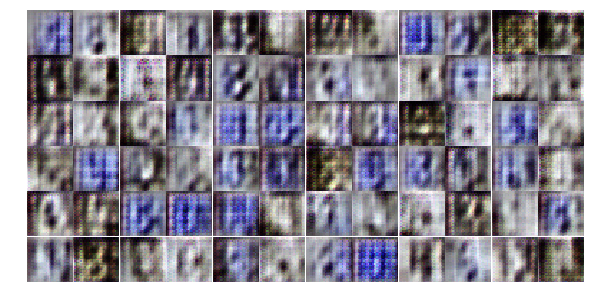

Epoch 1/25... Discriminator Loss: 0.2872... Generator Loss: 2.1743
Epoch 1/25... Discriminator Loss: 0.3121... Generator Loss: 2.2871
Epoch 1/25... Discriminator Loss: 0.2118... Generator Loss: 2.5615
Epoch 1/25... Discriminator Loss: 0.2968... Generator Loss: 3.0358
Epoch 1/25... Discriminator Loss: 0.3400... Generator Loss: 1.8975
Epoch 1/25... Discriminator Loss: 0.4664... Generator Loss: 1.5718
Epoch 1/25... Discriminator Loss: 0.6261... Generator Loss: 1.3680
Epoch 2/25... Discriminator Loss: 0.4378... Generator Loss: 2.9212
Epoch 2/25... Discriminator Loss: 0.8177... Generator Loss: 0.9868
Epoch 2/25... Discriminator Loss: 0.7441... Generator Loss: 1.0812


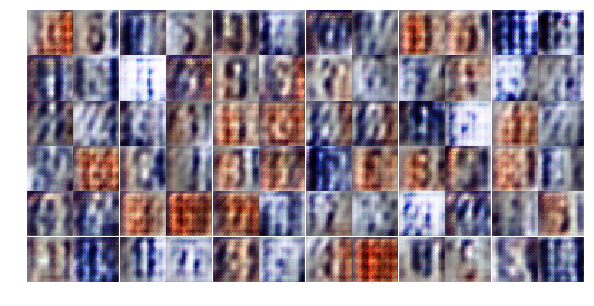

Epoch 2/25... Discriminator Loss: 0.5739... Generator Loss: 1.7289
Epoch 2/25... Discriminator Loss: 0.6033... Generator Loss: 1.4403
Epoch 2/25... Discriminator Loss: 0.4567... Generator Loss: 1.7254
Epoch 2/25... Discriminator Loss: 0.7143... Generator Loss: 1.2388
Epoch 2/25... Discriminator Loss: 0.5657... Generator Loss: 1.3037
Epoch 2/25... Discriminator Loss: 0.4066... Generator Loss: 3.5737
Epoch 2/25... Discriminator Loss: 0.5013... Generator Loss: 2.8476
Epoch 2/25... Discriminator Loss: 0.3591... Generator Loss: 2.2287
Epoch 2/25... Discriminator Loss: 0.8783... Generator Loss: 3.0689
Epoch 2/25... Discriminator Loss: 0.6519... Generator Loss: 2.5951


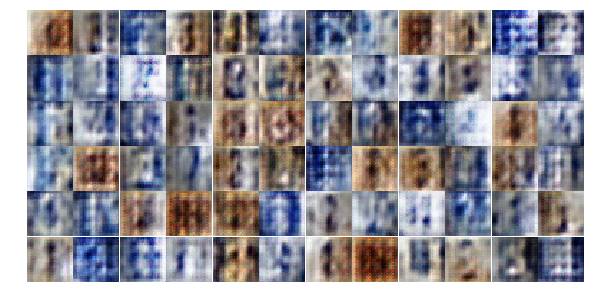

Epoch 2/25... Discriminator Loss: 0.6732... Generator Loss: 1.1915
Epoch 2/25... Discriminator Loss: 0.7628... Generator Loss: 0.9943
Epoch 2/25... Discriminator Loss: 0.5198... Generator Loss: 1.7236
Epoch 2/25... Discriminator Loss: 0.6250... Generator Loss: 1.6449
Epoch 2/25... Discriminator Loss: 0.4402... Generator Loss: 1.6882
Epoch 2/25... Discriminator Loss: 0.6310... Generator Loss: 1.8409
Epoch 2/25... Discriminator Loss: 0.3955... Generator Loss: 2.2526
Epoch 2/25... Discriminator Loss: 0.5170... Generator Loss: 2.1450
Epoch 2/25... Discriminator Loss: 0.5428... Generator Loss: 1.6419
Epoch 2/25... Discriminator Loss: 0.7057... Generator Loss: 1.1562


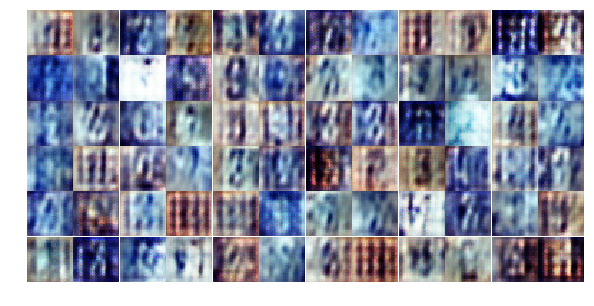

Epoch 2/25... Discriminator Loss: 0.7192... Generator Loss: 2.0494
Epoch 2/25... Discriminator Loss: 1.4412... Generator Loss: 0.4249
Epoch 2/25... Discriminator Loss: 0.7912... Generator Loss: 1.5321
Epoch 2/25... Discriminator Loss: 0.9500... Generator Loss: 3.0769
Epoch 2/25... Discriminator Loss: 0.8407... Generator Loss: 1.6902
Epoch 2/25... Discriminator Loss: 0.5326... Generator Loss: 1.5862
Epoch 2/25... Discriminator Loss: 0.5776... Generator Loss: 1.5563
Epoch 2/25... Discriminator Loss: 0.3859... Generator Loss: 2.0039
Epoch 2/25... Discriminator Loss: 0.6496... Generator Loss: 1.3790
Epoch 2/25... Discriminator Loss: 0.7740... Generator Loss: 1.1732


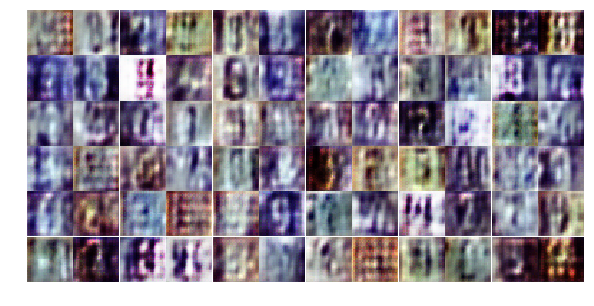

Epoch 2/25... Discriminator Loss: 0.6721... Generator Loss: 1.2614
Epoch 2/25... Discriminator Loss: 0.6149... Generator Loss: 2.1966
Epoch 2/25... Discriminator Loss: 0.7599... Generator Loss: 2.3566
Epoch 2/25... Discriminator Loss: 0.6369... Generator Loss: 1.7067
Epoch 2/25... Discriminator Loss: 0.6487... Generator Loss: 1.4862
Epoch 2/25... Discriminator Loss: 0.7126... Generator Loss: 1.7071
Epoch 2/25... Discriminator Loss: 0.7742... Generator Loss: 1.1132
Epoch 2/25... Discriminator Loss: 0.6835... Generator Loss: 2.1534
Epoch 2/25... Discriminator Loss: 0.8109... Generator Loss: 2.6285
Epoch 2/25... Discriminator Loss: 0.6577... Generator Loss: 1.6044


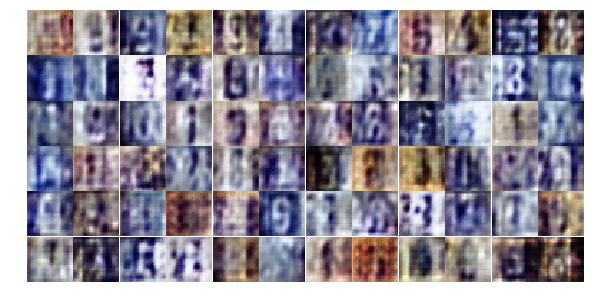

Epoch 2/25... Discriminator Loss: 0.6525... Generator Loss: 1.7815
Epoch 2/25... Discriminator Loss: 0.7454... Generator Loss: 1.5422
Epoch 2/25... Discriminator Loss: 0.6540... Generator Loss: 2.0548
Epoch 2/25... Discriminator Loss: 1.1043... Generator Loss: 0.7378
Epoch 2/25... Discriminator Loss: 0.9956... Generator Loss: 0.9948
Epoch 2/25... Discriminator Loss: 1.2682... Generator Loss: 0.5732
Epoch 2/25... Discriminator Loss: 0.7889... Generator Loss: 1.7779
Epoch 2/25... Discriminator Loss: 1.0488... Generator Loss: 0.9529
Epoch 2/25... Discriminator Loss: 0.8101... Generator Loss: 1.0875
Epoch 2/25... Discriminator Loss: 0.7955... Generator Loss: 1.8176


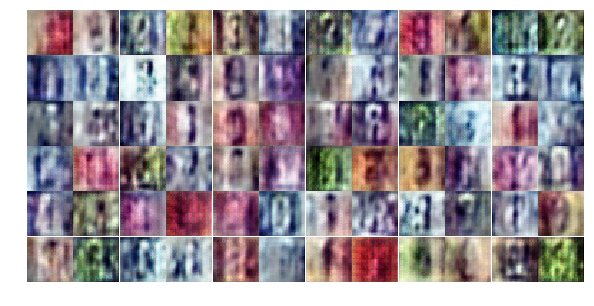

Epoch 2/25... Discriminator Loss: 0.8095... Generator Loss: 1.0106
Epoch 2/25... Discriminator Loss: 0.7917... Generator Loss: 1.0363
Epoch 2/25... Discriminator Loss: 0.9495... Generator Loss: 2.4659
Epoch 2/25... Discriminator Loss: 0.8465... Generator Loss: 1.1544
Epoch 3/25... Discriminator Loss: 0.7614... Generator Loss: 1.5950
Epoch 3/25... Discriminator Loss: 0.9087... Generator Loss: 1.1296
Epoch 3/25... Discriminator Loss: 1.0032... Generator Loss: 0.7805
Epoch 3/25... Discriminator Loss: 0.9187... Generator Loss: 1.0814
Epoch 3/25... Discriminator Loss: 0.7399... Generator Loss: 1.4438
Epoch 3/25... Discriminator Loss: 0.8662... Generator Loss: 2.0385


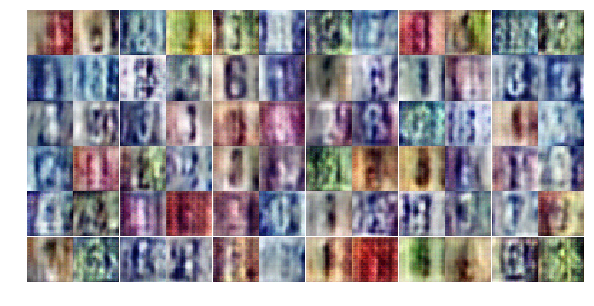

Epoch 3/25... Discriminator Loss: 0.8119... Generator Loss: 1.3944
Epoch 3/25... Discriminator Loss: 0.7476... Generator Loss: 1.3048
Epoch 3/25... Discriminator Loss: 0.9274... Generator Loss: 1.0102
Epoch 3/25... Discriminator Loss: 0.9020... Generator Loss: 1.0213
Epoch 3/25... Discriminator Loss: 1.0617... Generator Loss: 1.0138
Epoch 3/25... Discriminator Loss: 1.0721... Generator Loss: 0.7436
Epoch 3/25... Discriminator Loss: 0.6940... Generator Loss: 1.5931
Epoch 3/25... Discriminator Loss: 0.9074... Generator Loss: 0.9707
Epoch 3/25... Discriminator Loss: 0.7258... Generator Loss: 1.3315
Epoch 3/25... Discriminator Loss: 0.8551... Generator Loss: 1.7259


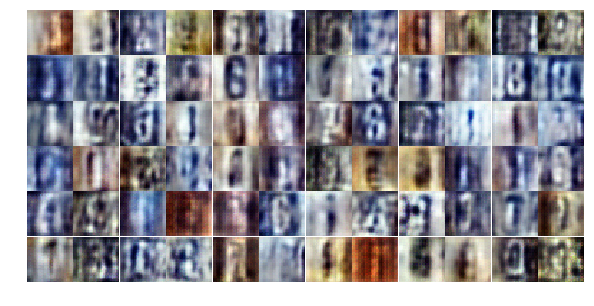

Epoch 3/25... Discriminator Loss: 0.6798... Generator Loss: 1.6631
Epoch 3/25... Discriminator Loss: 0.8035... Generator Loss: 1.9284
Epoch 3/25... Discriminator Loss: 0.6999... Generator Loss: 1.5767
Epoch 3/25... Discriminator Loss: 0.7353... Generator Loss: 1.6076
Epoch 3/25... Discriminator Loss: 0.9108... Generator Loss: 1.4499
Epoch 3/25... Discriminator Loss: 0.7176... Generator Loss: 1.4065
Epoch 3/25... Discriminator Loss: 1.0000... Generator Loss: 0.7349
Epoch 3/25... Discriminator Loss: 0.7149... Generator Loss: 1.3708
Epoch 3/25... Discriminator Loss: 0.5488... Generator Loss: 1.5889
Epoch 3/25... Discriminator Loss: 0.7296... Generator Loss: 1.1481


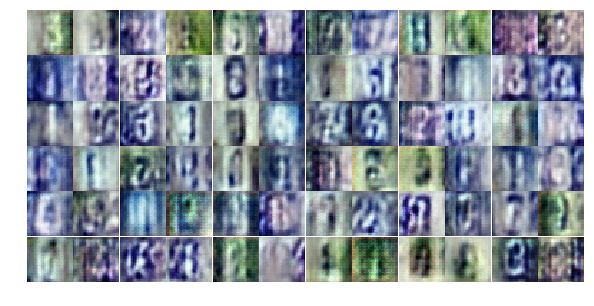

Epoch 3/25... Discriminator Loss: 0.6313... Generator Loss: 1.5301
Epoch 3/25... Discriminator Loss: 0.4357... Generator Loss: 1.7694
Epoch 3/25... Discriminator Loss: 1.4603... Generator Loss: 0.4295
Epoch 3/25... Discriminator Loss: 1.4225... Generator Loss: 0.4193
Epoch 3/25... Discriminator Loss: 0.6323... Generator Loss: 1.5255
Epoch 3/25... Discriminator Loss: 0.8003... Generator Loss: 1.3027
Epoch 3/25... Discriminator Loss: 0.7910... Generator Loss: 1.8357
Epoch 3/25... Discriminator Loss: 0.8223... Generator Loss: 1.5267
Epoch 3/25... Discriminator Loss: 0.7904... Generator Loss: 1.0755
Epoch 3/25... Discriminator Loss: 0.5741... Generator Loss: 1.5594


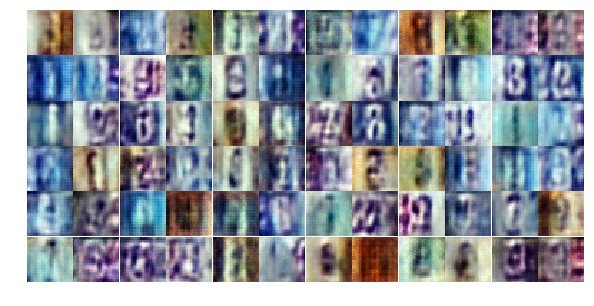

Epoch 3/25... Discriminator Loss: 0.5470... Generator Loss: 1.7747
Epoch 3/25... Discriminator Loss: 0.5794... Generator Loss: 1.4443
Epoch 3/25... Discriminator Loss: 0.5729... Generator Loss: 1.5507
Epoch 3/25... Discriminator Loss: 0.5845... Generator Loss: 1.4137
Epoch 3/25... Discriminator Loss: 0.8037... Generator Loss: 2.5597
Epoch 3/25... Discriminator Loss: 0.8065... Generator Loss: 1.2961
Epoch 3/25... Discriminator Loss: 0.7868... Generator Loss: 1.2490
Epoch 3/25... Discriminator Loss: 0.6008... Generator Loss: 1.3844
Epoch 3/25... Discriminator Loss: 0.7811... Generator Loss: 1.1772
Epoch 3/25... Discriminator Loss: 0.5721... Generator Loss: 1.5320


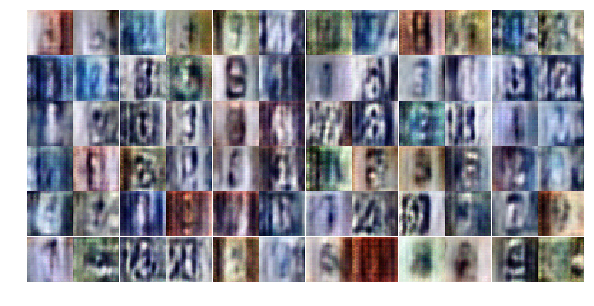

Epoch 3/25... Discriminator Loss: 0.8082... Generator Loss: 1.2177
Epoch 3/25... Discriminator Loss: 0.8695... Generator Loss: 1.6231
Epoch 3/25... Discriminator Loss: 0.8295... Generator Loss: 1.1703
Epoch 3/25... Discriminator Loss: 0.7042... Generator Loss: 1.7912
Epoch 3/25... Discriminator Loss: 0.7433... Generator Loss: 1.1687
Epoch 3/25... Discriminator Loss: 0.5268... Generator Loss: 1.5744
Epoch 3/25... Discriminator Loss: 0.5785... Generator Loss: 1.4289
Epoch 3/25... Discriminator Loss: 0.6877... Generator Loss: 1.5725
Epoch 3/25... Discriminator Loss: 0.8698... Generator Loss: 0.9971
Epoch 3/25... Discriminator Loss: 0.6004... Generator Loss: 1.5886


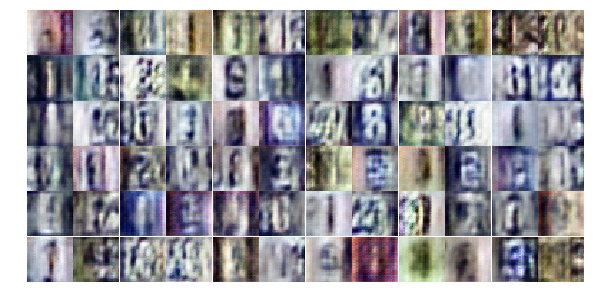

Epoch 3/25... Discriminator Loss: 0.7019... Generator Loss: 2.0853
Epoch 4/25... Discriminator Loss: 0.6212... Generator Loss: 1.3324
Epoch 4/25... Discriminator Loss: 0.6578... Generator Loss: 1.5790
Epoch 4/25... Discriminator Loss: 0.6553... Generator Loss: 1.7979
Epoch 4/25... Discriminator Loss: 0.7342... Generator Loss: 1.2717
Epoch 4/25... Discriminator Loss: 0.8428... Generator Loss: 1.2704
Epoch 4/25... Discriminator Loss: 1.2675... Generator Loss: 0.5443
Epoch 4/25... Discriminator Loss: 0.9293... Generator Loss: 0.9354
Epoch 4/25... Discriminator Loss: 0.6341... Generator Loss: 1.0719
Epoch 4/25... Discriminator Loss: 0.6459... Generator Loss: 1.4297


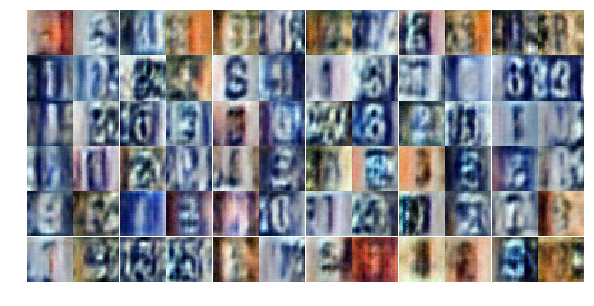

Epoch 4/25... Discriminator Loss: 0.6058... Generator Loss: 1.3376
Epoch 4/25... Discriminator Loss: 0.6809... Generator Loss: 1.3279
Epoch 4/25... Discriminator Loss: 0.7154... Generator Loss: 1.1564
Epoch 4/25... Discriminator Loss: 0.5752... Generator Loss: 1.5345
Epoch 4/25... Discriminator Loss: 0.7996... Generator Loss: 0.9182
Epoch 4/25... Discriminator Loss: 0.9906... Generator Loss: 0.6530
Epoch 4/25... Discriminator Loss: 1.0841... Generator Loss: 0.6375
Epoch 4/25... Discriminator Loss: 0.6050... Generator Loss: 1.2759
Epoch 4/25... Discriminator Loss: 0.6575... Generator Loss: 1.1467
Epoch 4/25... Discriminator Loss: 0.5496... Generator Loss: 1.4038


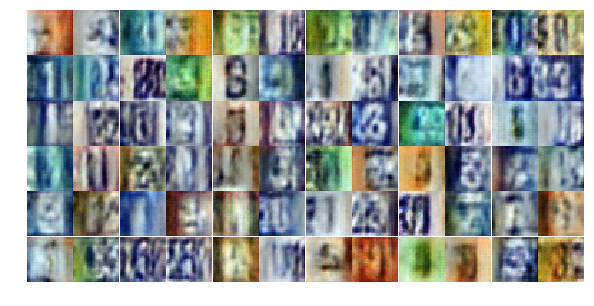

Epoch 4/25... Discriminator Loss: 0.8142... Generator Loss: 1.0006
Epoch 4/25... Discriminator Loss: 0.4911... Generator Loss: 1.6479
Epoch 4/25... Discriminator Loss: 0.5776... Generator Loss: 1.4211
Epoch 4/25... Discriminator Loss: 0.7771... Generator Loss: 1.1818
Epoch 4/25... Discriminator Loss: 0.7245... Generator Loss: 1.0209
Epoch 4/25... Discriminator Loss: 0.5112... Generator Loss: 1.5485
Epoch 4/25... Discriminator Loss: 0.4201... Generator Loss: 1.8331
Epoch 4/25... Discriminator Loss: 0.7029... Generator Loss: 1.1779
Epoch 4/25... Discriminator Loss: 0.4800... Generator Loss: 1.7132
Epoch 4/25... Discriminator Loss: 0.7491... Generator Loss: 1.0078


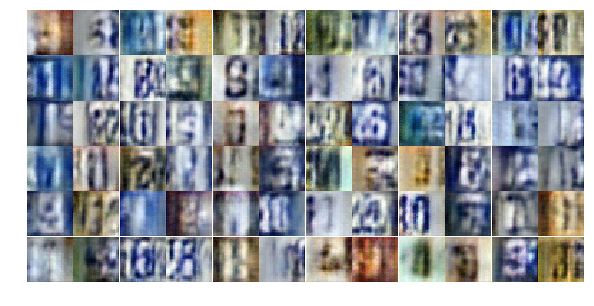

Epoch 4/25... Discriminator Loss: 0.7123... Generator Loss: 2.3464
Epoch 4/25... Discriminator Loss: 0.5528... Generator Loss: 1.6063
Epoch 4/25... Discriminator Loss: 0.6660... Generator Loss: 1.3141
Epoch 4/25... Discriminator Loss: 0.7008... Generator Loss: 1.3218
Epoch 4/25... Discriminator Loss: 0.3644... Generator Loss: 2.0086
Epoch 4/25... Discriminator Loss: 0.6192... Generator Loss: 1.2765
Epoch 4/25... Discriminator Loss: 1.1545... Generator Loss: 0.5791
Epoch 4/25... Discriminator Loss: 0.9090... Generator Loss: 0.6836
Epoch 4/25... Discriminator Loss: 0.7749... Generator Loss: 1.0293
Epoch 4/25... Discriminator Loss: 1.3902... Generator Loss: 0.3995


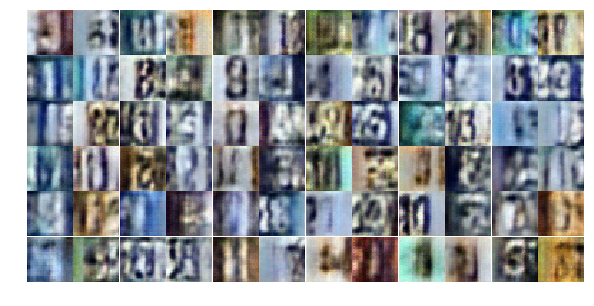

Epoch 4/25... Discriminator Loss: 0.6397... Generator Loss: 1.0950
Epoch 4/25... Discriminator Loss: 0.6587... Generator Loss: 1.0537
Epoch 4/25... Discriminator Loss: 0.7374... Generator Loss: 1.2682
Epoch 4/25... Discriminator Loss: 0.5760... Generator Loss: 1.4544
Epoch 4/25... Discriminator Loss: 0.6323... Generator Loss: 1.1723
Epoch 4/25... Discriminator Loss: 0.6332... Generator Loss: 1.0817
Epoch 4/25... Discriminator Loss: 0.9098... Generator Loss: 0.7792
Epoch 4/25... Discriminator Loss: 0.6960... Generator Loss: 1.3357
Epoch 4/25... Discriminator Loss: 0.7514... Generator Loss: 0.9730
Epoch 4/25... Discriminator Loss: 1.8686... Generator Loss: 0.2551


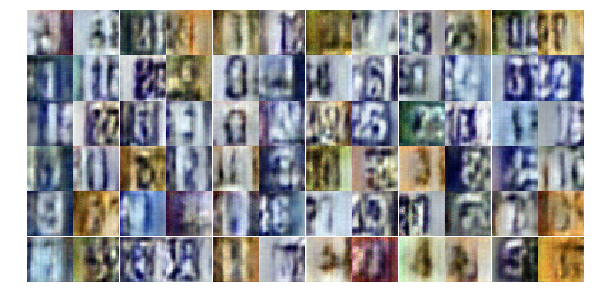

Epoch 4/25... Discriminator Loss: 0.8076... Generator Loss: 1.0075
Epoch 4/25... Discriminator Loss: 0.7597... Generator Loss: 2.0618
Epoch 4/25... Discriminator Loss: 0.6656... Generator Loss: 1.4108
Epoch 4/25... Discriminator Loss: 0.7834... Generator Loss: 0.8872
Epoch 4/25... Discriminator Loss: 1.2715... Generator Loss: 0.5024
Epoch 4/25... Discriminator Loss: 0.5992... Generator Loss: 1.4220
Epoch 4/25... Discriminator Loss: 0.6730... Generator Loss: 1.0810
Epoch 4/25... Discriminator Loss: 1.0395... Generator Loss: 0.6748
Epoch 4/25... Discriminator Loss: 0.6459... Generator Loss: 1.6299
Epoch 5/25... Discriminator Loss: 0.5420... Generator Loss: 1.3449


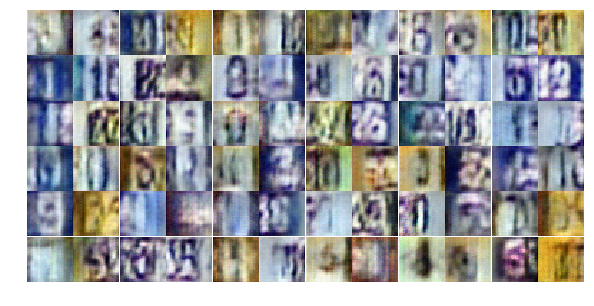

Epoch 5/25... Discriminator Loss: 0.6036... Generator Loss: 1.8531
Epoch 5/25... Discriminator Loss: 0.6396... Generator Loss: 1.4002
Epoch 5/25... Discriminator Loss: 0.8423... Generator Loss: 0.9277
Epoch 5/25... Discriminator Loss: 0.7786... Generator Loss: 0.8629
Epoch 5/25... Discriminator Loss: 0.6936... Generator Loss: 1.1403
Epoch 5/25... Discriminator Loss: 1.0404... Generator Loss: 0.6143
Epoch 5/25... Discriminator Loss: 0.6708... Generator Loss: 1.3913
Epoch 5/25... Discriminator Loss: 0.8517... Generator Loss: 0.9288
Epoch 5/25... Discriminator Loss: 1.0527... Generator Loss: 0.6153
Epoch 5/25... Discriminator Loss: 0.8515... Generator Loss: 1.3007


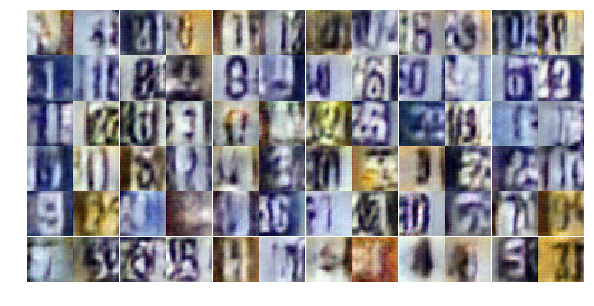

Epoch 5/25... Discriminator Loss: 0.8676... Generator Loss: 0.8733
Epoch 5/25... Discriminator Loss: 0.6996... Generator Loss: 1.0761
Epoch 5/25... Discriminator Loss: 0.5994... Generator Loss: 1.6885
Epoch 5/25... Discriminator Loss: 2.5837... Generator Loss: 0.1363
Epoch 5/25... Discriminator Loss: 0.6771... Generator Loss: 1.1683
Epoch 5/25... Discriminator Loss: 1.2609... Generator Loss: 0.4602
Epoch 5/25... Discriminator Loss: 0.6654... Generator Loss: 1.0842
Epoch 5/25... Discriminator Loss: 0.7091... Generator Loss: 1.0707
Epoch 5/25... Discriminator Loss: 0.7677... Generator Loss: 1.4711
Epoch 5/25... Discriminator Loss: 0.8429... Generator Loss: 0.8691


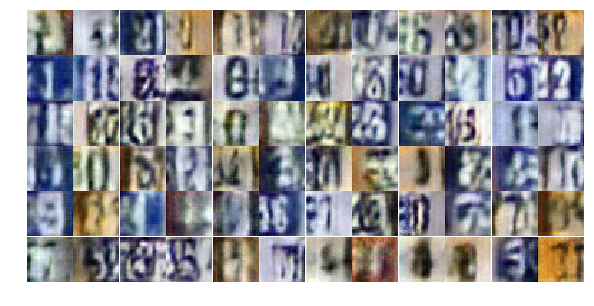

Epoch 5/25... Discriminator Loss: 0.9811... Generator Loss: 0.7015
Epoch 5/25... Discriminator Loss: 1.0772... Generator Loss: 0.6237
Epoch 5/25... Discriminator Loss: 0.8899... Generator Loss: 1.0031
Epoch 5/25... Discriminator Loss: 0.7299... Generator Loss: 1.3454
Epoch 5/25... Discriminator Loss: 1.4019... Generator Loss: 0.5018
Epoch 5/25... Discriminator Loss: 0.6192... Generator Loss: 1.3682
Epoch 5/25... Discriminator Loss: 0.7748... Generator Loss: 0.8342
Epoch 5/25... Discriminator Loss: 1.1328... Generator Loss: 1.5754
Epoch 5/25... Discriminator Loss: 0.7453... Generator Loss: 1.2422
Epoch 5/25... Discriminator Loss: 0.6560... Generator Loss: 1.7999


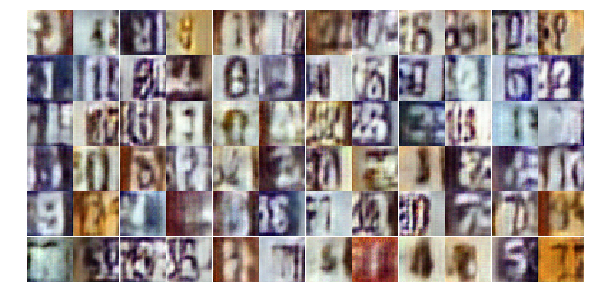

Epoch 5/25... Discriminator Loss: 0.9605... Generator Loss: 0.8426
Epoch 5/25... Discriminator Loss: 0.8518... Generator Loss: 0.9074
Epoch 5/25... Discriminator Loss: 0.5808... Generator Loss: 1.9611
Epoch 5/25... Discriminator Loss: 0.8387... Generator Loss: 0.9333
Epoch 5/25... Discriminator Loss: 0.6280... Generator Loss: 1.4372
Epoch 5/25... Discriminator Loss: 0.7822... Generator Loss: 1.7993
Epoch 5/25... Discriminator Loss: 1.3399... Generator Loss: 0.5052
Epoch 5/25... Discriminator Loss: 1.0211... Generator Loss: 0.6679
Epoch 5/25... Discriminator Loss: 0.9783... Generator Loss: 0.7403
Epoch 5/25... Discriminator Loss: 0.8270... Generator Loss: 1.0061


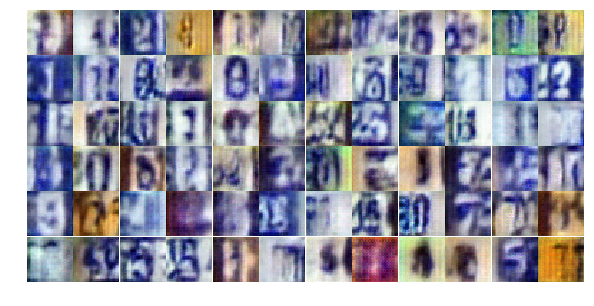

Epoch 5/25... Discriminator Loss: 0.5857... Generator Loss: 1.7539
Epoch 5/25... Discriminator Loss: 0.8945... Generator Loss: 0.8681
Epoch 5/25... Discriminator Loss: 1.0104... Generator Loss: 0.6817
Epoch 5/25... Discriminator Loss: 0.9104... Generator Loss: 0.8661
Epoch 5/25... Discriminator Loss: 1.0389... Generator Loss: 1.2184
Epoch 5/25... Discriminator Loss: 1.0529... Generator Loss: 0.6571
Epoch 5/25... Discriminator Loss: 0.8703... Generator Loss: 0.8107
Epoch 5/25... Discriminator Loss: 0.7862... Generator Loss: 1.1911
Epoch 5/25... Discriminator Loss: 1.0000... Generator Loss: 0.8523
Epoch 5/25... Discriminator Loss: 1.0444... Generator Loss: 0.6538


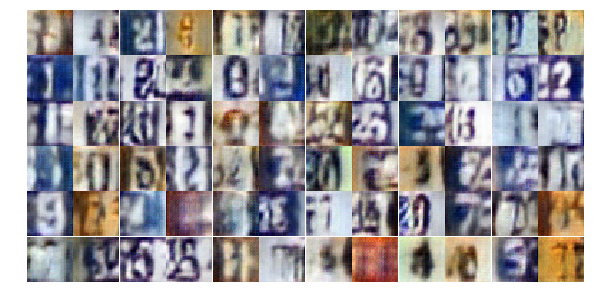

Epoch 5/25... Discriminator Loss: 0.5678... Generator Loss: 1.3616
Epoch 5/25... Discriminator Loss: 0.5556... Generator Loss: 1.4657
Epoch 5/25... Discriminator Loss: 1.2505... Generator Loss: 0.5652
Epoch 5/25... Discriminator Loss: 0.9132... Generator Loss: 0.8143
Epoch 5/25... Discriminator Loss: 0.8101... Generator Loss: 0.9581
Epoch 5/25... Discriminator Loss: 0.9303... Generator Loss: 0.8987
Epoch 6/25... Discriminator Loss: 0.8416... Generator Loss: 1.3584
Epoch 6/25... Discriminator Loss: 1.1702... Generator Loss: 0.6277
Epoch 6/25... Discriminator Loss: 0.7020... Generator Loss: 1.6378
Epoch 6/25... Discriminator Loss: 1.0004... Generator Loss: 0.7326


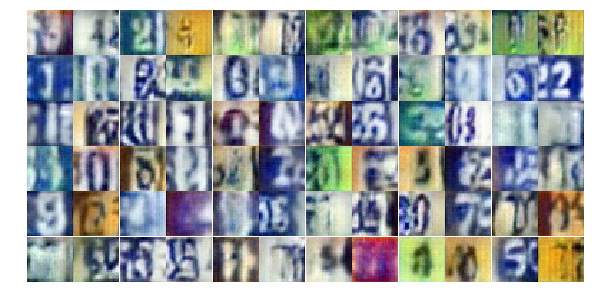

Epoch 6/25... Discriminator Loss: 1.0117... Generator Loss: 0.6712
Epoch 6/25... Discriminator Loss: 0.7776... Generator Loss: 1.4004
Epoch 6/25... Discriminator Loss: 1.1385... Generator Loss: 0.5522
Epoch 6/25... Discriminator Loss: 1.0034... Generator Loss: 0.7732
Epoch 6/25... Discriminator Loss: 0.9229... Generator Loss: 0.9198
Epoch 6/25... Discriminator Loss: 0.9352... Generator Loss: 0.8090
Epoch 6/25... Discriminator Loss: 0.6719... Generator Loss: 1.4786
Epoch 6/25... Discriminator Loss: 0.8267... Generator Loss: 0.9897
Epoch 6/25... Discriminator Loss: 0.8236... Generator Loss: 0.9978
Epoch 6/25... Discriminator Loss: 0.9840... Generator Loss: 2.2187


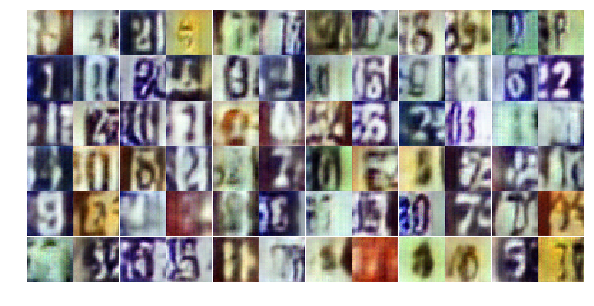

Epoch 6/25... Discriminator Loss: 0.8384... Generator Loss: 1.0821
Epoch 6/25... Discriminator Loss: 0.4583... Generator Loss: 1.8234
Epoch 6/25... Discriminator Loss: 0.7441... Generator Loss: 1.1031
Epoch 6/25... Discriminator Loss: 0.8600... Generator Loss: 1.0522
Epoch 6/25... Discriminator Loss: 0.6437... Generator Loss: 1.8787
Epoch 6/25... Discriminator Loss: 0.8664... Generator Loss: 1.2065
Epoch 6/25... Discriminator Loss: 0.7706... Generator Loss: 1.2874
Epoch 6/25... Discriminator Loss: 0.9659... Generator Loss: 0.8301
Epoch 6/25... Discriminator Loss: 0.9065... Generator Loss: 1.5847
Epoch 6/25... Discriminator Loss: 0.7290... Generator Loss: 1.0644


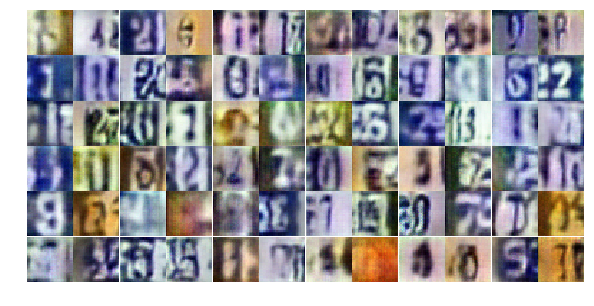

Epoch 6/25... Discriminator Loss: 0.9406... Generator Loss: 0.7545
Epoch 6/25... Discriminator Loss: 0.8248... Generator Loss: 1.0411
Epoch 6/25... Discriminator Loss: 1.0287... Generator Loss: 0.7028
Epoch 6/25... Discriminator Loss: 0.9360... Generator Loss: 0.8499
Epoch 6/25... Discriminator Loss: 0.6792... Generator Loss: 1.6565
Epoch 6/25... Discriminator Loss: 1.1336... Generator Loss: 0.6702
Epoch 6/25... Discriminator Loss: 1.1427... Generator Loss: 0.5511
Epoch 6/25... Discriminator Loss: 0.6423... Generator Loss: 1.1547
Epoch 6/25... Discriminator Loss: 0.7826... Generator Loss: 1.1024
Epoch 6/25... Discriminator Loss: 0.9846... Generator Loss: 0.8146


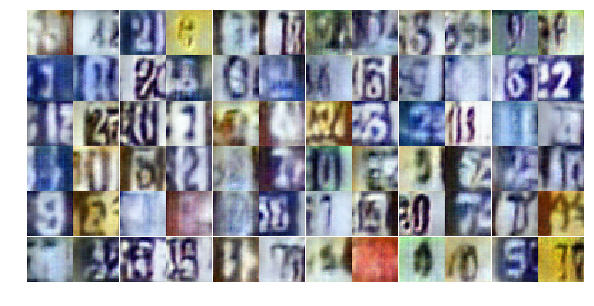

Epoch 6/25... Discriminator Loss: 0.9873... Generator Loss: 1.6290
Epoch 6/25... Discriminator Loss: 0.9736... Generator Loss: 0.9148
Epoch 6/25... Discriminator Loss: 1.0071... Generator Loss: 0.8460
Epoch 6/25... Discriminator Loss: 1.1139... Generator Loss: 0.6551
Epoch 6/25... Discriminator Loss: 1.0287... Generator Loss: 0.7945
Epoch 6/25... Discriminator Loss: 0.9115... Generator Loss: 0.9118
Epoch 6/25... Discriminator Loss: 0.6359... Generator Loss: 1.3930
Epoch 6/25... Discriminator Loss: 0.8261... Generator Loss: 1.2164
Epoch 6/25... Discriminator Loss: 0.9485... Generator Loss: 0.8423
Epoch 6/25... Discriminator Loss: 0.7887... Generator Loss: 1.0476


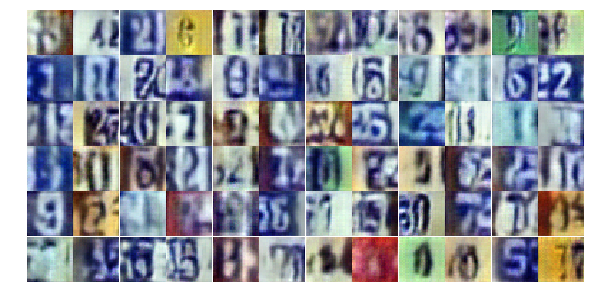

Epoch 6/25... Discriminator Loss: 0.9955... Generator Loss: 0.8729
Epoch 6/25... Discriminator Loss: 0.9346... Generator Loss: 0.7849
Epoch 6/25... Discriminator Loss: 0.9574... Generator Loss: 0.8401
Epoch 6/25... Discriminator Loss: 1.0058... Generator Loss: 1.7962
Epoch 6/25... Discriminator Loss: 1.0110... Generator Loss: 1.1677
Epoch 6/25... Discriminator Loss: 0.9886... Generator Loss: 1.1049
Epoch 6/25... Discriminator Loss: 0.9680... Generator Loss: 0.6962
Epoch 6/25... Discriminator Loss: 1.1334... Generator Loss: 0.7491
Epoch 6/25... Discriminator Loss: 0.7364... Generator Loss: 1.1805
Epoch 6/25... Discriminator Loss: 1.5582... Generator Loss: 0.3088


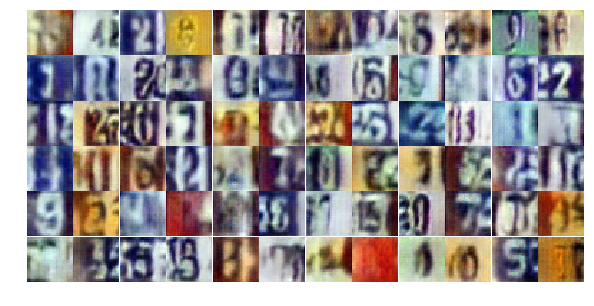

Epoch 6/25... Discriminator Loss: 0.7062... Generator Loss: 1.3737
Epoch 6/25... Discriminator Loss: 1.0616... Generator Loss: 0.8222
Epoch 6/25... Discriminator Loss: 0.7676... Generator Loss: 1.1224
Epoch 7/25... Discriminator Loss: 1.0912... Generator Loss: 1.6311
Epoch 7/25... Discriminator Loss: 0.8636... Generator Loss: 1.0559
Epoch 7/25... Discriminator Loss: 0.8634... Generator Loss: 1.0571
Epoch 7/25... Discriminator Loss: 0.8101... Generator Loss: 1.2767
Epoch 7/25... Discriminator Loss: 0.8772... Generator Loss: 0.9190
Epoch 7/25... Discriminator Loss: 0.6281... Generator Loss: 1.3438
Epoch 7/25... Discriminator Loss: 0.9687... Generator Loss: 0.8713


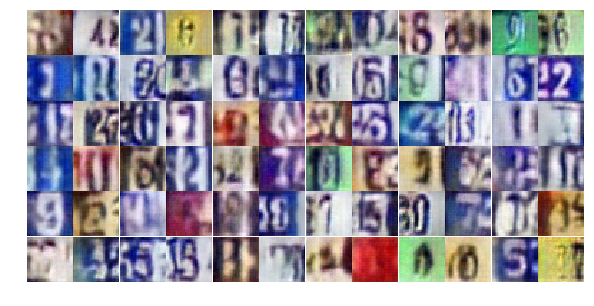

Epoch 7/25... Discriminator Loss: 0.8776... Generator Loss: 1.3138
Epoch 7/25... Discriminator Loss: 0.9388... Generator Loss: 0.7798
Epoch 7/25... Discriminator Loss: 0.9813... Generator Loss: 0.8159
Epoch 7/25... Discriminator Loss: 0.8779... Generator Loss: 1.0059
Epoch 7/25... Discriminator Loss: 0.7327... Generator Loss: 1.1753
Epoch 7/25... Discriminator Loss: 0.7334... Generator Loss: 1.1984
Epoch 7/25... Discriminator Loss: 0.9725... Generator Loss: 1.7687
Epoch 7/25... Discriminator Loss: 0.9698... Generator Loss: 1.1734
Epoch 7/25... Discriminator Loss: 0.8170... Generator Loss: 1.3937
Epoch 7/25... Discriminator Loss: 0.7993... Generator Loss: 1.1961


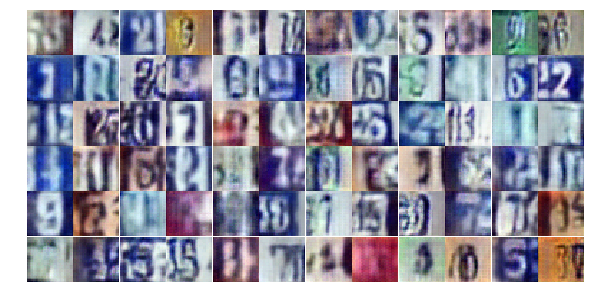

Epoch 7/25... Discriminator Loss: 1.0594... Generator Loss: 0.6656
Epoch 7/25... Discriminator Loss: 0.8437... Generator Loss: 0.9958
Epoch 7/25... Discriminator Loss: 1.1251... Generator Loss: 0.7580
Epoch 7/25... Discriminator Loss: 0.9054... Generator Loss: 1.0512
Epoch 7/25... Discriminator Loss: 0.8362... Generator Loss: 1.0339
Epoch 7/25... Discriminator Loss: 0.7092... Generator Loss: 1.2861
Epoch 7/25... Discriminator Loss: 0.7522... Generator Loss: 1.0217
Epoch 7/25... Discriminator Loss: 1.2034... Generator Loss: 0.6056
Epoch 7/25... Discriminator Loss: 0.7407... Generator Loss: 1.2626
Epoch 7/25... Discriminator Loss: 0.9880... Generator Loss: 0.7351


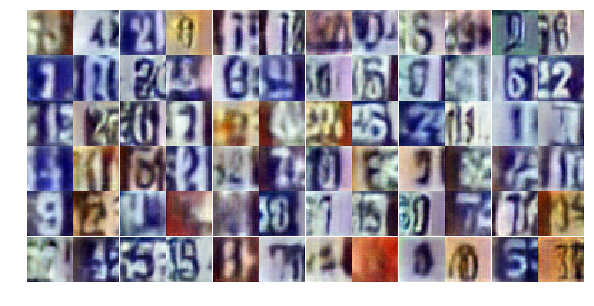

Epoch 7/25... Discriminator Loss: 1.1856... Generator Loss: 0.6152
Epoch 7/25... Discriminator Loss: 1.0213... Generator Loss: 0.6255
Epoch 7/25... Discriminator Loss: 0.7300... Generator Loss: 1.3185
Epoch 7/25... Discriminator Loss: 1.0606... Generator Loss: 0.7282
Epoch 7/25... Discriminator Loss: 0.8392... Generator Loss: 1.0286
Epoch 7/25... Discriminator Loss: 0.8537... Generator Loss: 0.9352
Epoch 7/25... Discriminator Loss: 0.9598... Generator Loss: 0.8203
Epoch 7/25... Discriminator Loss: 1.0500... Generator Loss: 0.7633
Epoch 7/25... Discriminator Loss: 1.1271... Generator Loss: 1.1220
Epoch 7/25... Discriminator Loss: 0.7282... Generator Loss: 1.4518


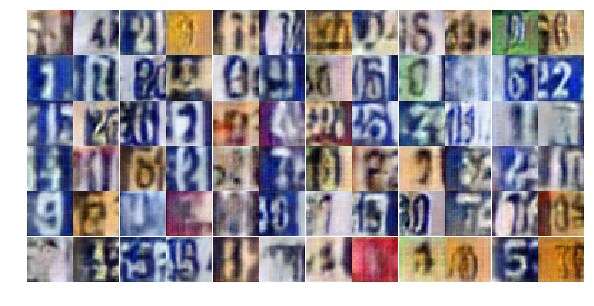

Epoch 7/25... Discriminator Loss: 1.1223... Generator Loss: 0.7679
Epoch 7/25... Discriminator Loss: 0.6421... Generator Loss: 1.2796
Epoch 7/25... Discriminator Loss: 1.0435... Generator Loss: 0.6935
Epoch 7/25... Discriminator Loss: 0.8080... Generator Loss: 1.4665
Epoch 7/25... Discriminator Loss: 0.9041... Generator Loss: 1.4509
Epoch 7/25... Discriminator Loss: 0.6396... Generator Loss: 1.3507
Epoch 7/25... Discriminator Loss: 1.0873... Generator Loss: 0.8947
Epoch 7/25... Discriminator Loss: 1.2942... Generator Loss: 0.4953
Epoch 7/25... Discriminator Loss: 0.9127... Generator Loss: 1.8719
Epoch 7/25... Discriminator Loss: 0.9593... Generator Loss: 1.1043


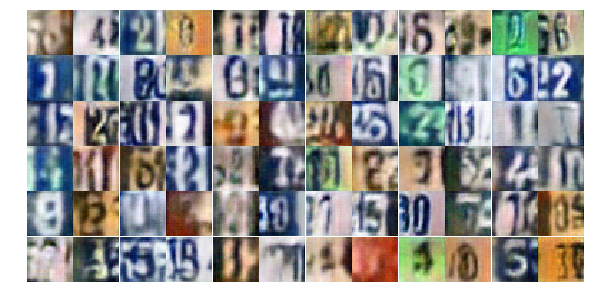

Epoch 7/25... Discriminator Loss: 0.6974... Generator Loss: 1.2851
Epoch 7/25... Discriminator Loss: 1.1355... Generator Loss: 0.5925
Epoch 7/25... Discriminator Loss: 0.9280... Generator Loss: 0.8442
Epoch 7/25... Discriminator Loss: 0.6604... Generator Loss: 1.5056
Epoch 7/25... Discriminator Loss: 0.7907... Generator Loss: 1.0284
Epoch 7/25... Discriminator Loss: 0.9170... Generator Loss: 0.8134
Epoch 7/25... Discriminator Loss: 0.9563... Generator Loss: 0.7541
Epoch 7/25... Discriminator Loss: 0.9032... Generator Loss: 1.2986
Epoch 7/25... Discriminator Loss: 1.0052... Generator Loss: 0.7607
Epoch 7/25... Discriminator Loss: 0.8063... Generator Loss: 0.9950


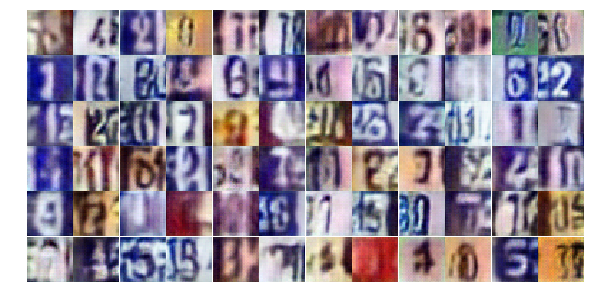

Epoch 7/25... Discriminator Loss: 0.8168... Generator Loss: 1.6024
Epoch 8/25... Discriminator Loss: 0.9783... Generator Loss: 0.9134
Epoch 8/25... Discriminator Loss: 1.1198... Generator Loss: 0.5841
Epoch 8/25... Discriminator Loss: 0.8034... Generator Loss: 1.2151
Epoch 8/25... Discriminator Loss: 0.8397... Generator Loss: 1.0890
Epoch 8/25... Discriminator Loss: 1.1542... Generator Loss: 0.6523
Epoch 8/25... Discriminator Loss: 0.7930... Generator Loss: 0.9033
Epoch 8/25... Discriminator Loss: 0.9685... Generator Loss: 1.1533
Epoch 8/25... Discriminator Loss: 0.8174... Generator Loss: 1.1542
Epoch 8/25... Discriminator Loss: 0.9175... Generator Loss: 0.8452


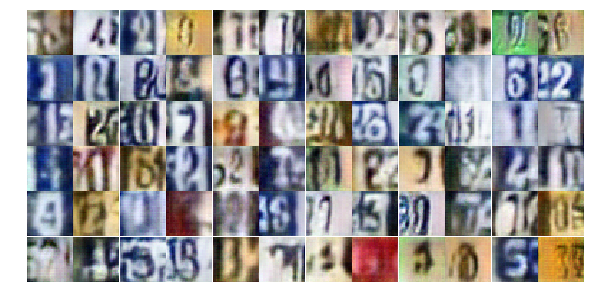

Epoch 8/25... Discriminator Loss: 0.7882... Generator Loss: 1.2527
Epoch 8/25... Discriminator Loss: 0.8135... Generator Loss: 0.9890
Epoch 8/25... Discriminator Loss: 1.1431... Generator Loss: 0.5458
Epoch 8/25... Discriminator Loss: 0.8406... Generator Loss: 1.2578
Epoch 8/25... Discriminator Loss: 1.1296... Generator Loss: 0.6410
Epoch 8/25... Discriminator Loss: 0.7431... Generator Loss: 1.1977
Epoch 8/25... Discriminator Loss: 0.7175... Generator Loss: 1.2306
Epoch 8/25... Discriminator Loss: 0.9571... Generator Loss: 0.7573
Epoch 8/25... Discriminator Loss: 0.6884... Generator Loss: 1.2126
Epoch 8/25... Discriminator Loss: 1.1359... Generator Loss: 1.5508


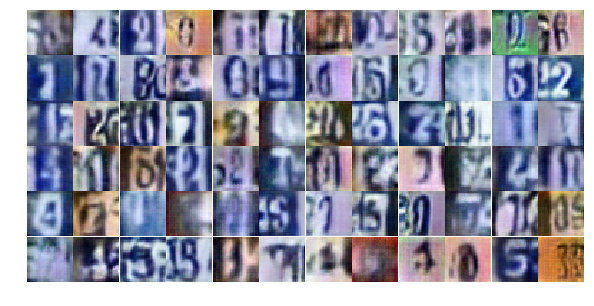

Epoch 8/25... Discriminator Loss: 0.7964... Generator Loss: 1.0598
Epoch 8/25... Discriminator Loss: 0.8261... Generator Loss: 0.9568
Epoch 8/25... Discriminator Loss: 0.9183... Generator Loss: 0.9024
Epoch 8/25... Discriminator Loss: 0.8859... Generator Loss: 1.0487
Epoch 8/25... Discriminator Loss: 0.8468... Generator Loss: 0.8898
Epoch 8/25... Discriminator Loss: 0.7697... Generator Loss: 1.3273
Epoch 8/25... Discriminator Loss: 0.9567... Generator Loss: 0.8870
Epoch 8/25... Discriminator Loss: 1.0074... Generator Loss: 0.6943
Epoch 8/25... Discriminator Loss: 1.0076... Generator Loss: 1.7323
Epoch 8/25... Discriminator Loss: 0.8686... Generator Loss: 1.0195


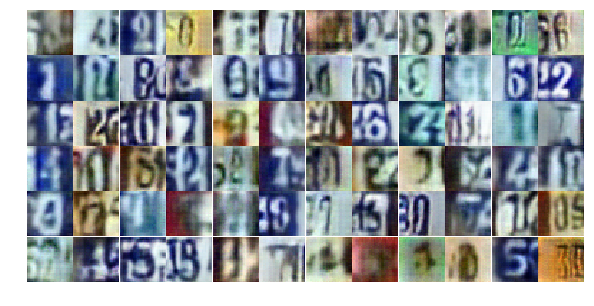

Epoch 8/25... Discriminator Loss: 0.9265... Generator Loss: 0.7834
Epoch 8/25... Discriminator Loss: 1.1598... Generator Loss: 0.6634
Epoch 8/25... Discriminator Loss: 0.7629... Generator Loss: 1.2405
Epoch 8/25... Discriminator Loss: 1.0402... Generator Loss: 0.6904
Epoch 8/25... Discriminator Loss: 0.8672... Generator Loss: 1.1857
Epoch 8/25... Discriminator Loss: 0.9249... Generator Loss: 0.8423
Epoch 8/25... Discriminator Loss: 0.8884... Generator Loss: 1.0633
Epoch 8/25... Discriminator Loss: 0.8589... Generator Loss: 0.9598
Epoch 8/25... Discriminator Loss: 1.0263... Generator Loss: 1.0055
Epoch 8/25... Discriminator Loss: 0.7424... Generator Loss: 1.2235


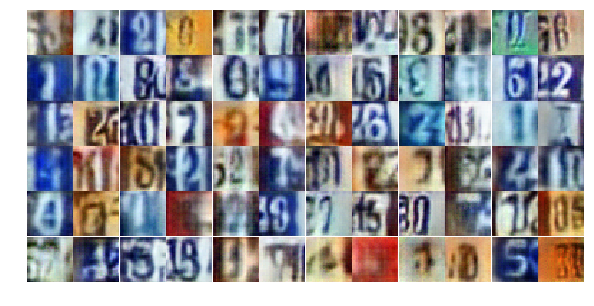

Epoch 8/25... Discriminator Loss: 0.7830... Generator Loss: 1.2874
Epoch 8/25... Discriminator Loss: 1.1809... Generator Loss: 0.6081
Epoch 8/25... Discriminator Loss: 0.7796... Generator Loss: 0.9006
Epoch 8/25... Discriminator Loss: 0.9736... Generator Loss: 1.4105
Epoch 8/25... Discriminator Loss: 1.1610... Generator Loss: 2.2806
Epoch 8/25... Discriminator Loss: 0.9419... Generator Loss: 0.7950
Epoch 8/25... Discriminator Loss: 0.9127... Generator Loss: 0.7905
Epoch 8/25... Discriminator Loss: 0.8259... Generator Loss: 1.1059
Epoch 8/25... Discriminator Loss: 1.0230... Generator Loss: 0.7339
Epoch 8/25... Discriminator Loss: 1.0595... Generator Loss: 0.7494


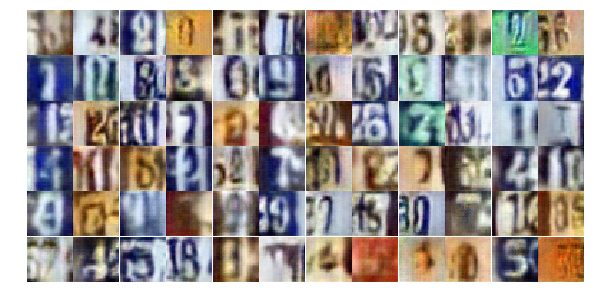

Epoch 8/25... Discriminator Loss: 1.2047... Generator Loss: 0.5667
Epoch 8/25... Discriminator Loss: 0.9110... Generator Loss: 0.9040
Epoch 8/25... Discriminator Loss: 0.7709... Generator Loss: 1.1711
Epoch 8/25... Discriminator Loss: 0.9038... Generator Loss: 0.8681
Epoch 8/25... Discriminator Loss: 0.9180... Generator Loss: 1.5851
Epoch 8/25... Discriminator Loss: 1.0884... Generator Loss: 0.7522
Epoch 8/25... Discriminator Loss: 0.9612... Generator Loss: 0.7086
Epoch 8/25... Discriminator Loss: 1.0259... Generator Loss: 1.7626
Epoch 9/25... Discriminator Loss: 1.1429... Generator Loss: 0.9640
Epoch 9/25... Discriminator Loss: 1.3129... Generator Loss: 0.4934


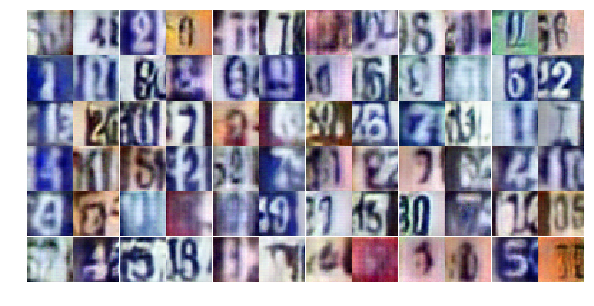

Epoch 9/25... Discriminator Loss: 0.8382... Generator Loss: 0.9452
Epoch 9/25... Discriminator Loss: 0.9371... Generator Loss: 0.8280
Epoch 9/25... Discriminator Loss: 1.1575... Generator Loss: 0.6060
Epoch 9/25... Discriminator Loss: 0.9320... Generator Loss: 0.7711
Epoch 9/25... Discriminator Loss: 1.0693... Generator Loss: 0.6477
Epoch 9/25... Discriminator Loss: 0.7950... Generator Loss: 1.1188
Epoch 9/25... Discriminator Loss: 1.0203... Generator Loss: 0.9403
Epoch 9/25... Discriminator Loss: 0.7267... Generator Loss: 1.1271
Epoch 9/25... Discriminator Loss: 0.9429... Generator Loss: 0.8528
Epoch 9/25... Discriminator Loss: 0.8627... Generator Loss: 1.9620


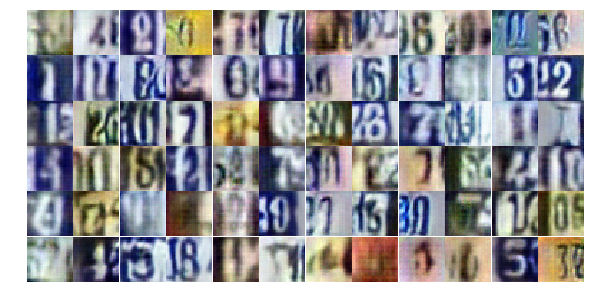

Epoch 9/25... Discriminator Loss: 1.0898... Generator Loss: 0.7032
Epoch 9/25... Discriminator Loss: 0.9831... Generator Loss: 0.6740
Epoch 9/25... Discriminator Loss: 1.0524... Generator Loss: 0.6525
Epoch 9/25... Discriminator Loss: 1.1885... Generator Loss: 0.5959
Epoch 9/25... Discriminator Loss: 0.7113... Generator Loss: 1.1627
Epoch 9/25... Discriminator Loss: 1.0668... Generator Loss: 0.6773
Epoch 9/25... Discriminator Loss: 1.1946... Generator Loss: 0.5074
Epoch 9/25... Discriminator Loss: 0.9343... Generator Loss: 1.0733
Epoch 9/25... Discriminator Loss: 0.9866... Generator Loss: 0.8014
Epoch 9/25... Discriminator Loss: 0.8787... Generator Loss: 0.8751


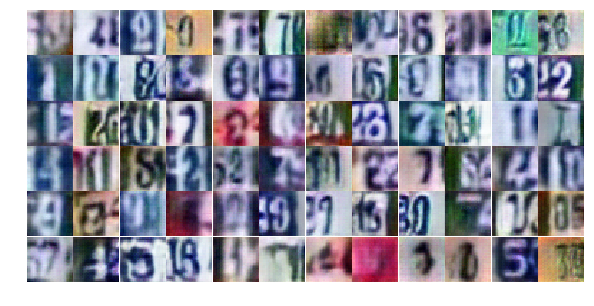

Epoch 9/25... Discriminator Loss: 0.9404... Generator Loss: 0.9132
Epoch 9/25... Discriminator Loss: 1.0429... Generator Loss: 0.6613
Epoch 9/25... Discriminator Loss: 0.8060... Generator Loss: 1.0455
Epoch 9/25... Discriminator Loss: 0.9830... Generator Loss: 0.8552
Epoch 9/25... Discriminator Loss: 1.0176... Generator Loss: 0.6219
Epoch 9/25... Discriminator Loss: 0.9036... Generator Loss: 0.9930
Epoch 9/25... Discriminator Loss: 0.8340... Generator Loss: 1.1278
Epoch 9/25... Discriminator Loss: 0.9681... Generator Loss: 1.0830
Epoch 9/25... Discriminator Loss: 0.7792... Generator Loss: 1.1410
Epoch 9/25... Discriminator Loss: 0.8435... Generator Loss: 0.8943


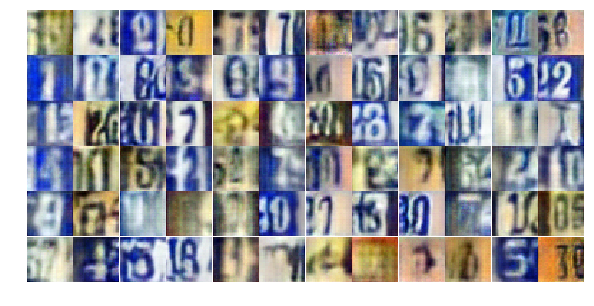

Epoch 9/25... Discriminator Loss: 0.7844... Generator Loss: 1.0519
Epoch 9/25... Discriminator Loss: 0.8922... Generator Loss: 0.9519
Epoch 9/25... Discriminator Loss: 1.1303... Generator Loss: 0.6116
Epoch 9/25... Discriminator Loss: 1.0576... Generator Loss: 1.8801
Epoch 9/25... Discriminator Loss: 0.8373... Generator Loss: 0.9558
Epoch 9/25... Discriminator Loss: 0.9477... Generator Loss: 0.9078
Epoch 9/25... Discriminator Loss: 0.9263... Generator Loss: 1.6505
Epoch 9/25... Discriminator Loss: 0.8656... Generator Loss: 1.3956
Epoch 9/25... Discriminator Loss: 1.1377... Generator Loss: 0.6062
Epoch 9/25... Discriminator Loss: 1.1175... Generator Loss: 0.6683


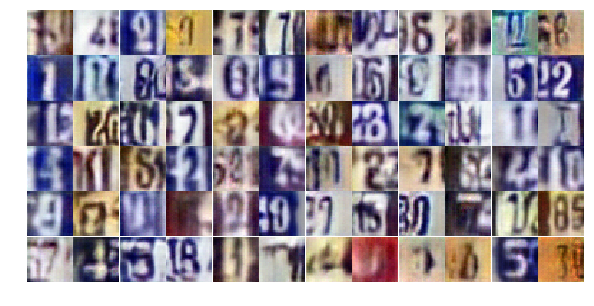

Epoch 9/25... Discriminator Loss: 0.7847... Generator Loss: 1.4722
Epoch 9/25... Discriminator Loss: 1.0278... Generator Loss: 0.8751
Epoch 9/25... Discriminator Loss: 0.6958... Generator Loss: 1.2662
Epoch 9/25... Discriminator Loss: 0.9209... Generator Loss: 0.8796
Epoch 9/25... Discriminator Loss: 0.6750... Generator Loss: 1.4148
Epoch 9/25... Discriminator Loss: 0.9529... Generator Loss: 0.8027
Epoch 9/25... Discriminator Loss: 0.9597... Generator Loss: 0.7767
Epoch 9/25... Discriminator Loss: 0.7363... Generator Loss: 1.0709
Epoch 9/25... Discriminator Loss: 0.9963... Generator Loss: 1.1749
Epoch 9/25... Discriminator Loss: 1.0431... Generator Loss: 1.3675


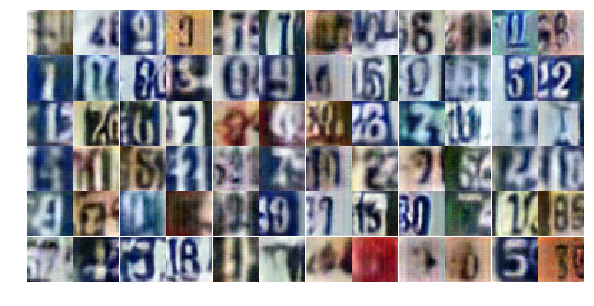

Epoch 9/25... Discriminator Loss: 1.3923... Generator Loss: 3.1463
Epoch 9/25... Discriminator Loss: 1.1783... Generator Loss: 1.2217
Epoch 9/25... Discriminator Loss: 1.1410... Generator Loss: 0.6860
Epoch 9/25... Discriminator Loss: 1.1060... Generator Loss: 0.6229
Epoch 9/25... Discriminator Loss: 0.8713... Generator Loss: 1.2074
Epoch 10/25... Discriminator Loss: 0.9552... Generator Loss: 0.8609
Epoch 10/25... Discriminator Loss: 0.7683... Generator Loss: 1.0616
Epoch 10/25... Discriminator Loss: 1.0196... Generator Loss: 0.7712
Epoch 10/25... Discriminator Loss: 0.9826... Generator Loss: 0.8082
Epoch 10/25... Discriminator Loss: 1.3146... Generator Loss: 0.4587


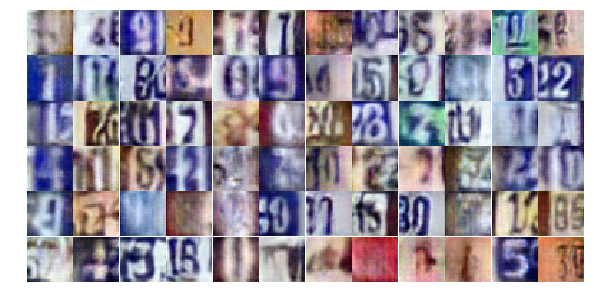

Epoch 10/25... Discriminator Loss: 1.1002... Generator Loss: 0.6713
Epoch 10/25... Discriminator Loss: 0.7137... Generator Loss: 1.0327
Epoch 10/25... Discriminator Loss: 0.7990... Generator Loss: 0.9812
Epoch 10/25... Discriminator Loss: 1.0055... Generator Loss: 0.7316
Epoch 10/25... Discriminator Loss: 0.8068... Generator Loss: 1.2414
Epoch 10/25... Discriminator Loss: 1.0221... Generator Loss: 0.9196
Epoch 10/25... Discriminator Loss: 0.7841... Generator Loss: 1.0166
Epoch 10/25... Discriminator Loss: 0.9450... Generator Loss: 0.7629
Epoch 10/25... Discriminator Loss: 0.8365... Generator Loss: 1.0045
Epoch 10/25... Discriminator Loss: 0.9302... Generator Loss: 0.8088


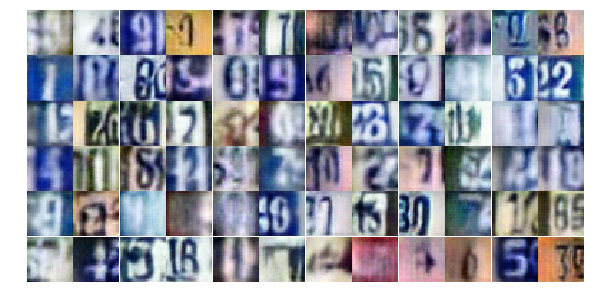

Epoch 10/25... Discriminator Loss: 0.8772... Generator Loss: 1.1068
Epoch 10/25... Discriminator Loss: 1.0668... Generator Loss: 0.6907
Epoch 10/25... Discriminator Loss: 1.0744... Generator Loss: 0.7164
Epoch 10/25... Discriminator Loss: 1.1806... Generator Loss: 0.6115
Epoch 10/25... Discriminator Loss: 0.8822... Generator Loss: 1.1425
Epoch 10/25... Discriminator Loss: 1.0271... Generator Loss: 0.6414
Epoch 10/25... Discriminator Loss: 0.9769... Generator Loss: 0.7729
Epoch 10/25... Discriminator Loss: 0.8021... Generator Loss: 0.9894
Epoch 10/25... Discriminator Loss: 0.9072... Generator Loss: 1.4131
Epoch 10/25... Discriminator Loss: 0.6650... Generator Loss: 1.9718


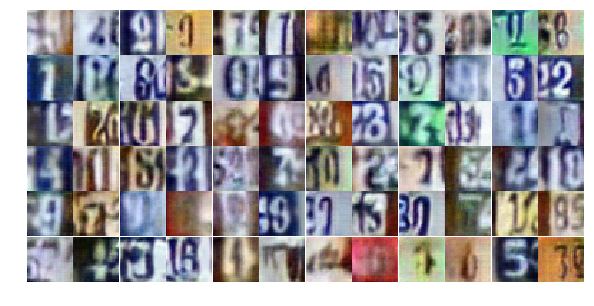

Epoch 10/25... Discriminator Loss: 1.0744... Generator Loss: 0.6187
Epoch 10/25... Discriminator Loss: 1.0947... Generator Loss: 0.5604
Epoch 10/25... Discriminator Loss: 0.7637... Generator Loss: 1.7084
Epoch 10/25... Discriminator Loss: 0.6233... Generator Loss: 1.4745
Epoch 10/25... Discriminator Loss: 1.5401... Generator Loss: 0.3320
Epoch 10/25... Discriminator Loss: 1.1688... Generator Loss: 0.6122
Epoch 10/25... Discriminator Loss: 0.6806... Generator Loss: 1.3692
Epoch 10/25... Discriminator Loss: 0.8414... Generator Loss: 1.1231
Epoch 10/25... Discriminator Loss: 1.0785... Generator Loss: 0.6237
Epoch 10/25... Discriminator Loss: 0.8652... Generator Loss: 0.8767


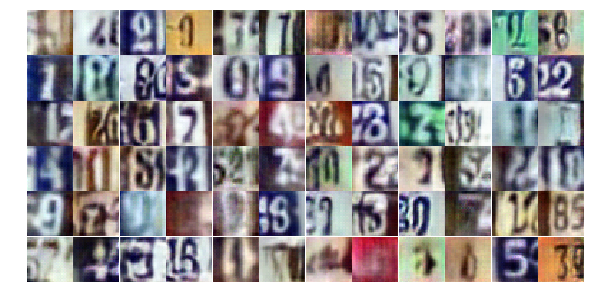

Epoch 10/25... Discriminator Loss: 0.8262... Generator Loss: 1.2367
Epoch 10/25... Discriminator Loss: 0.9767... Generator Loss: 0.6523
Epoch 10/25... Discriminator Loss: 0.9597... Generator Loss: 1.3933
Epoch 10/25... Discriminator Loss: 0.8874... Generator Loss: 0.9288
Epoch 10/25... Discriminator Loss: 0.8970... Generator Loss: 0.8427
Epoch 10/25... Discriminator Loss: 1.4870... Generator Loss: 0.3740
Epoch 10/25... Discriminator Loss: 1.0281... Generator Loss: 0.6655
Epoch 10/25... Discriminator Loss: 0.9677... Generator Loss: 0.7849
Epoch 10/25... Discriminator Loss: 0.9305... Generator Loss: 1.4521
Epoch 10/25... Discriminator Loss: 1.0489... Generator Loss: 0.7337


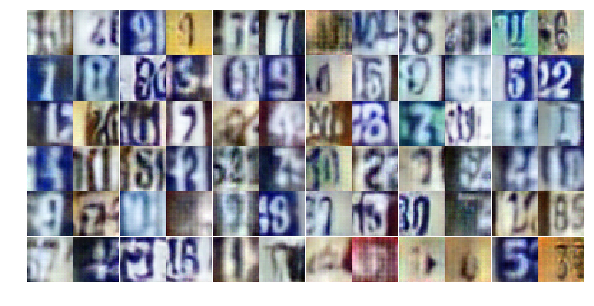

Epoch 10/25... Discriminator Loss: 0.8194... Generator Loss: 0.8853
Epoch 10/25... Discriminator Loss: 0.9873... Generator Loss: 0.7974
Epoch 10/25... Discriminator Loss: 1.0878... Generator Loss: 0.6601
Epoch 10/25... Discriminator Loss: 0.9956... Generator Loss: 0.6742
Epoch 10/25... Discriminator Loss: 0.7476... Generator Loss: 1.3358
Epoch 10/25... Discriminator Loss: 0.9125... Generator Loss: 0.9284
Epoch 10/25... Discriminator Loss: 1.2937... Generator Loss: 0.5436
Epoch 10/25... Discriminator Loss: 0.8794... Generator Loss: 0.9637
Epoch 10/25... Discriminator Loss: 0.9264... Generator Loss: 1.1896
Epoch 10/25... Discriminator Loss: 0.8099... Generator Loss: 1.0359


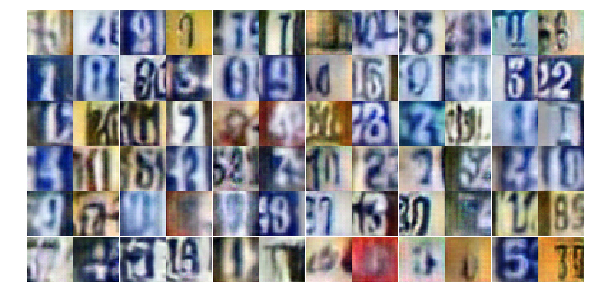

Epoch 10/25... Discriminator Loss: 0.9225... Generator Loss: 1.1006
Epoch 10/25... Discriminator Loss: 0.8942... Generator Loss: 0.9630
Epoch 10/25... Discriminator Loss: 0.6820... Generator Loss: 1.0639
Epoch 11/25... Discriminator Loss: 1.0142... Generator Loss: 0.9317
Epoch 11/25... Discriminator Loss: 0.8145... Generator Loss: 0.9417
Epoch 11/25... Discriminator Loss: 1.1388... Generator Loss: 0.6152
Epoch 11/25... Discriminator Loss: 1.1996... Generator Loss: 0.5543
Epoch 11/25... Discriminator Loss: 0.7662... Generator Loss: 1.2628
Epoch 11/25... Discriminator Loss: 1.2926... Generator Loss: 0.4420
Epoch 11/25... Discriminator Loss: 0.7660... Generator Loss: 1.2029


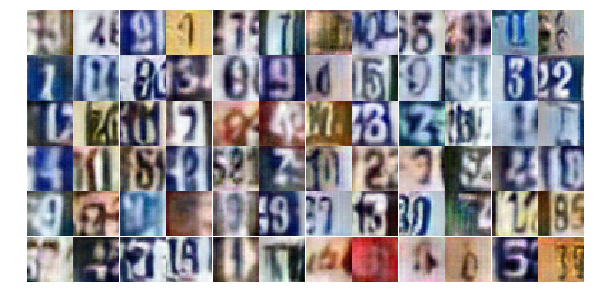

Epoch 11/25... Discriminator Loss: 0.8976... Generator Loss: 1.0172
Epoch 11/25... Discriminator Loss: 1.0963... Generator Loss: 0.6121
Epoch 11/25... Discriminator Loss: 0.6335... Generator Loss: 1.2352
Epoch 11/25... Discriminator Loss: 1.0431... Generator Loss: 0.6869
Epoch 11/25... Discriminator Loss: 0.9264... Generator Loss: 1.0625
Epoch 11/25... Discriminator Loss: 0.9372... Generator Loss: 1.0356
Epoch 11/25... Discriminator Loss: 0.7798... Generator Loss: 1.1573
Epoch 11/25... Discriminator Loss: 0.6470... Generator Loss: 1.2496
Epoch 11/25... Discriminator Loss: 0.9606... Generator Loss: 0.7231
Epoch 11/25... Discriminator Loss: 1.3402... Generator Loss: 0.4164


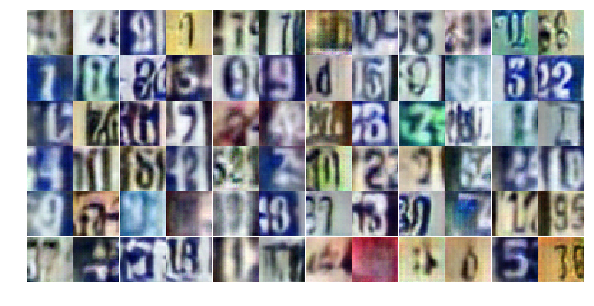

Epoch 11/25... Discriminator Loss: 0.7602... Generator Loss: 1.1401
Epoch 11/25... Discriminator Loss: 0.8346... Generator Loss: 1.1730
Epoch 11/25... Discriminator Loss: 1.2082... Generator Loss: 0.5302
Epoch 11/25... Discriminator Loss: 0.9077... Generator Loss: 0.9441
Epoch 11/25... Discriminator Loss: 0.4887... Generator Loss: 1.8606
Epoch 11/25... Discriminator Loss: 0.6381... Generator Loss: 1.4318
Epoch 11/25... Discriminator Loss: 0.9638... Generator Loss: 0.6942
Epoch 11/25... Discriminator Loss: 0.9378... Generator Loss: 0.8968
Epoch 11/25... Discriminator Loss: 0.7111... Generator Loss: 1.4364
Epoch 11/25... Discriminator Loss: 1.2774... Generator Loss: 0.4400


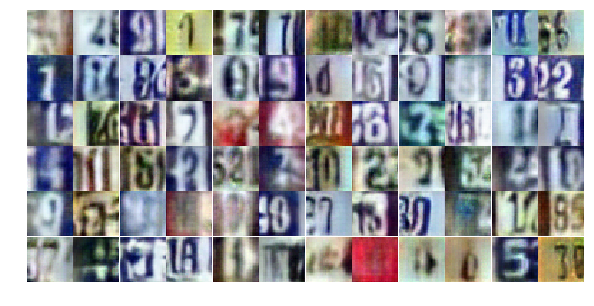

Epoch 11/25... Discriminator Loss: 0.7431... Generator Loss: 1.2428
Epoch 11/25... Discriminator Loss: 1.0057... Generator Loss: 0.6686
Epoch 11/25... Discriminator Loss: 0.8787... Generator Loss: 1.1037
Epoch 11/25... Discriminator Loss: 0.8128... Generator Loss: 1.4583
Epoch 11/25... Discriminator Loss: 1.2260... Generator Loss: 0.5480
Epoch 11/25... Discriminator Loss: 0.8649... Generator Loss: 0.9273
Epoch 11/25... Discriminator Loss: 1.1987... Generator Loss: 0.5401
Epoch 11/25... Discriminator Loss: 0.9445... Generator Loss: 0.7436
Epoch 11/25... Discriminator Loss: 0.9119... Generator Loss: 1.0514
Epoch 11/25... Discriminator Loss: 1.1653... Generator Loss: 0.5648


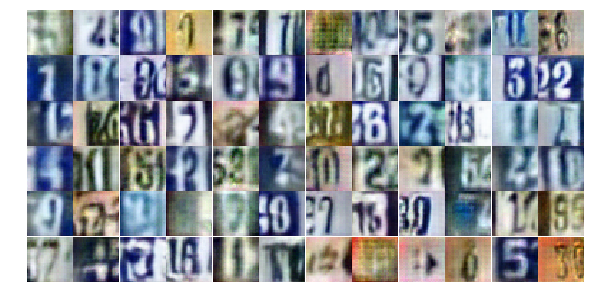

Epoch 11/25... Discriminator Loss: 0.8049... Generator Loss: 1.1524
Epoch 11/25... Discriminator Loss: 0.8346... Generator Loss: 0.8598
Epoch 11/25... Discriminator Loss: 0.8144... Generator Loss: 1.1284
Epoch 11/25... Discriminator Loss: 1.0016... Generator Loss: 0.7946
Epoch 11/25... Discriminator Loss: 1.1248... Generator Loss: 0.5806
Epoch 11/25... Discriminator Loss: 0.6527... Generator Loss: 1.2876
Epoch 11/25... Discriminator Loss: 1.6270... Generator Loss: 0.3381
Epoch 11/25... Discriminator Loss: 1.0527... Generator Loss: 0.7922
Epoch 11/25... Discriminator Loss: 1.1992... Generator Loss: 0.5514
Epoch 11/25... Discriminator Loss: 0.9980... Generator Loss: 0.7371


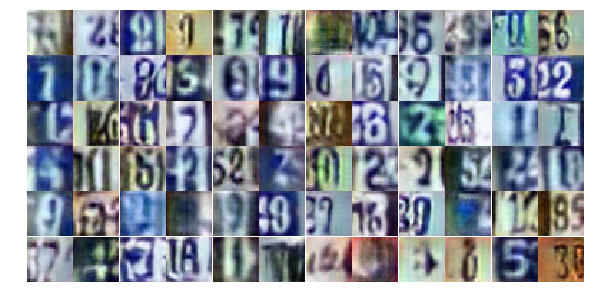

Epoch 11/25... Discriminator Loss: 1.0379... Generator Loss: 0.6983
Epoch 11/25... Discriminator Loss: 0.7845... Generator Loss: 1.2200
Epoch 11/25... Discriminator Loss: 0.7874... Generator Loss: 1.1343
Epoch 11/25... Discriminator Loss: 0.8293... Generator Loss: 0.8358
Epoch 11/25... Discriminator Loss: 0.9919... Generator Loss: 0.6694
Epoch 11/25... Discriminator Loss: 0.9291... Generator Loss: 1.1510
Epoch 11/25... Discriminator Loss: 0.9100... Generator Loss: 0.8052
Epoch 11/25... Discriminator Loss: 0.7981... Generator Loss: 1.0841
Epoch 11/25... Discriminator Loss: 1.0224... Generator Loss: 1.6325
Epoch 11/25... Discriminator Loss: 0.8803... Generator Loss: 0.9992


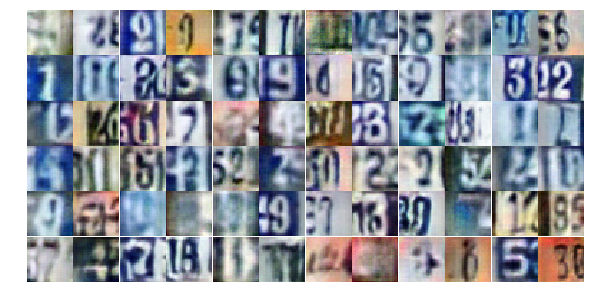

Epoch 12/25... Discriminator Loss: 0.9339... Generator Loss: 0.9179
Epoch 12/25... Discriminator Loss: 0.8502... Generator Loss: 1.2648
Epoch 12/25... Discriminator Loss: 0.7837... Generator Loss: 1.1224
Epoch 12/25... Discriminator Loss: 0.7748... Generator Loss: 1.2002
Epoch 12/25... Discriminator Loss: 0.7343... Generator Loss: 1.1972
Epoch 12/25... Discriminator Loss: 0.8046... Generator Loss: 0.9862
Epoch 12/25... Discriminator Loss: 0.8218... Generator Loss: 1.0197
Epoch 12/25... Discriminator Loss: 0.6974... Generator Loss: 1.0910
Epoch 12/25... Discriminator Loss: 1.3312... Generator Loss: 0.4996
Epoch 12/25... Discriminator Loss: 0.8006... Generator Loss: 0.9887


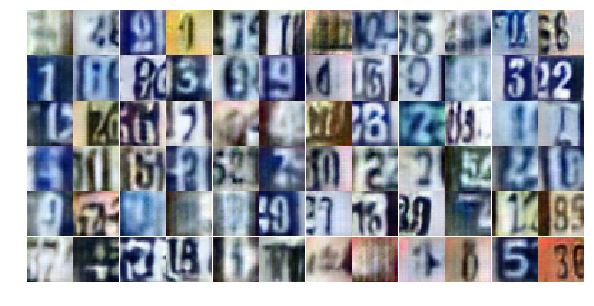

Epoch 12/25... Discriminator Loss: 0.7545... Generator Loss: 1.1178
Epoch 12/25... Discriminator Loss: 0.9019... Generator Loss: 0.9674
Epoch 12/25... Discriminator Loss: 0.8902... Generator Loss: 1.9610
Epoch 12/25... Discriminator Loss: 1.0019... Generator Loss: 0.7864
Epoch 12/25... Discriminator Loss: 0.7410... Generator Loss: 1.2184
Epoch 12/25... Discriminator Loss: 0.9330... Generator Loss: 0.9679
Epoch 12/25... Discriminator Loss: 1.3473... Generator Loss: 0.4671
Epoch 12/25... Discriminator Loss: 0.8850... Generator Loss: 0.8720
Epoch 12/25... Discriminator Loss: 0.6224... Generator Loss: 1.4818
Epoch 12/25... Discriminator Loss: 1.1176... Generator Loss: 0.6079


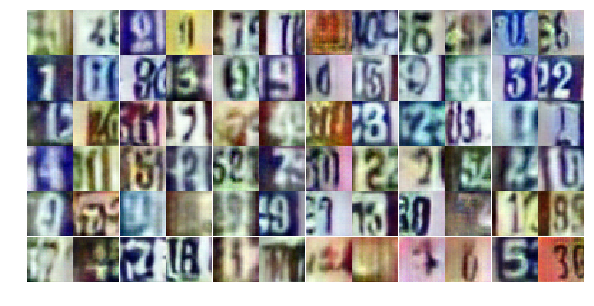

Epoch 12/25... Discriminator Loss: 0.7769... Generator Loss: 1.7874
Epoch 12/25... Discriminator Loss: 0.8711... Generator Loss: 1.7986
Epoch 12/25... Discriminator Loss: 1.0326... Generator Loss: 0.6653
Epoch 12/25... Discriminator Loss: 0.8022... Generator Loss: 1.4324
Epoch 12/25... Discriminator Loss: 0.6767... Generator Loss: 1.2351
Epoch 12/25... Discriminator Loss: 0.7040... Generator Loss: 1.4553
Epoch 12/25... Discriminator Loss: 0.9468... Generator Loss: 0.7353
Epoch 12/25... Discriminator Loss: 0.6600... Generator Loss: 1.3172
Epoch 12/25... Discriminator Loss: 0.5900... Generator Loss: 1.2905
Epoch 12/25... Discriminator Loss: 0.9595... Generator Loss: 0.7292


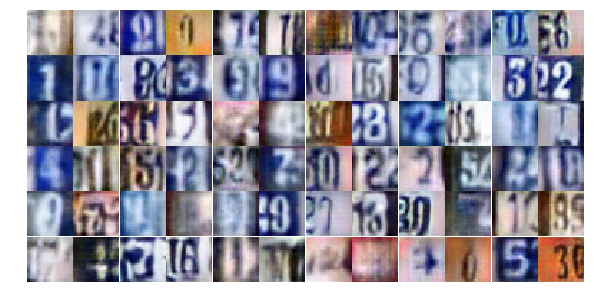

Epoch 12/25... Discriminator Loss: 0.8413... Generator Loss: 1.1608
Epoch 12/25... Discriminator Loss: 0.9316... Generator Loss: 0.8788
Epoch 12/25... Discriminator Loss: 0.9771... Generator Loss: 0.7760
Epoch 12/25... Discriminator Loss: 1.1016... Generator Loss: 0.5966
Epoch 12/25... Discriminator Loss: 1.0815... Generator Loss: 2.3353
Epoch 12/25... Discriminator Loss: 0.9615... Generator Loss: 0.8004
Epoch 12/25... Discriminator Loss: 1.1886... Generator Loss: 0.5604
Epoch 12/25... Discriminator Loss: 0.8162... Generator Loss: 1.1749
Epoch 12/25... Discriminator Loss: 0.8661... Generator Loss: 0.8911
Epoch 12/25... Discriminator Loss: 0.6054... Generator Loss: 1.3107


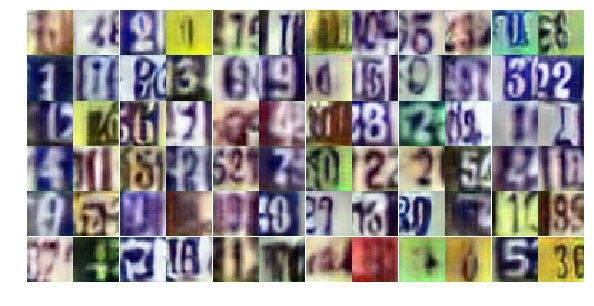

Epoch 12/25... Discriminator Loss: 0.9233... Generator Loss: 0.9212
Epoch 12/25... Discriminator Loss: 0.6324... Generator Loss: 1.9751
Epoch 12/25... Discriminator Loss: 0.9105... Generator Loss: 1.8812
Epoch 12/25... Discriminator Loss: 0.7871... Generator Loss: 1.1740
Epoch 12/25... Discriminator Loss: 0.8099... Generator Loss: 1.0863
Epoch 12/25... Discriminator Loss: 0.9281... Generator Loss: 1.0543
Epoch 12/25... Discriminator Loss: 1.3907... Generator Loss: 0.3935
Epoch 12/25... Discriminator Loss: 1.0335... Generator Loss: 0.6522
Epoch 12/25... Discriminator Loss: 0.7451... Generator Loss: 1.0864
Epoch 12/25... Discriminator Loss: 0.9193... Generator Loss: 0.7532


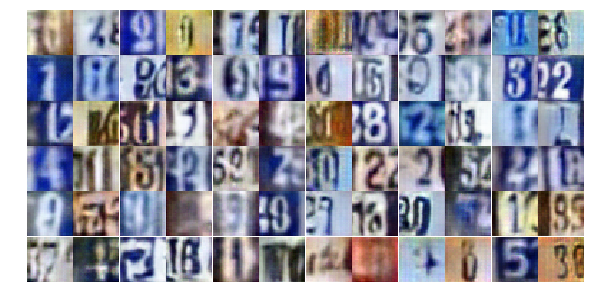

Epoch 12/25... Discriminator Loss: 1.1009... Generator Loss: 0.6350
Epoch 12/25... Discriminator Loss: 0.8510... Generator Loss: 0.9719
Epoch 12/25... Discriminator Loss: 0.8612... Generator Loss: 0.9093
Epoch 12/25... Discriminator Loss: 1.2464... Generator Loss: 0.5086
Epoch 12/25... Discriminator Loss: 0.9178... Generator Loss: 0.8042
Epoch 12/25... Discriminator Loss: 0.9711... Generator Loss: 1.1416
Epoch 12/25... Discriminator Loss: 0.7620... Generator Loss: 1.0205
Epoch 13/25... Discriminator Loss: 0.9262... Generator Loss: 0.7356
Epoch 13/25... Discriminator Loss: 0.6157... Generator Loss: 1.5780
Epoch 13/25... Discriminator Loss: 0.9280... Generator Loss: 1.0047


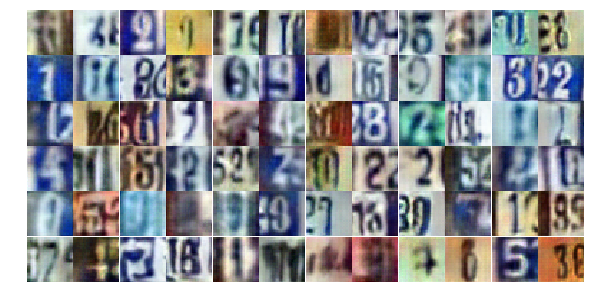

Epoch 13/25... Discriminator Loss: 0.7403... Generator Loss: 1.3395
Epoch 13/25... Discriminator Loss: 0.8740... Generator Loss: 1.0271
Epoch 13/25... Discriminator Loss: 0.8630... Generator Loss: 1.4442
Epoch 13/25... Discriminator Loss: 1.0864... Generator Loss: 0.6473
Epoch 13/25... Discriminator Loss: 0.8664... Generator Loss: 0.9174
Epoch 13/25... Discriminator Loss: 0.8333... Generator Loss: 0.9174
Epoch 13/25... Discriminator Loss: 0.7575... Generator Loss: 1.1139
Epoch 13/25... Discriminator Loss: 0.8972... Generator Loss: 0.7761
Epoch 13/25... Discriminator Loss: 1.0704... Generator Loss: 0.6324
Epoch 13/25... Discriminator Loss: 0.7962... Generator Loss: 1.1124


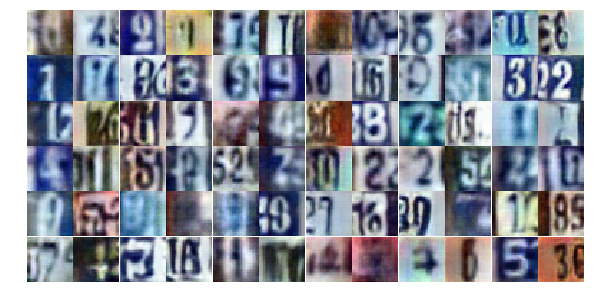

Epoch 13/25... Discriminator Loss: 0.8522... Generator Loss: 0.9799
Epoch 13/25... Discriminator Loss: 0.7981... Generator Loss: 0.8471
Epoch 13/25... Discriminator Loss: 0.9770... Generator Loss: 0.7412
Epoch 13/25... Discriminator Loss: 0.8938... Generator Loss: 1.3750
Epoch 13/25... Discriminator Loss: 0.6577... Generator Loss: 1.5587
Epoch 13/25... Discriminator Loss: 1.2112... Generator Loss: 0.5974
Epoch 13/25... Discriminator Loss: 0.9171... Generator Loss: 1.0046
Epoch 13/25... Discriminator Loss: 1.0624... Generator Loss: 0.8124
Epoch 13/25... Discriminator Loss: 0.7737... Generator Loss: 1.7463
Epoch 13/25... Discriminator Loss: 0.8366... Generator Loss: 0.8731


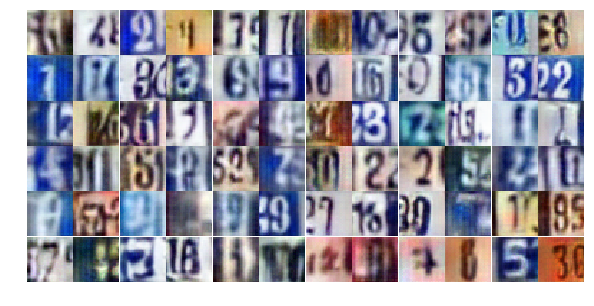

Epoch 13/25... Discriminator Loss: 0.9529... Generator Loss: 1.1274
Epoch 13/25... Discriminator Loss: 1.0626... Generator Loss: 0.6088
Epoch 13/25... Discriminator Loss: 0.7265... Generator Loss: 1.4296
Epoch 13/25... Discriminator Loss: 0.7660... Generator Loss: 1.0096
Epoch 13/25... Discriminator Loss: 0.9164... Generator Loss: 0.7823
Epoch 13/25... Discriminator Loss: 0.9637... Generator Loss: 0.7482
Epoch 13/25... Discriminator Loss: 0.8906... Generator Loss: 1.0138
Epoch 13/25... Discriminator Loss: 0.7566... Generator Loss: 1.1832
Epoch 13/25... Discriminator Loss: 0.9061... Generator Loss: 0.8462
Epoch 13/25... Discriminator Loss: 0.8276... Generator Loss: 0.9058


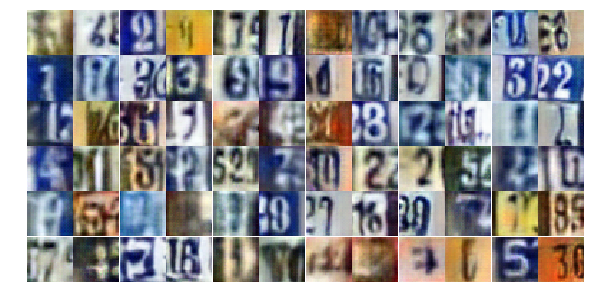

Epoch 13/25... Discriminator Loss: 1.4216... Generator Loss: 0.4016
Epoch 13/25... Discriminator Loss: 1.1429... Generator Loss: 2.0695
Epoch 13/25... Discriminator Loss: 0.9751... Generator Loss: 0.7306
Epoch 13/25... Discriminator Loss: 1.0702... Generator Loss: 0.9015
Epoch 13/25... Discriminator Loss: 0.8804... Generator Loss: 1.0777
Epoch 13/25... Discriminator Loss: 0.6338... Generator Loss: 1.3583
Epoch 13/25... Discriminator Loss: 0.6806... Generator Loss: 2.0167
Epoch 13/25... Discriminator Loss: 1.1848... Generator Loss: 0.5440
Epoch 13/25... Discriminator Loss: 0.7813... Generator Loss: 1.2614
Epoch 13/25... Discriminator Loss: 0.8363... Generator Loss: 1.2128


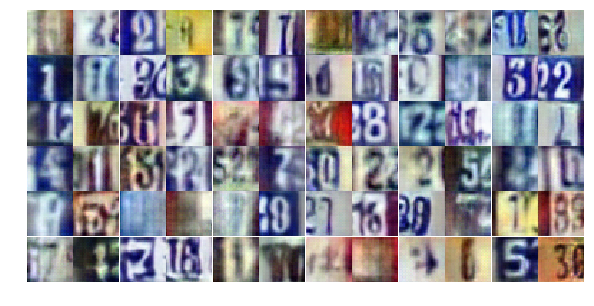

Epoch 13/25... Discriminator Loss: 0.7272... Generator Loss: 1.8601
Epoch 13/25... Discriminator Loss: 1.0723... Generator Loss: 0.5996
Epoch 13/25... Discriminator Loss: 0.7487... Generator Loss: 1.1963
Epoch 13/25... Discriminator Loss: 0.9262... Generator Loss: 0.8493
Epoch 13/25... Discriminator Loss: 1.0462... Generator Loss: 0.7381
Epoch 13/25... Discriminator Loss: 0.8697... Generator Loss: 0.8752
Epoch 13/25... Discriminator Loss: 0.8342... Generator Loss: 0.8755
Epoch 13/25... Discriminator Loss: 0.7931... Generator Loss: 1.1082
Epoch 13/25... Discriminator Loss: 0.8966... Generator Loss: 0.8261
Epoch 13/25... Discriminator Loss: 1.0713... Generator Loss: 0.7371


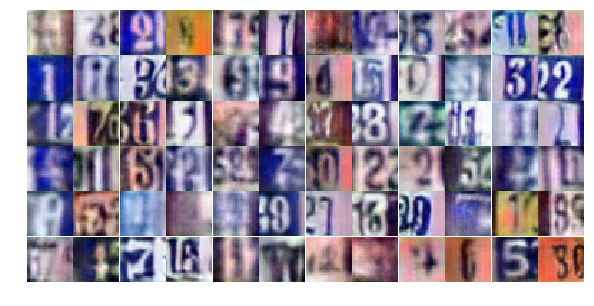

Epoch 13/25... Discriminator Loss: 0.6598... Generator Loss: 1.6577
Epoch 13/25... Discriminator Loss: 1.0480... Generator Loss: 0.5867
Epoch 13/25... Discriminator Loss: 0.8031... Generator Loss: 1.0964
Epoch 13/25... Discriminator Loss: 1.0502... Generator Loss: 0.6088
Epoch 14/25... Discriminator Loss: 1.0746... Generator Loss: 0.6436
Epoch 14/25... Discriminator Loss: 0.9420... Generator Loss: 0.8134
Epoch 14/25... Discriminator Loss: 0.9697... Generator Loss: 0.9034
Epoch 14/25... Discriminator Loss: 0.7849... Generator Loss: 1.8630
Epoch 14/25... Discriminator Loss: 0.8118... Generator Loss: 1.2637
Epoch 14/25... Discriminator Loss: 0.6919... Generator Loss: 1.0744


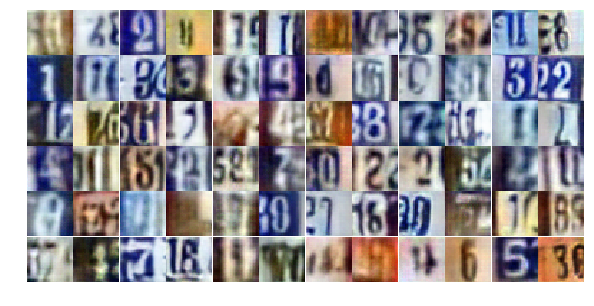

Epoch 14/25... Discriminator Loss: 1.0206... Generator Loss: 1.2008
Epoch 14/25... Discriminator Loss: 1.1087... Generator Loss: 0.5335
Epoch 14/25... Discriminator Loss: 1.1533... Generator Loss: 0.5537
Epoch 14/25... Discriminator Loss: 0.8886... Generator Loss: 0.7907
Epoch 14/25... Discriminator Loss: 1.0563... Generator Loss: 0.5812
Epoch 14/25... Discriminator Loss: 0.5907... Generator Loss: 1.7702
Epoch 14/25... Discriminator Loss: 0.7181... Generator Loss: 1.4146
Epoch 14/25... Discriminator Loss: 1.1711... Generator Loss: 0.5162
Epoch 14/25... Discriminator Loss: 1.0995... Generator Loss: 0.5894
Epoch 14/25... Discriminator Loss: 1.3067... Generator Loss: 0.4575


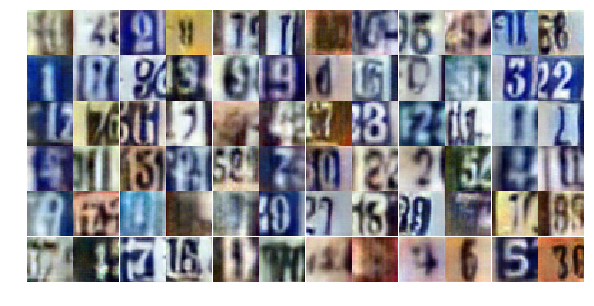

Epoch 14/25... Discriminator Loss: 0.6230... Generator Loss: 1.1266
Epoch 14/25... Discriminator Loss: 0.8243... Generator Loss: 1.8555
Epoch 14/25... Discriminator Loss: 1.0392... Generator Loss: 0.9990
Epoch 14/25... Discriminator Loss: 0.7849... Generator Loss: 0.9829
Epoch 14/25... Discriminator Loss: 1.0163... Generator Loss: 0.8983
Epoch 14/25... Discriminator Loss: 0.9345... Generator Loss: 0.8487
Epoch 14/25... Discriminator Loss: 0.9205... Generator Loss: 0.7206
Epoch 14/25... Discriminator Loss: 0.9745... Generator Loss: 0.7811
Epoch 14/25... Discriminator Loss: 0.7207... Generator Loss: 1.1735
Epoch 14/25... Discriminator Loss: 0.6059... Generator Loss: 1.3622


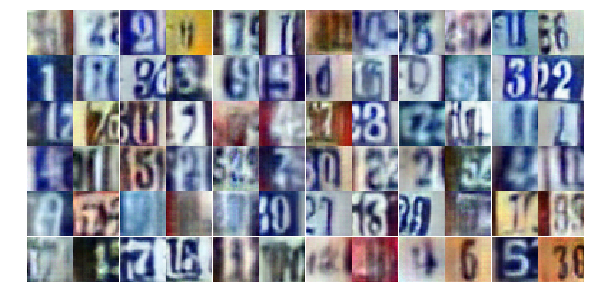

Epoch 14/25... Discriminator Loss: 1.0033... Generator Loss: 0.6439
Epoch 14/25... Discriminator Loss: 0.5913... Generator Loss: 1.8201
Epoch 14/25... Discriminator Loss: 0.6840... Generator Loss: 1.0643
Epoch 14/25... Discriminator Loss: 0.7953... Generator Loss: 1.3804
Epoch 14/25... Discriminator Loss: 1.0160... Generator Loss: 2.2713
Epoch 14/25... Discriminator Loss: 0.7967... Generator Loss: 1.0318
Epoch 14/25... Discriminator Loss: 0.8439... Generator Loss: 1.1287
Epoch 14/25... Discriminator Loss: 0.5807... Generator Loss: 1.4107
Epoch 14/25... Discriminator Loss: 0.6211... Generator Loss: 1.3968
Epoch 14/25... Discriminator Loss: 0.9075... Generator Loss: 1.0148


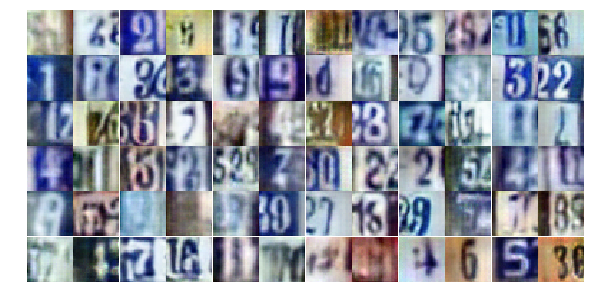

Epoch 14/25... Discriminator Loss: 1.0753... Generator Loss: 0.6241
Epoch 14/25... Discriminator Loss: 0.9040... Generator Loss: 1.8669
Epoch 14/25... Discriminator Loss: 1.3990... Generator Loss: 0.3927
Epoch 14/25... Discriminator Loss: 1.0664... Generator Loss: 0.6445
Epoch 14/25... Discriminator Loss: 0.8161... Generator Loss: 0.9565
Epoch 14/25... Discriminator Loss: 0.8913... Generator Loss: 1.2611
Epoch 14/25... Discriminator Loss: 0.9021... Generator Loss: 1.1475
Epoch 14/25... Discriminator Loss: 0.8024... Generator Loss: 0.8729
Epoch 14/25... Discriminator Loss: 1.7900... Generator Loss: 0.2797
Epoch 14/25... Discriminator Loss: 0.9765... Generator Loss: 0.7802


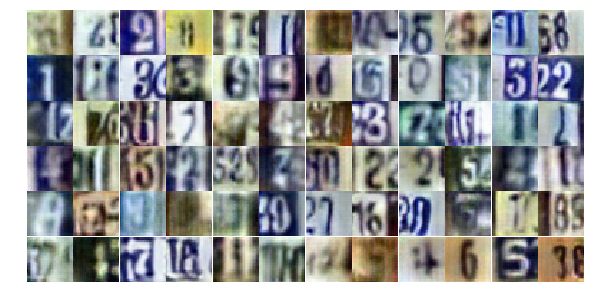

Epoch 14/25... Discriminator Loss: 0.9280... Generator Loss: 0.8836
Epoch 14/25... Discriminator Loss: 1.1509... Generator Loss: 0.5819
Epoch 14/25... Discriminator Loss: 0.9006... Generator Loss: 1.5545
Epoch 14/25... Discriminator Loss: 1.2011... Generator Loss: 0.5131
Epoch 14/25... Discriminator Loss: 0.8848... Generator Loss: 1.0849
Epoch 14/25... Discriminator Loss: 1.0262... Generator Loss: 1.1584
Epoch 14/25... Discriminator Loss: 0.9059... Generator Loss: 0.9695
Epoch 14/25... Discriminator Loss: 0.9231... Generator Loss: 0.9818
Epoch 14/25... Discriminator Loss: 1.2009... Generator Loss: 0.5083
Epoch 14/25... Discriminator Loss: 1.1143... Generator Loss: 0.6354


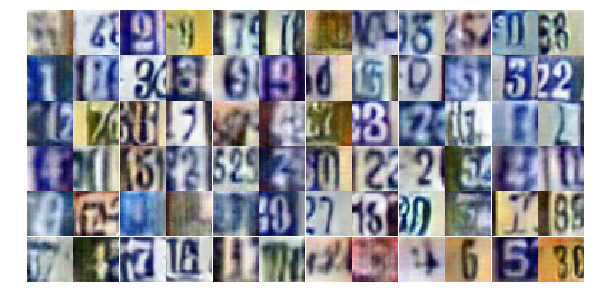

Epoch 14/25... Discriminator Loss: 1.2450... Generator Loss: 0.5506
Epoch 14/25... Discriminator Loss: 1.1313... Generator Loss: 0.5788
Epoch 15/25... Discriminator Loss: 0.9980... Generator Loss: 0.7731
Epoch 15/25... Discriminator Loss: 0.8359... Generator Loss: 0.9127
Epoch 15/25... Discriminator Loss: 0.8783... Generator Loss: 0.8355
Epoch 15/25... Discriminator Loss: 0.9093... Generator Loss: 0.8178
Epoch 15/25... Discriminator Loss: 0.9678... Generator Loss: 0.6567
Epoch 15/25... Discriminator Loss: 0.9441... Generator Loss: 0.7844
Epoch 15/25... Discriminator Loss: 0.8492... Generator Loss: 1.2195
Epoch 15/25... Discriminator Loss: 0.7250... Generator Loss: 1.0547


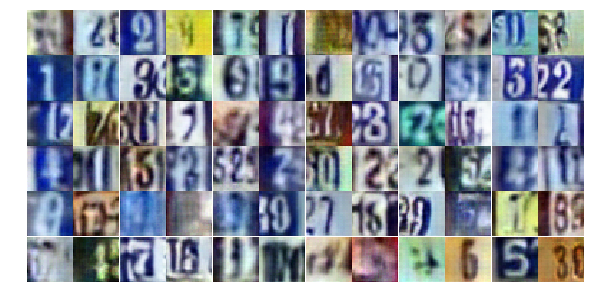

Epoch 15/25... Discriminator Loss: 0.9498... Generator Loss: 0.7614
Epoch 15/25... Discriminator Loss: 0.9944... Generator Loss: 0.7164
Epoch 15/25... Discriminator Loss: 0.7316... Generator Loss: 1.1344
Epoch 15/25... Discriminator Loss: 0.8786... Generator Loss: 0.8768
Epoch 15/25... Discriminator Loss: 0.9186... Generator Loss: 0.7635
Epoch 15/25... Discriminator Loss: 0.7433... Generator Loss: 0.9990
Epoch 15/25... Discriminator Loss: 0.9071... Generator Loss: 1.3928
Epoch 15/25... Discriminator Loss: 0.8877... Generator Loss: 1.4221
Epoch 15/25... Discriminator Loss: 0.9237... Generator Loss: 2.4145
Epoch 15/25... Discriminator Loss: 1.0766... Generator Loss: 0.5791


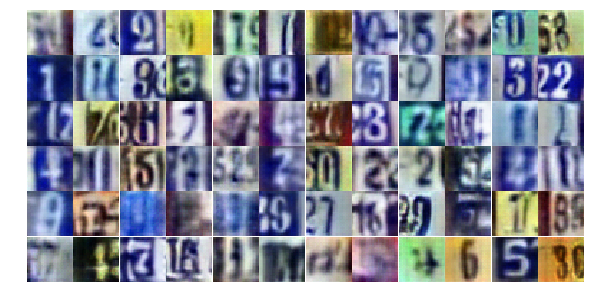

Epoch 15/25... Discriminator Loss: 0.7934... Generator Loss: 1.1442
Epoch 15/25... Discriminator Loss: 0.8123... Generator Loss: 0.9776
Epoch 15/25... Discriminator Loss: 0.7443... Generator Loss: 1.3801
Epoch 15/25... Discriminator Loss: 1.1008... Generator Loss: 0.5987
Epoch 15/25... Discriminator Loss: 0.9594... Generator Loss: 1.7012
Epoch 15/25... Discriminator Loss: 1.0627... Generator Loss: 0.6478
Epoch 15/25... Discriminator Loss: 1.4101... Generator Loss: 0.4087
Epoch 15/25... Discriminator Loss: 0.9675... Generator Loss: 0.7479
Epoch 15/25... Discriminator Loss: 0.6223... Generator Loss: 1.2320
Epoch 15/25... Discriminator Loss: 1.5450... Generator Loss: 0.3322


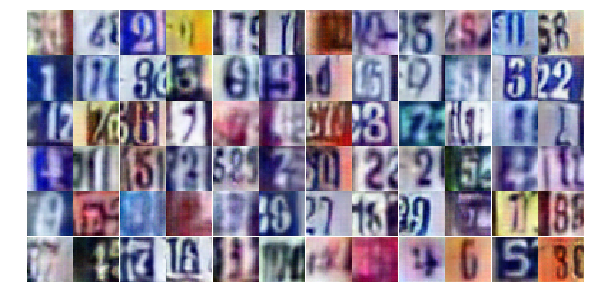

Epoch 15/25... Discriminator Loss: 0.6735... Generator Loss: 0.9967
Epoch 15/25... Discriminator Loss: 0.8195... Generator Loss: 0.9548
Epoch 15/25... Discriminator Loss: 0.5863... Generator Loss: 1.3456
Epoch 15/25... Discriminator Loss: 0.7200... Generator Loss: 1.3752
Epoch 15/25... Discriminator Loss: 0.7749... Generator Loss: 1.0622
Epoch 15/25... Discriminator Loss: 0.7135... Generator Loss: 1.3582
Epoch 15/25... Discriminator Loss: 0.9909... Generator Loss: 0.7639
Epoch 15/25... Discriminator Loss: 0.9225... Generator Loss: 1.0647
Epoch 15/25... Discriminator Loss: 0.8064... Generator Loss: 1.1785
Epoch 15/25... Discriminator Loss: 0.9722... Generator Loss: 0.7842


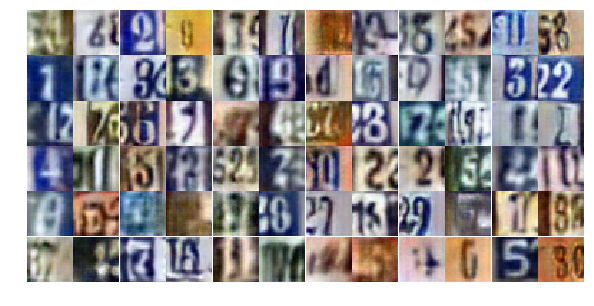

Epoch 15/25... Discriminator Loss: 0.8351... Generator Loss: 0.8524
Epoch 15/25... Discriminator Loss: 1.5957... Generator Loss: 0.3137
Epoch 15/25... Discriminator Loss: 0.7703... Generator Loss: 1.1298
Epoch 15/25... Discriminator Loss: 0.7066... Generator Loss: 1.3863
Epoch 15/25... Discriminator Loss: 1.0883... Generator Loss: 0.5604
Epoch 15/25... Discriminator Loss: 1.9328... Generator Loss: 0.2138
Epoch 15/25... Discriminator Loss: 0.4484... Generator Loss: 1.6680
Epoch 15/25... Discriminator Loss: 0.8533... Generator Loss: 1.7534
Epoch 15/25... Discriminator Loss: 0.9641... Generator Loss: 0.8381
Epoch 15/25... Discriminator Loss: 0.9387... Generator Loss: 0.7755


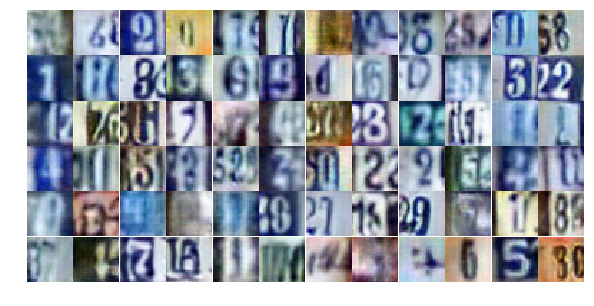

Epoch 15/25... Discriminator Loss: 0.9738... Generator Loss: 0.8173
Epoch 15/25... Discriminator Loss: 0.9650... Generator Loss: 0.7842
Epoch 15/25... Discriminator Loss: 0.7667... Generator Loss: 1.1319
Epoch 15/25... Discriminator Loss: 0.7931... Generator Loss: 1.3440
Epoch 15/25... Discriminator Loss: 0.8344... Generator Loss: 0.8580
Epoch 15/25... Discriminator Loss: 0.9665... Generator Loss: 0.8319
Epoch 15/25... Discriminator Loss: 0.9068... Generator Loss: 0.7186
Epoch 15/25... Discriminator Loss: 0.9750... Generator Loss: 0.7115
Epoch 15/25... Discriminator Loss: 1.4275... Generator Loss: 0.4979
Epoch 16/25... Discriminator Loss: 1.0264... Generator Loss: 0.6815


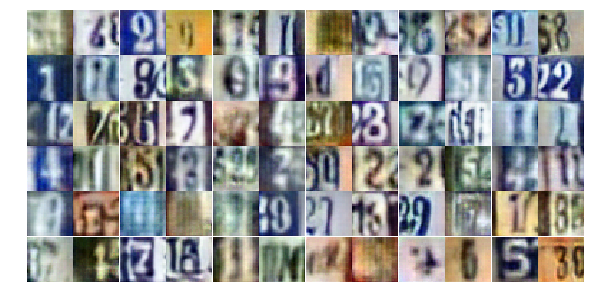

Epoch 16/25... Discriminator Loss: 0.7562... Generator Loss: 0.9738
Epoch 16/25... Discriminator Loss: 0.8938... Generator Loss: 0.8147
Epoch 16/25... Discriminator Loss: 1.1714... Generator Loss: 0.5439
Epoch 16/25... Discriminator Loss: 0.9263... Generator Loss: 0.7790
Epoch 16/25... Discriminator Loss: 0.8232... Generator Loss: 1.0587
Epoch 16/25... Discriminator Loss: 0.7448... Generator Loss: 1.0574
Epoch 16/25... Discriminator Loss: 1.1162... Generator Loss: 0.6040
Epoch 16/25... Discriminator Loss: 0.9361... Generator Loss: 0.8219
Epoch 16/25... Discriminator Loss: 0.7696... Generator Loss: 0.9042
Epoch 16/25... Discriminator Loss: 0.7128... Generator Loss: 1.5470


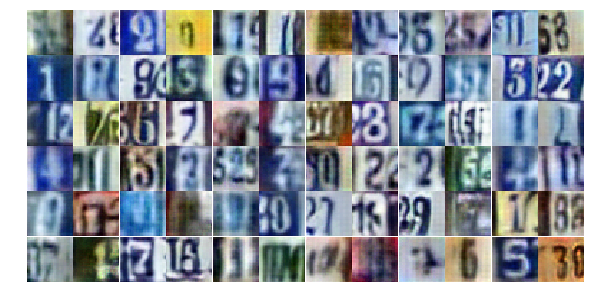

Epoch 16/25... Discriminator Loss: 1.0457... Generator Loss: 0.6680
Epoch 16/25... Discriminator Loss: 0.6908... Generator Loss: 1.0208
Epoch 16/25... Discriminator Loss: 0.8612... Generator Loss: 0.8782
Epoch 16/25... Discriminator Loss: 1.5376... Generator Loss: 0.3497
Epoch 16/25... Discriminator Loss: 0.6537... Generator Loss: 1.4156
Epoch 16/25... Discriminator Loss: 0.7923... Generator Loss: 0.9318
Epoch 16/25... Discriminator Loss: 0.7872... Generator Loss: 0.9010
Epoch 16/25... Discriminator Loss: 0.7010... Generator Loss: 1.5197
Epoch 16/25... Discriminator Loss: 0.7284... Generator Loss: 0.9410
Epoch 16/25... Discriminator Loss: 0.7024... Generator Loss: 1.4970


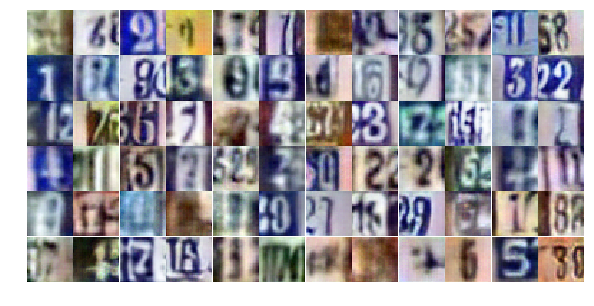

Epoch 16/25... Discriminator Loss: 0.8148... Generator Loss: 0.8994
Epoch 16/25... Discriminator Loss: 0.8406... Generator Loss: 0.8188
Epoch 16/25... Discriminator Loss: 0.8598... Generator Loss: 0.8236
Epoch 16/25... Discriminator Loss: 0.9784... Generator Loss: 0.6722
Epoch 16/25... Discriminator Loss: 0.8387... Generator Loss: 0.9343
Epoch 16/25... Discriminator Loss: 0.9517... Generator Loss: 0.8459
Epoch 16/25... Discriminator Loss: 0.6857... Generator Loss: 1.3393
Epoch 16/25... Discriminator Loss: 0.5122... Generator Loss: 1.6252
Epoch 16/25... Discriminator Loss: 0.9160... Generator Loss: 0.7997
Epoch 16/25... Discriminator Loss: 0.8564... Generator Loss: 0.7750


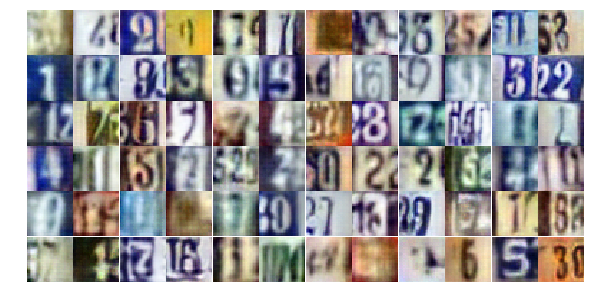

Epoch 16/25... Discriminator Loss: 0.7808... Generator Loss: 0.9088
Epoch 16/25... Discriminator Loss: 0.8463... Generator Loss: 0.9972
Epoch 16/25... Discriminator Loss: 0.8209... Generator Loss: 2.0349
Epoch 16/25... Discriminator Loss: 0.7661... Generator Loss: 0.9180
Epoch 16/25... Discriminator Loss: 1.0552... Generator Loss: 1.8339
Epoch 16/25... Discriminator Loss: 0.9596... Generator Loss: 1.7753
Epoch 16/25... Discriminator Loss: 1.1490... Generator Loss: 0.6768
Epoch 16/25... Discriminator Loss: 0.9702... Generator Loss: 0.6603
Epoch 16/25... Discriminator Loss: 1.0381... Generator Loss: 0.6232
Epoch 16/25... Discriminator Loss: 0.6779... Generator Loss: 1.2100


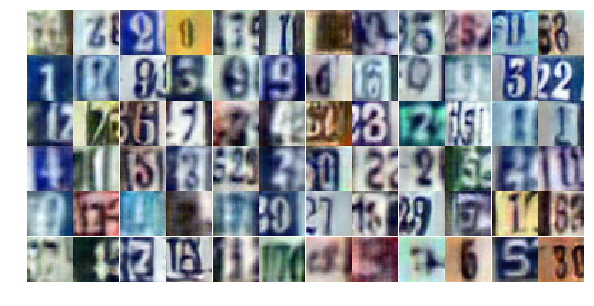

Epoch 16/25... Discriminator Loss: 0.6340... Generator Loss: 1.2770
Epoch 16/25... Discriminator Loss: 1.0812... Generator Loss: 0.6046
Epoch 16/25... Discriminator Loss: 1.5242... Generator Loss: 0.3363
Epoch 16/25... Discriminator Loss: 0.9355... Generator Loss: 0.7670
Epoch 16/25... Discriminator Loss: 0.8692... Generator Loss: 0.9654
Epoch 16/25... Discriminator Loss: 0.8973... Generator Loss: 0.8983
Epoch 16/25... Discriminator Loss: 0.8231... Generator Loss: 1.6918
Epoch 16/25... Discriminator Loss: 1.0566... Generator Loss: 0.6131
Epoch 16/25... Discriminator Loss: 0.7523... Generator Loss: 1.1188
Epoch 16/25... Discriminator Loss: 0.6757... Generator Loss: 1.1558


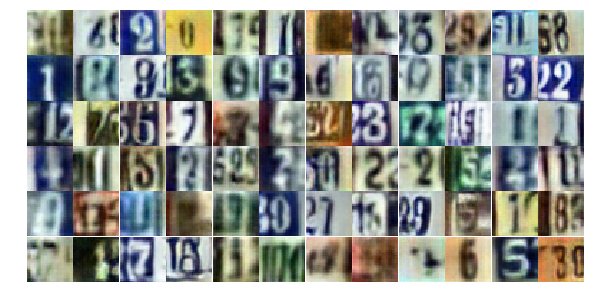

Epoch 16/25... Discriminator Loss: 1.2061... Generator Loss: 0.5582
Epoch 16/25... Discriminator Loss: 0.7552... Generator Loss: 1.4745
Epoch 16/25... Discriminator Loss: 1.6086... Generator Loss: 0.3143
Epoch 16/25... Discriminator Loss: 0.5508... Generator Loss: 1.5307
Epoch 16/25... Discriminator Loss: 0.9654... Generator Loss: 1.3009
Epoch 16/25... Discriminator Loss: 0.8513... Generator Loss: 0.8288
Epoch 17/25... Discriminator Loss: 0.9836... Generator Loss: 0.9898
Epoch 17/25... Discriminator Loss: 0.7330... Generator Loss: 1.0755
Epoch 17/25... Discriminator Loss: 0.7096... Generator Loss: 1.6036
Epoch 17/25... Discriminator Loss: 0.8680... Generator Loss: 0.7692


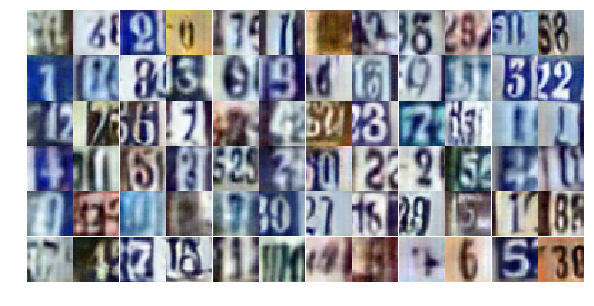

Epoch 17/25... Discriminator Loss: 0.6390... Generator Loss: 1.1524
Epoch 17/25... Discriminator Loss: 0.8103... Generator Loss: 0.7951
Epoch 17/25... Discriminator Loss: 0.9536... Generator Loss: 0.7719
Epoch 17/25... Discriminator Loss: 0.6978... Generator Loss: 1.7735
Epoch 17/25... Discriminator Loss: 1.1942... Generator Loss: 0.5124
Epoch 17/25... Discriminator Loss: 0.9479... Generator Loss: 1.1686
Epoch 17/25... Discriminator Loss: 0.8102... Generator Loss: 1.1340
Epoch 17/25... Discriminator Loss: 1.1520... Generator Loss: 0.5486
Epoch 17/25... Discriminator Loss: 0.5794... Generator Loss: 1.2809
Epoch 17/25... Discriminator Loss: 0.9825... Generator Loss: 1.9636


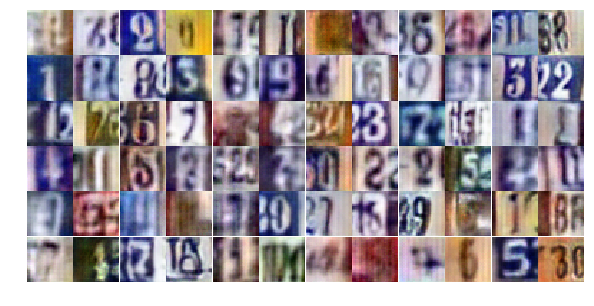

Epoch 17/25... Discriminator Loss: 1.1400... Generator Loss: 1.4439
Epoch 17/25... Discriminator Loss: 0.6935... Generator Loss: 1.6300
Epoch 17/25... Discriminator Loss: 0.6595... Generator Loss: 1.6453
Epoch 17/25... Discriminator Loss: 0.7782... Generator Loss: 1.1615
Epoch 17/25... Discriminator Loss: 0.7329... Generator Loss: 1.6084
Epoch 17/25... Discriminator Loss: 1.4940... Generator Loss: 0.3443
Epoch 17/25... Discriminator Loss: 0.7077... Generator Loss: 1.3372
Epoch 17/25... Discriminator Loss: 0.5648... Generator Loss: 1.4273
Epoch 17/25... Discriminator Loss: 0.7583... Generator Loss: 1.0387
Epoch 17/25... Discriminator Loss: 0.7318... Generator Loss: 1.1691


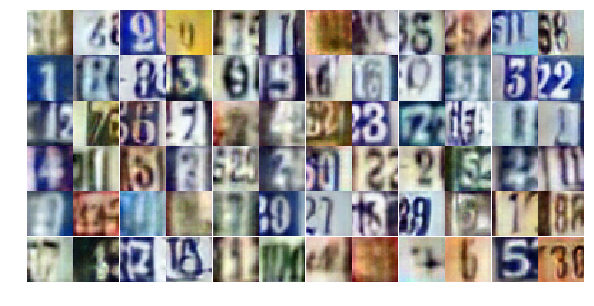

Epoch 17/25... Discriminator Loss: 1.5903... Generator Loss: 0.3191
Epoch 17/25... Discriminator Loss: 0.6294... Generator Loss: 1.3581
Epoch 17/25... Discriminator Loss: 0.7037... Generator Loss: 1.2615
Epoch 17/25... Discriminator Loss: 1.2648... Generator Loss: 0.4351
Epoch 17/25... Discriminator Loss: 1.7577... Generator Loss: 0.2407
Epoch 17/25... Discriminator Loss: 0.7184... Generator Loss: 1.0197
Epoch 17/25... Discriminator Loss: 0.7517... Generator Loss: 0.9161
Epoch 17/25... Discriminator Loss: 1.0578... Generator Loss: 0.6238
Epoch 17/25... Discriminator Loss: 0.9233... Generator Loss: 0.8088
Epoch 17/25... Discriminator Loss: 0.6219... Generator Loss: 1.1425


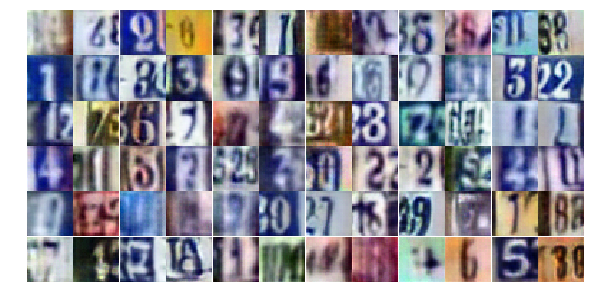

Epoch 17/25... Discriminator Loss: 0.8891... Generator Loss: 0.8639
Epoch 17/25... Discriminator Loss: 0.9768... Generator Loss: 1.2662
Epoch 17/25... Discriminator Loss: 0.8546... Generator Loss: 1.9097
Epoch 17/25... Discriminator Loss: 1.1764... Generator Loss: 0.5409
Epoch 17/25... Discriminator Loss: 0.8762... Generator Loss: 0.8487
Epoch 17/25... Discriminator Loss: 0.6952... Generator Loss: 1.2108
Epoch 17/25... Discriminator Loss: 0.8620... Generator Loss: 1.2041
Epoch 17/25... Discriminator Loss: 0.6838... Generator Loss: 1.7548
Epoch 17/25... Discriminator Loss: 0.4935... Generator Loss: 1.8386
Epoch 17/25... Discriminator Loss: 1.3164... Generator Loss: 0.4430


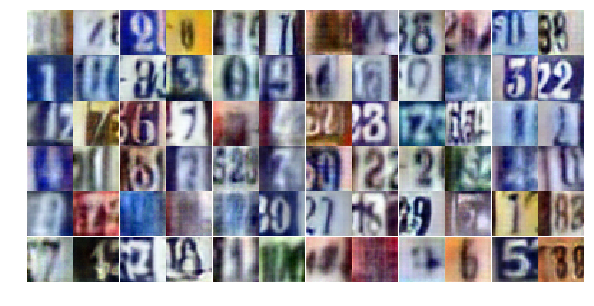

Epoch 17/25... Discriminator Loss: 0.8214... Generator Loss: 1.4018
Epoch 17/25... Discriminator Loss: 0.7280... Generator Loss: 2.1930
Epoch 17/25... Discriminator Loss: 0.8587... Generator Loss: 1.0184
Epoch 17/25... Discriminator Loss: 0.6873... Generator Loss: 1.9756
Epoch 17/25... Discriminator Loss: 0.7792... Generator Loss: 1.0811
Epoch 17/25... Discriminator Loss: 0.8804... Generator Loss: 0.9584
Epoch 17/25... Discriminator Loss: 0.8766... Generator Loss: 0.9131
Epoch 17/25... Discriminator Loss: 0.5516... Generator Loss: 1.4995
Epoch 17/25... Discriminator Loss: 0.9315... Generator Loss: 0.7713
Epoch 17/25... Discriminator Loss: 1.3781... Generator Loss: 0.4201


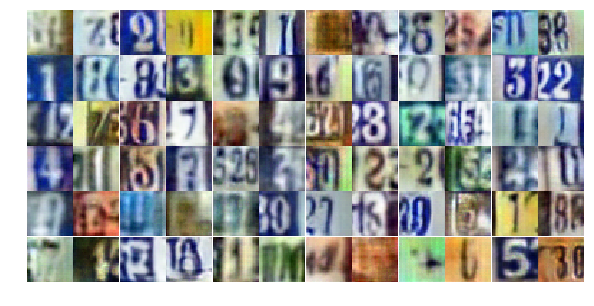

Epoch 17/25... Discriminator Loss: 0.7680... Generator Loss: 1.4980
Epoch 17/25... Discriminator Loss: 0.9354... Generator Loss: 1.2648
Epoch 17/25... Discriminator Loss: 0.6945... Generator Loss: 1.0886
Epoch 17/25... Discriminator Loss: 0.6710... Generator Loss: 1.4547
Epoch 18/25... Discriminator Loss: 0.8400... Generator Loss: 1.0795
Epoch 18/25... Discriminator Loss: 1.0248... Generator Loss: 0.6120
Epoch 18/25... Discriminator Loss: 0.7159... Generator Loss: 1.5843
Epoch 18/25... Discriminator Loss: 0.6522... Generator Loss: 1.9651
Epoch 18/25... Discriminator Loss: 1.0383... Generator Loss: 0.6101
Epoch 18/25... Discriminator Loss: 0.8939... Generator Loss: 0.7690


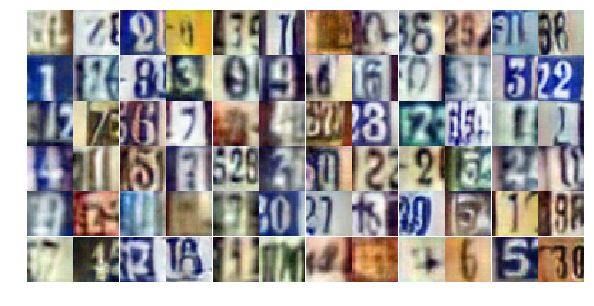

Epoch 18/25... Discriminator Loss: 0.7735... Generator Loss: 2.1710
Epoch 18/25... Discriminator Loss: 1.1122... Generator Loss: 0.6769
Epoch 18/25... Discriminator Loss: 0.8342... Generator Loss: 0.8627
Epoch 18/25... Discriminator Loss: 0.6067... Generator Loss: 1.6006
Epoch 18/25... Discriminator Loss: 0.6388... Generator Loss: 1.3245
Epoch 18/25... Discriminator Loss: 0.7302... Generator Loss: 1.1169
Epoch 18/25... Discriminator Loss: 0.7199... Generator Loss: 0.9450
Epoch 18/25... Discriminator Loss: 1.1611... Generator Loss: 0.5592
Epoch 18/25... Discriminator Loss: 0.6303... Generator Loss: 1.2826
Epoch 18/25... Discriminator Loss: 0.5202... Generator Loss: 1.4206


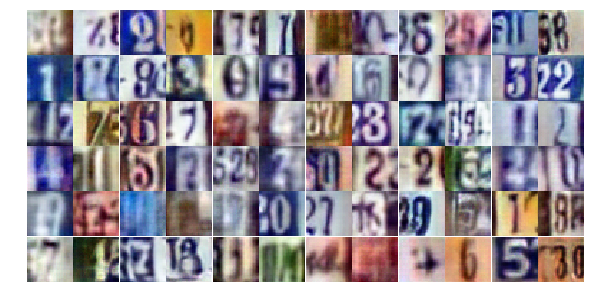

Epoch 18/25... Discriminator Loss: 0.8824... Generator Loss: 0.7393
Epoch 18/25... Discriminator Loss: 0.7907... Generator Loss: 1.0212
Epoch 18/25... Discriminator Loss: 1.0955... Generator Loss: 0.6309
Epoch 18/25... Discriminator Loss: 0.4469... Generator Loss: 1.6282
Epoch 18/25... Discriminator Loss: 0.7763... Generator Loss: 1.2400
Epoch 18/25... Discriminator Loss: 0.8627... Generator Loss: 0.8836
Epoch 18/25... Discriminator Loss: 1.2917... Generator Loss: 0.4752
Epoch 18/25... Discriminator Loss: 0.8074... Generator Loss: 0.9263
Epoch 18/25... Discriminator Loss: 0.5836... Generator Loss: 1.3742
Epoch 18/25... Discriminator Loss: 0.7078... Generator Loss: 1.5270


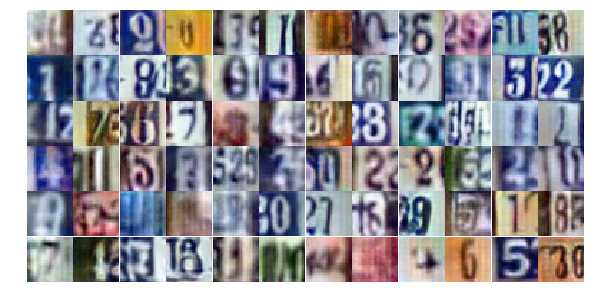

Epoch 18/25... Discriminator Loss: 0.6744... Generator Loss: 1.0700
Epoch 18/25... Discriminator Loss: 0.7458... Generator Loss: 1.2783
Epoch 18/25... Discriminator Loss: 0.9689... Generator Loss: 0.7329
Epoch 18/25... Discriminator Loss: 0.7238... Generator Loss: 1.0129
Epoch 18/25... Discriminator Loss: 1.2327... Generator Loss: 0.4608
Epoch 18/25... Discriminator Loss: 0.5514... Generator Loss: 1.3773
Epoch 18/25... Discriminator Loss: 0.6630... Generator Loss: 1.6118
Epoch 18/25... Discriminator Loss: 0.6653... Generator Loss: 1.4310
Epoch 18/25... Discriminator Loss: 0.9751... Generator Loss: 0.6512
Epoch 18/25... Discriminator Loss: 1.0074... Generator Loss: 0.8157


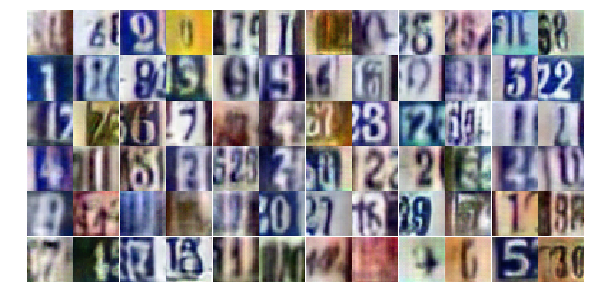

Epoch 18/25... Discriminator Loss: 0.8318... Generator Loss: 0.8962
Epoch 18/25... Discriminator Loss: 0.6518... Generator Loss: 1.5693
Epoch 18/25... Discriminator Loss: 0.7937... Generator Loss: 0.9387
Epoch 18/25... Discriminator Loss: 0.7118... Generator Loss: 1.2947
Epoch 18/25... Discriminator Loss: 0.8184... Generator Loss: 0.8851
Epoch 18/25... Discriminator Loss: 0.6813... Generator Loss: 0.9877
Epoch 18/25... Discriminator Loss: 0.9247... Generator Loss: 0.9754
Epoch 18/25... Discriminator Loss: 0.7857... Generator Loss: 1.3689
Epoch 18/25... Discriminator Loss: 0.6555... Generator Loss: 1.4395
Epoch 18/25... Discriminator Loss: 0.4015... Generator Loss: 1.7247


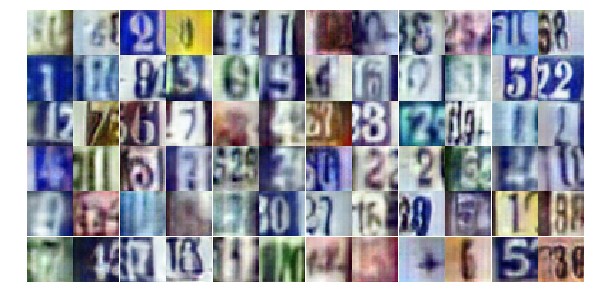

Epoch 18/25... Discriminator Loss: 0.6314... Generator Loss: 1.0913
Epoch 18/25... Discriminator Loss: 0.7465... Generator Loss: 1.0166
Epoch 18/25... Discriminator Loss: 0.8468... Generator Loss: 0.9232
Epoch 18/25... Discriminator Loss: 0.9418... Generator Loss: 0.8392
Epoch 18/25... Discriminator Loss: 0.6068... Generator Loss: 1.3680
Epoch 18/25... Discriminator Loss: 0.9580... Generator Loss: 2.2936
Epoch 18/25... Discriminator Loss: 0.8336... Generator Loss: 0.8468
Epoch 18/25... Discriminator Loss: 0.6711... Generator Loss: 1.3641
Epoch 18/25... Discriminator Loss: 0.9962... Generator Loss: 1.8443
Epoch 18/25... Discriminator Loss: 1.0249... Generator Loss: 0.6810


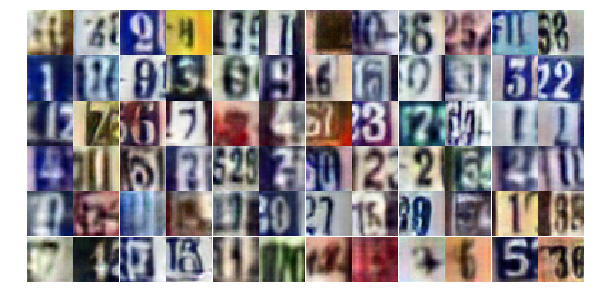

Epoch 18/25... Discriminator Loss: 0.7247... Generator Loss: 1.7422
Epoch 19/25... Discriminator Loss: 1.2268... Generator Loss: 0.5167
Epoch 19/25... Discriminator Loss: 1.2241... Generator Loss: 0.4897
Epoch 19/25... Discriminator Loss: 0.7857... Generator Loss: 1.2397
Epoch 19/25... Discriminator Loss: 0.7280... Generator Loss: 1.9572
Epoch 19/25... Discriminator Loss: 0.8966... Generator Loss: 0.8840
Epoch 19/25... Discriminator Loss: 0.6240... Generator Loss: 1.2470
Epoch 19/25... Discriminator Loss: 0.9958... Generator Loss: 0.7678
Epoch 19/25... Discriminator Loss: 0.9038... Generator Loss: 0.9332
Epoch 19/25... Discriminator Loss: 0.9393... Generator Loss: 2.0532


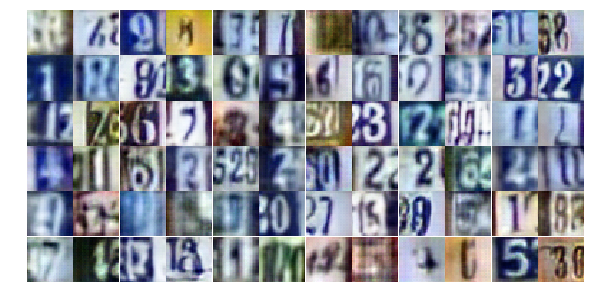

Epoch 19/25... Discriminator Loss: 0.8926... Generator Loss: 0.8282
Epoch 19/25... Discriminator Loss: 0.8158... Generator Loss: 0.9041
Epoch 19/25... Discriminator Loss: 0.6798... Generator Loss: 1.2671
Epoch 19/25... Discriminator Loss: 1.0249... Generator Loss: 0.6599
Epoch 19/25... Discriminator Loss: 0.9195... Generator Loss: 0.9940
Epoch 19/25... Discriminator Loss: 0.7604... Generator Loss: 1.1817
Epoch 19/25... Discriminator Loss: 1.1086... Generator Loss: 0.5798
Epoch 19/25... Discriminator Loss: 0.7842... Generator Loss: 0.8945
Epoch 19/25... Discriminator Loss: 0.7843... Generator Loss: 1.4303
Epoch 19/25... Discriminator Loss: 1.3248... Generator Loss: 0.4105


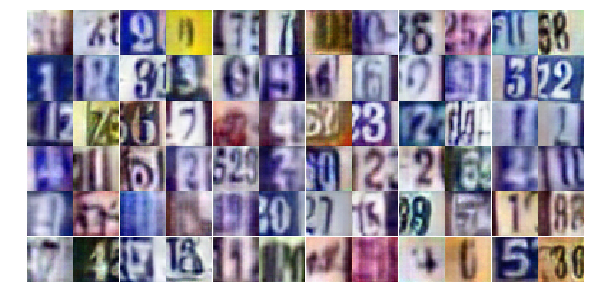

Epoch 19/25... Discriminator Loss: 0.8573... Generator Loss: 0.8487
Epoch 19/25... Discriminator Loss: 1.1175... Generator Loss: 0.6579
Epoch 19/25... Discriminator Loss: 1.2206... Generator Loss: 0.5140
Epoch 19/25... Discriminator Loss: 0.7211... Generator Loss: 1.1398
Epoch 19/25... Discriminator Loss: 1.4706... Generator Loss: 0.3911
Epoch 19/25... Discriminator Loss: 0.9474... Generator Loss: 2.0890
Epoch 19/25... Discriminator Loss: 0.5918... Generator Loss: 1.1641
Epoch 19/25... Discriminator Loss: 0.5493... Generator Loss: 1.4318
Epoch 19/25... Discriminator Loss: 0.7339... Generator Loss: 0.9781
Epoch 19/25... Discriminator Loss: 1.0548... Generator Loss: 0.6381


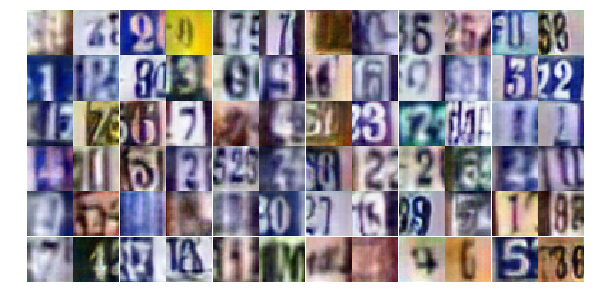

Epoch 19/25... Discriminator Loss: 0.8942... Generator Loss: 0.7728
Epoch 19/25... Discriminator Loss: 0.7744... Generator Loss: 0.8730
Epoch 19/25... Discriminator Loss: 1.0065... Generator Loss: 0.6078
Epoch 19/25... Discriminator Loss: 0.6017... Generator Loss: 1.9920
Epoch 19/25... Discriminator Loss: 1.0100... Generator Loss: 0.6471
Epoch 19/25... Discriminator Loss: 0.6933... Generator Loss: 1.2520
Epoch 19/25... Discriminator Loss: 0.9322... Generator Loss: 0.8045
Epoch 19/25... Discriminator Loss: 0.7931... Generator Loss: 0.9537
Epoch 19/25... Discriminator Loss: 0.9400... Generator Loss: 1.3736
Epoch 19/25... Discriminator Loss: 0.6251... Generator Loss: 1.1864


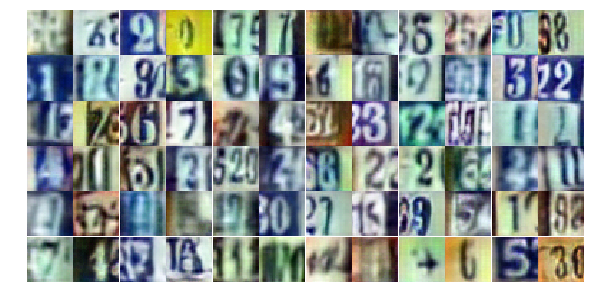

Epoch 19/25... Discriminator Loss: 0.6688... Generator Loss: 1.0362
Epoch 19/25... Discriminator Loss: 0.8602... Generator Loss: 0.9257
Epoch 19/25... Discriminator Loss: 1.2520... Generator Loss: 0.4643
Epoch 19/25... Discriminator Loss: 1.0186... Generator Loss: 0.6395
Epoch 19/25... Discriminator Loss: 0.6875... Generator Loss: 1.0529
Epoch 19/25... Discriminator Loss: 0.8900... Generator Loss: 0.7778
Epoch 19/25... Discriminator Loss: 0.7557... Generator Loss: 1.0457
Epoch 19/25... Discriminator Loss: 0.6035... Generator Loss: 1.7998
Epoch 19/25... Discriminator Loss: 0.6466... Generator Loss: 1.1737
Epoch 19/25... Discriminator Loss: 0.9275... Generator Loss: 0.7766


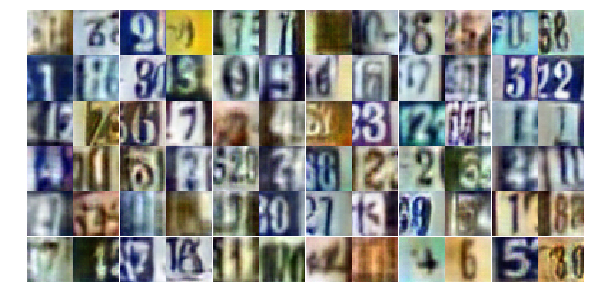

Epoch 19/25... Discriminator Loss: 1.1784... Generator Loss: 0.5011
Epoch 19/25... Discriminator Loss: 0.9212... Generator Loss: 1.8658
Epoch 19/25... Discriminator Loss: 0.8651... Generator Loss: 1.5649
Epoch 19/25... Discriminator Loss: 1.3465... Generator Loss: 0.4684
Epoch 19/25... Discriminator Loss: 0.9099... Generator Loss: 2.0032
Epoch 19/25... Discriminator Loss: 0.7869... Generator Loss: 1.1340
Epoch 19/25... Discriminator Loss: 1.0808... Generator Loss: 0.6270
Epoch 19/25... Discriminator Loss: 0.5980... Generator Loss: 2.0047
Epoch 20/25... Discriminator Loss: 0.7632... Generator Loss: 0.9558
Epoch 20/25... Discriminator Loss: 0.6781... Generator Loss: 1.5556


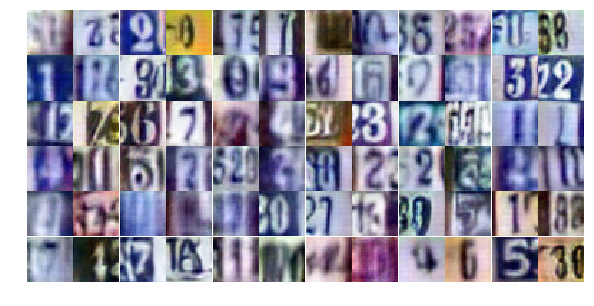

Epoch 20/25... Discriminator Loss: 0.4934... Generator Loss: 1.6864
Epoch 20/25... Discriminator Loss: 1.1696... Generator Loss: 0.4925
Epoch 20/25... Discriminator Loss: 1.6116... Generator Loss: 0.3140
Epoch 20/25... Discriminator Loss: 1.2779... Generator Loss: 0.4597
Epoch 20/25... Discriminator Loss: 0.4119... Generator Loss: 1.8616
Epoch 20/25... Discriminator Loss: 0.6554... Generator Loss: 1.2942
Epoch 20/25... Discriminator Loss: 0.6080... Generator Loss: 1.1324
Epoch 20/25... Discriminator Loss: 0.7034... Generator Loss: 1.2743
Epoch 20/25... Discriminator Loss: 0.9212... Generator Loss: 0.7789
Epoch 20/25... Discriminator Loss: 0.7790... Generator Loss: 0.9234


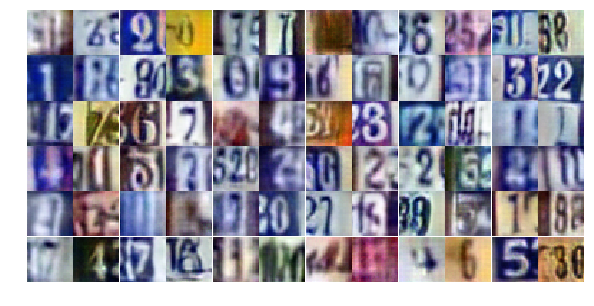

Epoch 20/25... Discriminator Loss: 0.9412... Generator Loss: 0.7454
Epoch 20/25... Discriminator Loss: 0.8995... Generator Loss: 1.0455
Epoch 20/25... Discriminator Loss: 0.8350... Generator Loss: 1.8765
Epoch 20/25... Discriminator Loss: 1.0589... Generator Loss: 0.7514
Epoch 20/25... Discriminator Loss: 1.1709... Generator Loss: 0.5135
Epoch 20/25... Discriminator Loss: 0.9885... Generator Loss: 0.6814
Epoch 20/25... Discriminator Loss: 1.0188... Generator Loss: 0.7252
Epoch 20/25... Discriminator Loss: 0.8439... Generator Loss: 1.5345
Epoch 20/25... Discriminator Loss: 0.5705... Generator Loss: 1.2030
Epoch 20/25... Discriminator Loss: 1.2448... Generator Loss: 0.4902


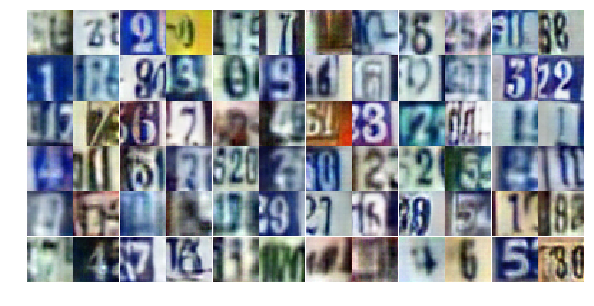

Epoch 20/25... Discriminator Loss: 0.6294... Generator Loss: 1.5663
Epoch 20/25... Discriminator Loss: 0.6438... Generator Loss: 1.3182
Epoch 20/25... Discriminator Loss: 0.4755... Generator Loss: 1.8319
Epoch 20/25... Discriminator Loss: 0.9551... Generator Loss: 0.7123
Epoch 20/25... Discriminator Loss: 1.0096... Generator Loss: 0.6635
Epoch 20/25... Discriminator Loss: 0.4696... Generator Loss: 1.6245
Epoch 20/25... Discriminator Loss: 0.5150... Generator Loss: 2.0576
Epoch 20/25... Discriminator Loss: 1.3461... Generator Loss: 0.4334
Epoch 20/25... Discriminator Loss: 0.9745... Generator Loss: 0.6965
Epoch 20/25... Discriminator Loss: 0.4051... Generator Loss: 1.6136


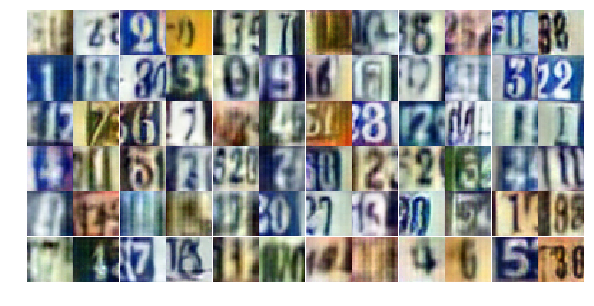

Epoch 20/25... Discriminator Loss: 0.6852... Generator Loss: 1.5823
Epoch 20/25... Discriminator Loss: 1.1009... Generator Loss: 0.5939
Epoch 20/25... Discriminator Loss: 1.3018... Generator Loss: 0.4474
Epoch 20/25... Discriminator Loss: 0.8973... Generator Loss: 0.9072
Epoch 20/25... Discriminator Loss: 0.7459... Generator Loss: 0.9019
Epoch 20/25... Discriminator Loss: 1.0145... Generator Loss: 1.3396
Epoch 20/25... Discriminator Loss: 0.6765... Generator Loss: 1.0648
Epoch 20/25... Discriminator Loss: 1.1221... Generator Loss: 0.5397
Epoch 20/25... Discriminator Loss: 1.0087... Generator Loss: 1.9315
Epoch 20/25... Discriminator Loss: 1.3121... Generator Loss: 0.4723


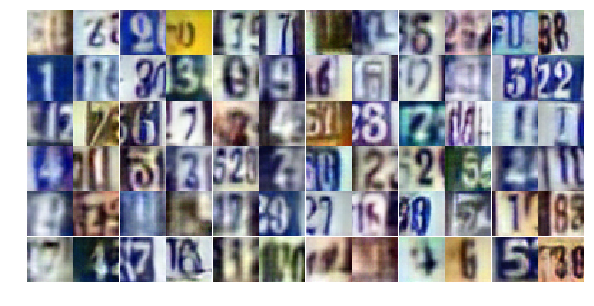

Epoch 20/25... Discriminator Loss: 1.3041... Generator Loss: 0.4525
Epoch 20/25... Discriminator Loss: 0.7711... Generator Loss: 1.2483
Epoch 20/25... Discriminator Loss: 0.6871... Generator Loss: 1.3436
Epoch 20/25... Discriminator Loss: 0.5709... Generator Loss: 1.2795
Epoch 20/25... Discriminator Loss: 0.7084... Generator Loss: 1.5164
Epoch 20/25... Discriminator Loss: 1.0142... Generator Loss: 0.6692
Epoch 20/25... Discriminator Loss: 0.7374... Generator Loss: 0.9784
Epoch 20/25... Discriminator Loss: 0.6272... Generator Loss: 2.0922
Epoch 20/25... Discriminator Loss: 0.6313... Generator Loss: 1.5825
Epoch 20/25... Discriminator Loss: 0.6794... Generator Loss: 1.1744


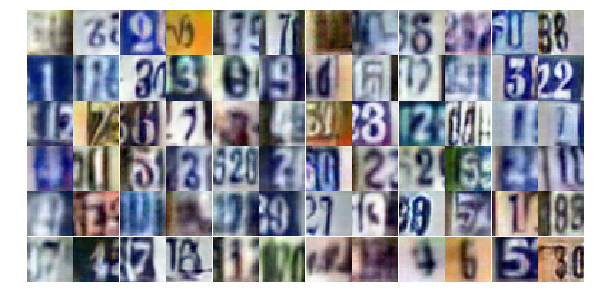

Epoch 20/25... Discriminator Loss: 0.5718... Generator Loss: 1.6959
Epoch 20/25... Discriminator Loss: 1.3978... Generator Loss: 3.2707
Epoch 20/25... Discriminator Loss: 0.6685... Generator Loss: 1.3428
Epoch 20/25... Discriminator Loss: 1.3067... Generator Loss: 0.5283
Epoch 20/25... Discriminator Loss: 1.0550... Generator Loss: 0.6207
Epoch 20/25... Discriminator Loss: 0.6581... Generator Loss: 1.0463
Epoch 21/25... Discriminator Loss: 1.2029... Generator Loss: 0.5541
Epoch 21/25... Discriminator Loss: 0.8540... Generator Loss: 0.7648
Epoch 21/25... Discriminator Loss: 1.0561... Generator Loss: 0.6167
Epoch 21/25... Discriminator Loss: 1.0968... Generator Loss: 0.5770


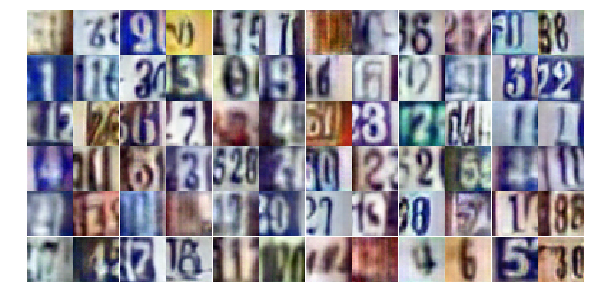

Epoch 21/25... Discriminator Loss: 0.6481... Generator Loss: 1.0773
Epoch 21/25... Discriminator Loss: 1.2876... Generator Loss: 0.4782
Epoch 21/25... Discriminator Loss: 0.5902... Generator Loss: 1.3262
Epoch 21/25... Discriminator Loss: 0.5867... Generator Loss: 1.4170
Epoch 21/25... Discriminator Loss: 0.6656... Generator Loss: 1.2377
Epoch 21/25... Discriminator Loss: 0.6150... Generator Loss: 1.2004
Epoch 21/25... Discriminator Loss: 0.7954... Generator Loss: 0.8757
Epoch 21/25... Discriminator Loss: 0.8126... Generator Loss: 2.5259
Epoch 21/25... Discriminator Loss: 0.6758... Generator Loss: 1.0675
Epoch 21/25... Discriminator Loss: 0.7659... Generator Loss: 0.9253


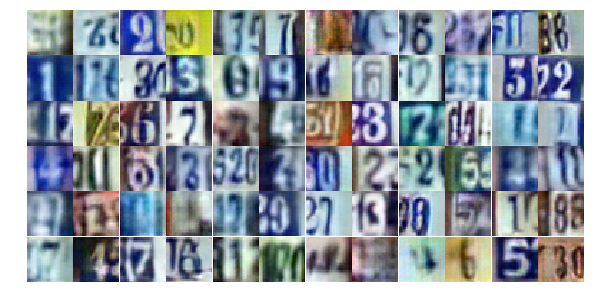

Epoch 21/25... Discriminator Loss: 0.4400... Generator Loss: 1.8566
Epoch 21/25... Discriminator Loss: 0.9148... Generator Loss: 0.7421
Epoch 21/25... Discriminator Loss: 1.4144... Generator Loss: 0.4573
Epoch 21/25... Discriminator Loss: 0.5935... Generator Loss: 1.4194
Epoch 21/25... Discriminator Loss: 0.7307... Generator Loss: 1.3017
Epoch 21/25... Discriminator Loss: 1.4529... Generator Loss: 0.3971
Epoch 21/25... Discriminator Loss: 0.8340... Generator Loss: 0.9948
Epoch 21/25... Discriminator Loss: 0.5129... Generator Loss: 1.7258
Epoch 21/25... Discriminator Loss: 0.4774... Generator Loss: 1.6993
Epoch 21/25... Discriminator Loss: 0.6606... Generator Loss: 1.2340


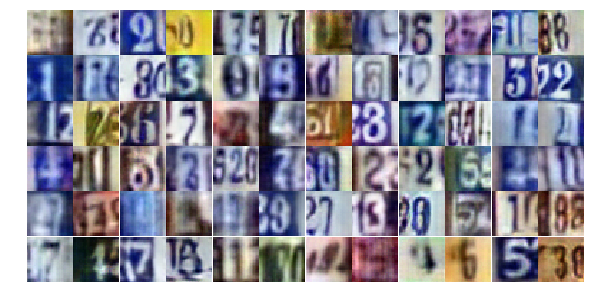

Epoch 21/25... Discriminator Loss: 0.9768... Generator Loss: 0.6440
Epoch 21/25... Discriminator Loss: 0.4886... Generator Loss: 1.4122
Epoch 21/25... Discriminator Loss: 0.9560... Generator Loss: 0.6974
Epoch 21/25... Discriminator Loss: 0.7863... Generator Loss: 0.9519
Epoch 21/25... Discriminator Loss: 0.8170... Generator Loss: 0.9143
Epoch 21/25... Discriminator Loss: 0.8497... Generator Loss: 0.8988
Epoch 21/25... Discriminator Loss: 0.5903... Generator Loss: 1.6253
Epoch 21/25... Discriminator Loss: 0.7851... Generator Loss: 0.9202
Epoch 21/25... Discriminator Loss: 0.8603... Generator Loss: 0.8292
Epoch 21/25... Discriminator Loss: 1.5555... Generator Loss: 0.3587


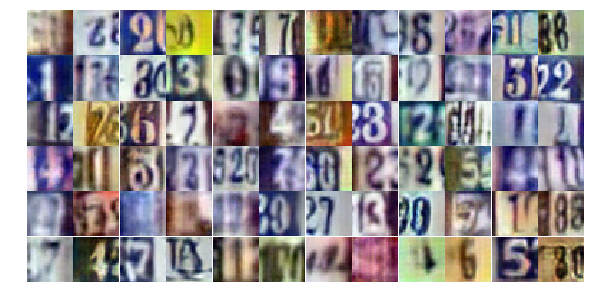

Epoch 21/25... Discriminator Loss: 0.8091... Generator Loss: 0.8992
Epoch 21/25... Discriminator Loss: 0.7251... Generator Loss: 2.4175
Epoch 21/25... Discriminator Loss: 0.9479... Generator Loss: 0.7826
Epoch 21/25... Discriminator Loss: 0.5869... Generator Loss: 1.2365
Epoch 21/25... Discriminator Loss: 0.5715... Generator Loss: 1.1697
Epoch 21/25... Discriminator Loss: 0.8394... Generator Loss: 0.8674
Epoch 21/25... Discriminator Loss: 1.0019... Generator Loss: 0.7426
Epoch 21/25... Discriminator Loss: 1.9570... Generator Loss: 0.2605
Epoch 21/25... Discriminator Loss: 0.7408... Generator Loss: 1.2234
Epoch 21/25... Discriminator Loss: 0.6689... Generator Loss: 1.1559


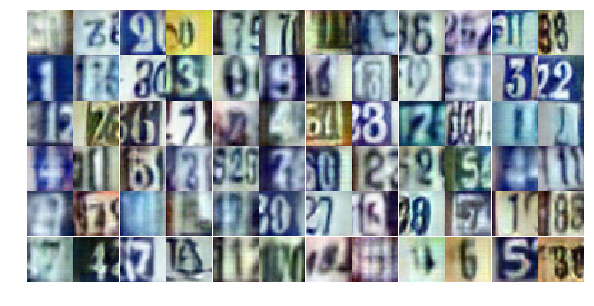

Epoch 21/25... Discriminator Loss: 0.8814... Generator Loss: 0.7372
Epoch 21/25... Discriminator Loss: 1.0388... Generator Loss: 0.6903
Epoch 21/25... Discriminator Loss: 0.4904... Generator Loss: 1.6106
Epoch 21/25... Discriminator Loss: 0.7951... Generator Loss: 2.2442
Epoch 21/25... Discriminator Loss: 0.6123... Generator Loss: 1.4947
Epoch 21/25... Discriminator Loss: 0.6832... Generator Loss: 1.2891
Epoch 21/25... Discriminator Loss: 0.9076... Generator Loss: 0.7037
Epoch 21/25... Discriminator Loss: 1.1419... Generator Loss: 0.5804
Epoch 21/25... Discriminator Loss: 0.8273... Generator Loss: 1.0770
Epoch 21/25... Discriminator Loss: 1.1355... Generator Loss: 0.6116


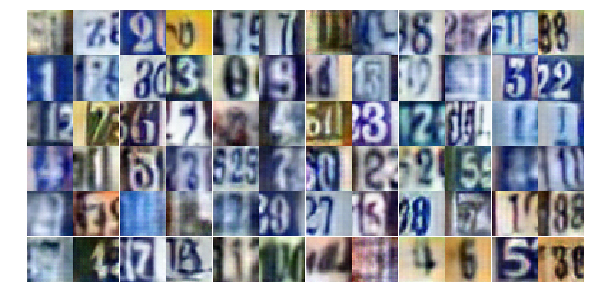

Epoch 21/25... Discriminator Loss: 0.7242... Generator Loss: 0.9683
Epoch 21/25... Discriminator Loss: 0.7913... Generator Loss: 1.1137
Epoch 21/25... Discriminator Loss: 0.6330... Generator Loss: 1.2234
Epoch 22/25... Discriminator Loss: 0.6930... Generator Loss: 1.1836
Epoch 22/25... Discriminator Loss: 0.9429... Generator Loss: 0.8376
Epoch 22/25... Discriminator Loss: 0.5532... Generator Loss: 1.8074
Epoch 22/25... Discriminator Loss: 0.6695... Generator Loss: 1.2579
Epoch 22/25... Discriminator Loss: 0.5048... Generator Loss: 1.5625
Epoch 22/25... Discriminator Loss: 0.5476... Generator Loss: 1.2950
Epoch 22/25... Discriminator Loss: 1.0010... Generator Loss: 0.6841


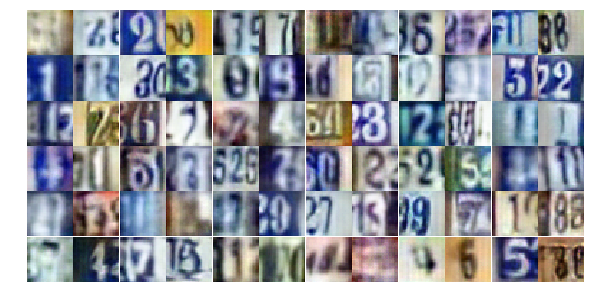

Epoch 22/25... Discriminator Loss: 1.0074... Generator Loss: 0.6613
Epoch 22/25... Discriminator Loss: 0.9931... Generator Loss: 0.7412
Epoch 22/25... Discriminator Loss: 0.9469... Generator Loss: 0.8143
Epoch 22/25... Discriminator Loss: 0.6376... Generator Loss: 1.1578
Epoch 22/25... Discriminator Loss: 0.5692... Generator Loss: 1.2473
Epoch 22/25... Discriminator Loss: 0.5789... Generator Loss: 1.4872
Epoch 22/25... Discriminator Loss: 0.7694... Generator Loss: 0.9961
Epoch 22/25... Discriminator Loss: 0.8193... Generator Loss: 0.9937
Epoch 22/25... Discriminator Loss: 0.7400... Generator Loss: 1.1849
Epoch 22/25... Discriminator Loss: 1.2040... Generator Loss: 0.5278


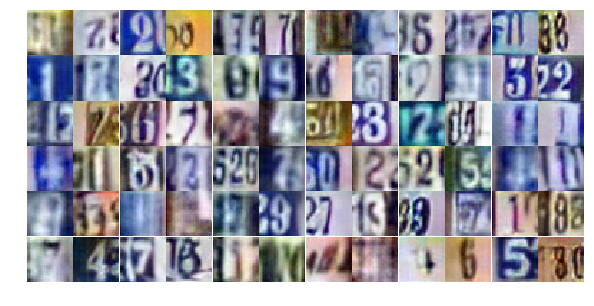

Epoch 22/25... Discriminator Loss: 0.7330... Generator Loss: 1.1419
Epoch 22/25... Discriminator Loss: 0.6445... Generator Loss: 1.3276
Epoch 22/25... Discriminator Loss: 0.7397... Generator Loss: 1.1650
Epoch 22/25... Discriminator Loss: 0.7498... Generator Loss: 1.8107
Epoch 22/25... Discriminator Loss: 0.7449... Generator Loss: 1.9396
Epoch 22/25... Discriminator Loss: 0.9340... Generator Loss: 0.7273
Epoch 22/25... Discriminator Loss: 0.6392... Generator Loss: 2.1020
Epoch 22/25... Discriminator Loss: 0.4809... Generator Loss: 1.7581
Epoch 22/25... Discriminator Loss: 0.8946... Generator Loss: 0.7663
Epoch 22/25... Discriminator Loss: 0.6290... Generator Loss: 1.3150


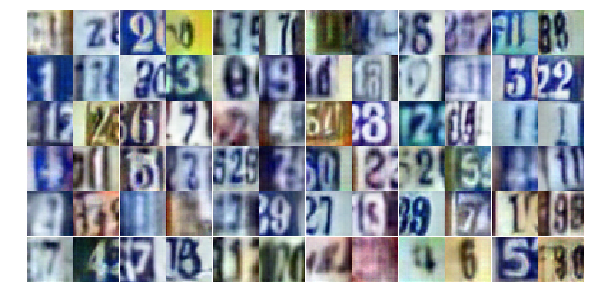

Epoch 22/25... Discriminator Loss: 0.5498... Generator Loss: 1.3061
Epoch 22/25... Discriminator Loss: 0.5959... Generator Loss: 1.4975
Epoch 22/25... Discriminator Loss: 0.9417... Generator Loss: 0.8140
Epoch 22/25... Discriminator Loss: 0.6657... Generator Loss: 1.0855
Epoch 22/25... Discriminator Loss: 0.6927... Generator Loss: 1.6924
Epoch 22/25... Discriminator Loss: 0.8405... Generator Loss: 0.8243
Epoch 22/25... Discriminator Loss: 1.7184... Generator Loss: 0.2895
Epoch 22/25... Discriminator Loss: 0.7961... Generator Loss: 1.2192
Epoch 22/25... Discriminator Loss: 0.7698... Generator Loss: 1.3074
Epoch 22/25... Discriminator Loss: 2.0079... Generator Loss: 0.2298


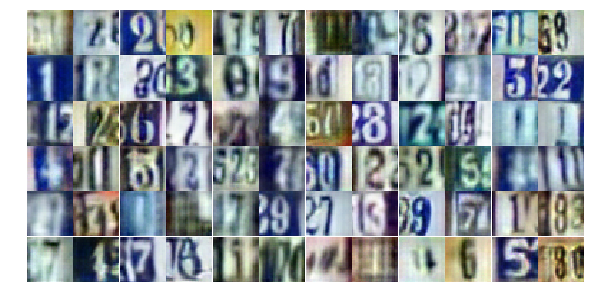

Epoch 22/25... Discriminator Loss: 0.9284... Generator Loss: 0.8038
Epoch 22/25... Discriminator Loss: 0.7082... Generator Loss: 1.2909
Epoch 22/25... Discriminator Loss: 0.5400... Generator Loss: 1.2259
Epoch 22/25... Discriminator Loss: 0.6382... Generator Loss: 1.1008
Epoch 22/25... Discriminator Loss: 0.5907... Generator Loss: 2.1912
Epoch 22/25... Discriminator Loss: 0.6594... Generator Loss: 0.9824
Epoch 22/25... Discriminator Loss: 0.7611... Generator Loss: 1.0145
Epoch 22/25... Discriminator Loss: 1.2498... Generator Loss: 0.5706
Epoch 22/25... Discriminator Loss: 1.0363... Generator Loss: 0.6738
Epoch 22/25... Discriminator Loss: 0.5624... Generator Loss: 1.4707


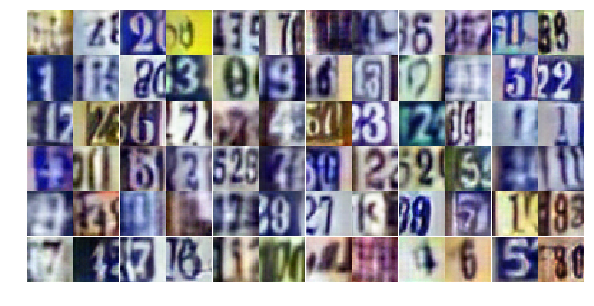

Epoch 22/25... Discriminator Loss: 0.8726... Generator Loss: 0.7822
Epoch 22/25... Discriminator Loss: 0.8189... Generator Loss: 1.8173
Epoch 22/25... Discriminator Loss: 0.8467... Generator Loss: 0.9231
Epoch 22/25... Discriminator Loss: 1.1003... Generator Loss: 0.6462
Epoch 22/25... Discriminator Loss: 0.6994... Generator Loss: 0.9164
Epoch 22/25... Discriminator Loss: 0.9432... Generator Loss: 0.8234
Epoch 22/25... Discriminator Loss: 1.3378... Generator Loss: 0.4831
Epoch 22/25... Discriminator Loss: 0.6910... Generator Loss: 1.1286
Epoch 22/25... Discriminator Loss: 1.0662... Generator Loss: 0.7910
Epoch 22/25... Discriminator Loss: 0.7540... Generator Loss: 1.0022


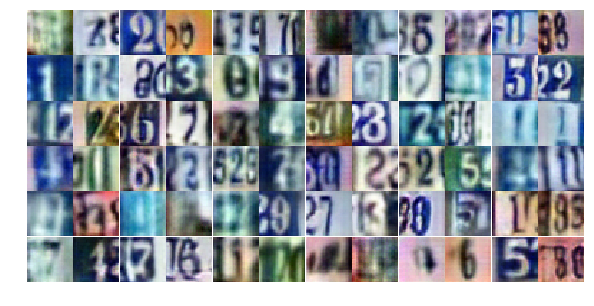

Epoch 23/25... Discriminator Loss: 0.6396... Generator Loss: 1.1766
Epoch 23/25... Discriminator Loss: 0.5983... Generator Loss: 1.2968
Epoch 23/25... Discriminator Loss: 1.1736... Generator Loss: 0.5273
Epoch 23/25... Discriminator Loss: 0.7801... Generator Loss: 0.9436
Epoch 23/25... Discriminator Loss: 0.7068... Generator Loss: 0.9561
Epoch 23/25... Discriminator Loss: 0.7822... Generator Loss: 1.0092
Epoch 23/25... Discriminator Loss: 0.8502... Generator Loss: 0.9584
Epoch 23/25... Discriminator Loss: 0.7611... Generator Loss: 0.8702
Epoch 23/25... Discriminator Loss: 0.7512... Generator Loss: 0.8861
Epoch 23/25... Discriminator Loss: 0.4643... Generator Loss: 1.8803


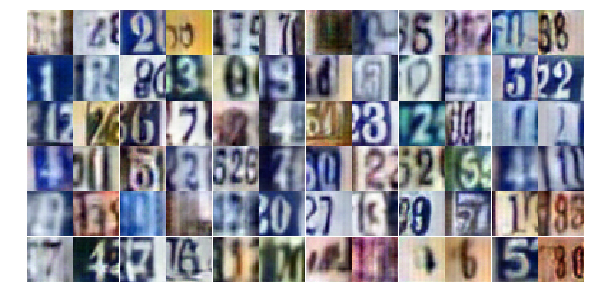

Epoch 23/25... Discriminator Loss: 0.6362... Generator Loss: 1.1239
Epoch 23/25... Discriminator Loss: 0.5898... Generator Loss: 1.5554
Epoch 23/25... Discriminator Loss: 0.6339... Generator Loss: 1.8005
Epoch 23/25... Discriminator Loss: 0.7319... Generator Loss: 1.2463
Epoch 23/25... Discriminator Loss: 0.5429... Generator Loss: 1.4387
Epoch 23/25... Discriminator Loss: 0.9886... Generator Loss: 0.6855
Epoch 23/25... Discriminator Loss: 0.8591... Generator Loss: 0.8625
Epoch 23/25... Discriminator Loss: 0.7498... Generator Loss: 0.9546
Epoch 23/25... Discriminator Loss: 0.8702... Generator Loss: 0.8143
Epoch 23/25... Discriminator Loss: 0.7460... Generator Loss: 1.0820


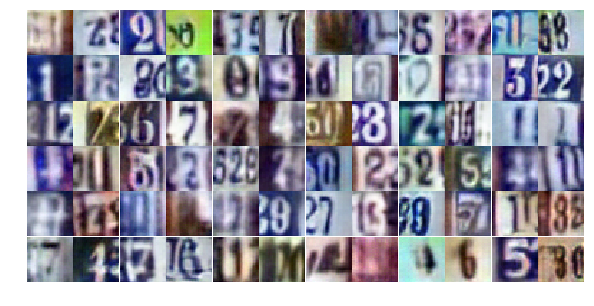

Epoch 23/25... Discriminator Loss: 0.9432... Generator Loss: 0.7798
Epoch 23/25... Discriminator Loss: 0.6537... Generator Loss: 1.1533
Epoch 23/25... Discriminator Loss: 1.1627... Generator Loss: 0.5453
Epoch 23/25... Discriminator Loss: 0.6223... Generator Loss: 1.2591
Epoch 23/25... Discriminator Loss: 0.5756... Generator Loss: 1.3783
Epoch 23/25... Discriminator Loss: 0.7474... Generator Loss: 1.1089
Epoch 23/25... Discriminator Loss: 1.0001... Generator Loss: 0.7272
Epoch 23/25... Discriminator Loss: 0.9344... Generator Loss: 0.7694
Epoch 23/25... Discriminator Loss: 0.7933... Generator Loss: 0.8321
Epoch 23/25... Discriminator Loss: 0.9172... Generator Loss: 2.2803


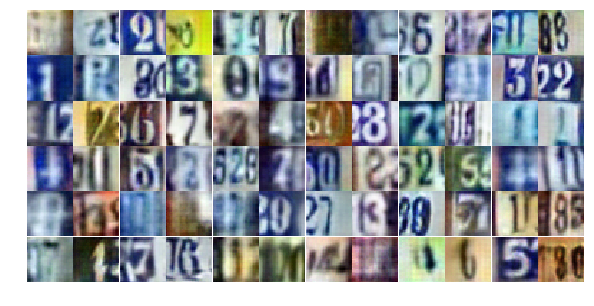

Epoch 23/25... Discriminator Loss: 0.6320... Generator Loss: 2.1134
Epoch 23/25... Discriminator Loss: 0.7091... Generator Loss: 0.9524
Epoch 23/25... Discriminator Loss: 0.5373... Generator Loss: 1.3640
Epoch 23/25... Discriminator Loss: 0.9213... Generator Loss: 0.9064
Epoch 23/25... Discriminator Loss: 0.5818... Generator Loss: 1.9896
Epoch 23/25... Discriminator Loss: 0.7603... Generator Loss: 0.9900
Epoch 23/25... Discriminator Loss: 1.2488... Generator Loss: 0.5013
Epoch 23/25... Discriminator Loss: 0.9552... Generator Loss: 0.7793
Epoch 23/25... Discriminator Loss: 0.4981... Generator Loss: 1.3649
Epoch 23/25... Discriminator Loss: 0.5860... Generator Loss: 1.3266


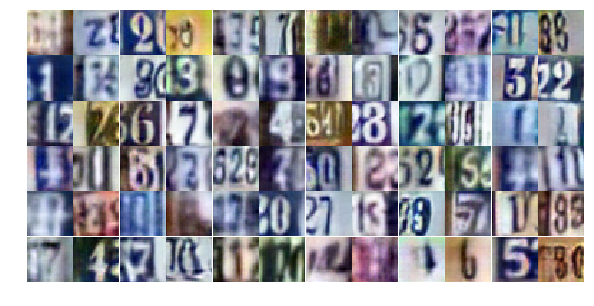

Epoch 23/25... Discriminator Loss: 1.3031... Generator Loss: 0.5625
Epoch 23/25... Discriminator Loss: 0.9982... Generator Loss: 2.4798
Epoch 23/25... Discriminator Loss: 0.8500... Generator Loss: 2.3978
Epoch 23/25... Discriminator Loss: 0.7355... Generator Loss: 1.0353
Epoch 23/25... Discriminator Loss: 1.1381... Generator Loss: 0.6707
Epoch 23/25... Discriminator Loss: 0.6801... Generator Loss: 1.0240
Epoch 23/25... Discriminator Loss: 0.8798... Generator Loss: 0.8003
Epoch 23/25... Discriminator Loss: 0.7698... Generator Loss: 1.3937
Epoch 23/25... Discriminator Loss: 0.6415... Generator Loss: 1.3805
Epoch 23/25... Discriminator Loss: 0.6767... Generator Loss: 1.1269


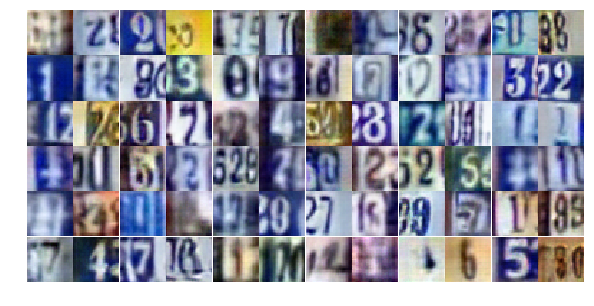

Epoch 23/25... Discriminator Loss: 0.7380... Generator Loss: 1.2122
Epoch 23/25... Discriminator Loss: 1.9360... Generator Loss: 0.2240
Epoch 23/25... Discriminator Loss: 0.9319... Generator Loss: 0.7471
Epoch 23/25... Discriminator Loss: 0.3572... Generator Loss: 2.2796
Epoch 23/25... Discriminator Loss: 1.4162... Generator Loss: 0.4100
Epoch 23/25... Discriminator Loss: 0.6005... Generator Loss: 1.2966
Epoch 23/25... Discriminator Loss: 1.2099... Generator Loss: 0.5377
Epoch 24/25... Discriminator Loss: 0.6963... Generator Loss: 1.1689
Epoch 24/25... Discriminator Loss: 0.6015... Generator Loss: 1.3214
Epoch 24/25... Discriminator Loss: 1.1679... Generator Loss: 0.6006


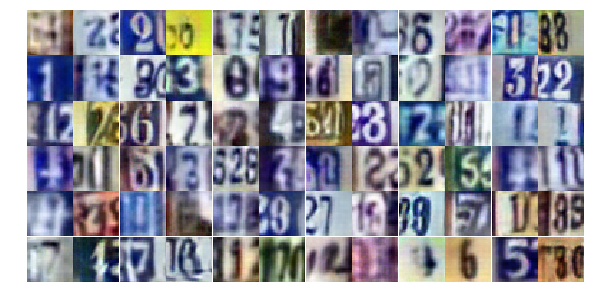

Epoch 24/25... Discriminator Loss: 0.5916... Generator Loss: 1.7294
Epoch 24/25... Discriminator Loss: 0.8190... Generator Loss: 0.8943
Epoch 24/25... Discriminator Loss: 0.4172... Generator Loss: 1.7506
Epoch 24/25... Discriminator Loss: 0.8512... Generator Loss: 1.8938
Epoch 24/25... Discriminator Loss: 0.6893... Generator Loss: 0.9391
Epoch 24/25... Discriminator Loss: 0.5208... Generator Loss: 1.2786
Epoch 24/25... Discriminator Loss: 0.7713... Generator Loss: 0.9379
Epoch 24/25... Discriminator Loss: 1.0314... Generator Loss: 0.6127
Epoch 24/25... Discriminator Loss: 0.3047... Generator Loss: 2.0782
Epoch 24/25... Discriminator Loss: 0.4257... Generator Loss: 1.9569


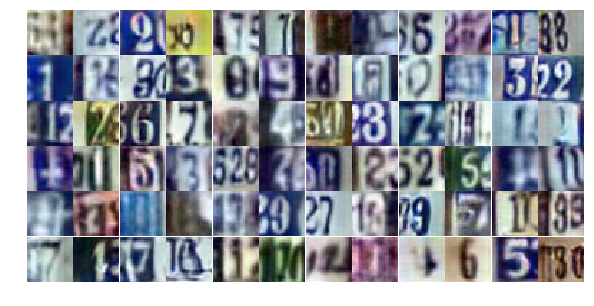

Epoch 24/25... Discriminator Loss: 0.7384... Generator Loss: 1.3266
Epoch 24/25... Discriminator Loss: 1.0971... Generator Loss: 0.5642
Epoch 24/25... Discriminator Loss: 0.9448... Generator Loss: 0.6261
Epoch 24/25... Discriminator Loss: 0.9031... Generator Loss: 0.6997
Epoch 24/25... Discriminator Loss: 0.6325... Generator Loss: 2.3386
Epoch 24/25... Discriminator Loss: 0.7017... Generator Loss: 1.7763
Epoch 24/25... Discriminator Loss: 0.7874... Generator Loss: 0.8670
Epoch 24/25... Discriminator Loss: 0.4993... Generator Loss: 1.6195
Epoch 24/25... Discriminator Loss: 0.6327... Generator Loss: 1.5685
Epoch 24/25... Discriminator Loss: 0.9527... Generator Loss: 0.7135


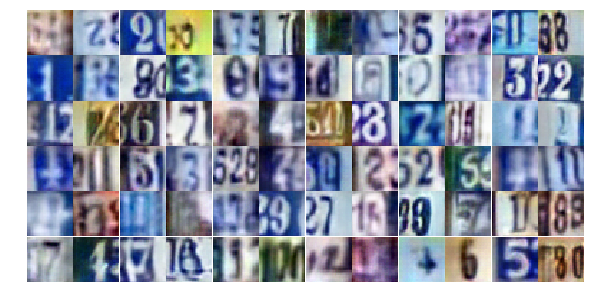

Epoch 24/25... Discriminator Loss: 0.7086... Generator Loss: 1.1512
Epoch 24/25... Discriminator Loss: 0.5365... Generator Loss: 1.4949
Epoch 24/25... Discriminator Loss: 0.6420... Generator Loss: 1.0916
Epoch 24/25... Discriminator Loss: 1.5719... Generator Loss: 0.3412
Epoch 24/25... Discriminator Loss: 0.5829... Generator Loss: 1.7392
Epoch 24/25... Discriminator Loss: 0.4983... Generator Loss: 1.2531
Epoch 24/25... Discriminator Loss: 0.4354... Generator Loss: 1.6736
Epoch 24/25... Discriminator Loss: 1.5769... Generator Loss: 0.3359
Epoch 24/25... Discriminator Loss: 0.7723... Generator Loss: 0.9432
Epoch 24/25... Discriminator Loss: 0.7055... Generator Loss: 2.2240


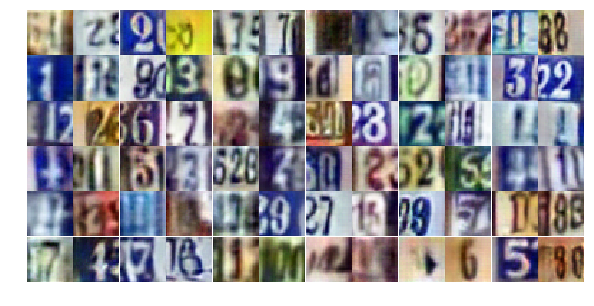

Epoch 24/25... Discriminator Loss: 0.5787... Generator Loss: 1.5617
Epoch 24/25... Discriminator Loss: 0.6367... Generator Loss: 1.1786
Epoch 24/25... Discriminator Loss: 0.9771... Generator Loss: 0.8820
Epoch 24/25... Discriminator Loss: 1.2162... Generator Loss: 0.5615
Epoch 24/25... Discriminator Loss: 0.8294... Generator Loss: 1.3206
Epoch 24/25... Discriminator Loss: 1.1233... Generator Loss: 0.6153
Epoch 24/25... Discriminator Loss: 1.2056... Generator Loss: 0.5302
Epoch 24/25... Discriminator Loss: 0.4834... Generator Loss: 1.4479
Epoch 24/25... Discriminator Loss: 0.9620... Generator Loss: 0.7728
Epoch 24/25... Discriminator Loss: 0.6240... Generator Loss: 1.6525


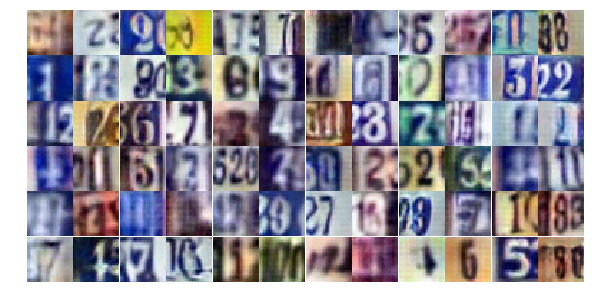

Epoch 24/25... Discriminator Loss: 0.7922... Generator Loss: 0.8422
Epoch 24/25... Discriminator Loss: 2.9093... Generator Loss: 0.1228
Epoch 24/25... Discriminator Loss: 1.7701... Generator Loss: 0.3208
Epoch 24/25... Discriminator Loss: 0.9012... Generator Loss: 1.0455
Epoch 24/25... Discriminator Loss: 0.8782... Generator Loss: 0.7774
Epoch 24/25... Discriminator Loss: 0.6812... Generator Loss: 1.5014
Epoch 24/25... Discriminator Loss: 0.7909... Generator Loss: 0.8701
Epoch 24/25... Discriminator Loss: 0.4828... Generator Loss: 1.4962
Epoch 24/25... Discriminator Loss: 0.6261... Generator Loss: 1.4144
Epoch 24/25... Discriminator Loss: 0.9872... Generator Loss: 1.9271


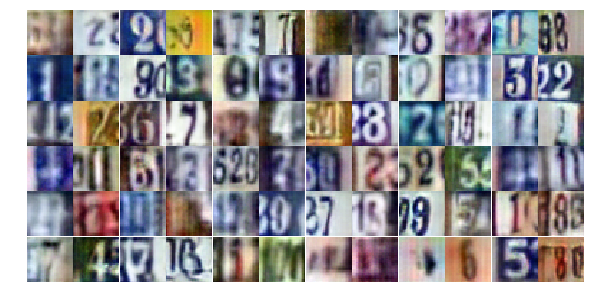

Epoch 24/25... Discriminator Loss: 1.1944... Generator Loss: 0.4959
Epoch 24/25... Discriminator Loss: 1.3662... Generator Loss: 0.4349
Epoch 24/25... Discriminator Loss: 1.1243... Generator Loss: 0.5280
Epoch 24/25... Discriminator Loss: 0.7082... Generator Loss: 1.4957
Epoch 24/25... Discriminator Loss: 0.9795... Generator Loss: 0.7509
Epoch 25/25... Discriminator Loss: 0.7960... Generator Loss: 0.8745
Epoch 25/25... Discriminator Loss: 0.5648... Generator Loss: 1.6052
Epoch 25/25... Discriminator Loss: 0.4655... Generator Loss: 1.5540
Epoch 25/25... Discriminator Loss: 0.8378... Generator Loss: 0.9055
Epoch 25/25... Discriminator Loss: 0.6107... Generator Loss: 1.4067


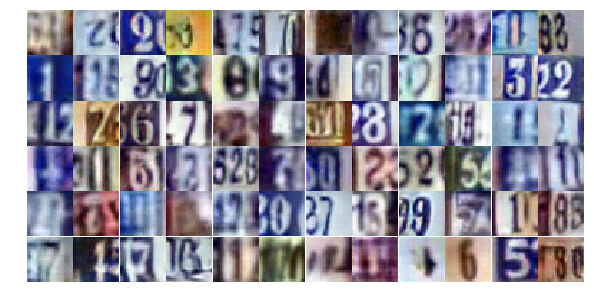

Epoch 25/25... Discriminator Loss: 0.8293... Generator Loss: 0.7895
Epoch 25/25... Discriminator Loss: 1.0617... Generator Loss: 0.6399
Epoch 25/25... Discriminator Loss: 0.8637... Generator Loss: 0.8157
Epoch 25/25... Discriminator Loss: 0.8828... Generator Loss: 0.8517
Epoch 25/25... Discriminator Loss: 0.7762... Generator Loss: 1.1575
Epoch 25/25... Discriminator Loss: 1.0877... Generator Loss: 0.6346
Epoch 25/25... Discriminator Loss: 0.7655... Generator Loss: 0.9258
Epoch 25/25... Discriminator Loss: 0.7028... Generator Loss: 0.9862
Epoch 25/25... Discriminator Loss: 0.5217... Generator Loss: 1.7333
Epoch 25/25... Discriminator Loss: 0.8815... Generator Loss: 0.7484


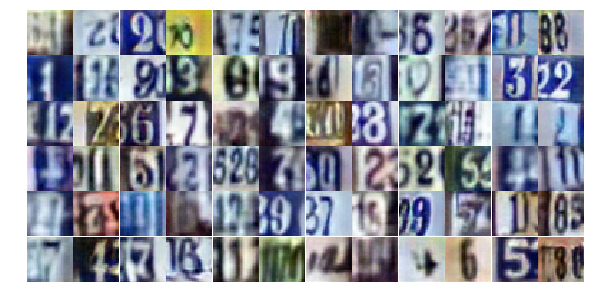

Epoch 25/25... Discriminator Loss: 0.8714... Generator Loss: 0.8902
Epoch 25/25... Discriminator Loss: 0.5077... Generator Loss: 2.6464
Epoch 25/25... Discriminator Loss: 0.8679... Generator Loss: 0.8018
Epoch 25/25... Discriminator Loss: 0.6417... Generator Loss: 1.1244
Epoch 25/25... Discriminator Loss: 0.5685... Generator Loss: 2.0598
Epoch 25/25... Discriminator Loss: 0.5700... Generator Loss: 1.3301
Epoch 25/25... Discriminator Loss: 0.7885... Generator Loss: 0.9156
Epoch 25/25... Discriminator Loss: 1.0086... Generator Loss: 0.6912
Epoch 25/25... Discriminator Loss: 0.6236... Generator Loss: 1.1643
Epoch 25/25... Discriminator Loss: 0.8233... Generator Loss: 0.8297


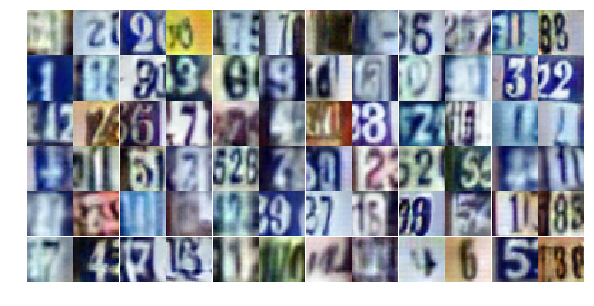

Epoch 25/25... Discriminator Loss: 1.0128... Generator Loss: 0.6574
Epoch 25/25... Discriminator Loss: 0.7733... Generator Loss: 1.9647
Epoch 25/25... Discriminator Loss: 1.7011... Generator Loss: 0.3152
Epoch 25/25... Discriminator Loss: 0.7543... Generator Loss: 0.9050
Epoch 25/25... Discriminator Loss: 0.6595... Generator Loss: 1.5037
Epoch 25/25... Discriminator Loss: 0.6956... Generator Loss: 0.9357
Epoch 25/25... Discriminator Loss: 0.5754... Generator Loss: 1.2414
Epoch 25/25... Discriminator Loss: 0.8886... Generator Loss: 0.7902
Epoch 25/25... Discriminator Loss: 0.7055... Generator Loss: 2.0370
Epoch 25/25... Discriminator Loss: 0.3696... Generator Loss: 1.7904


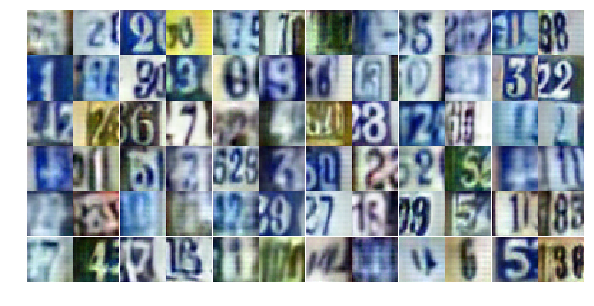

Epoch 25/25... Discriminator Loss: 0.6888... Generator Loss: 1.1071
Epoch 25/25... Discriminator Loss: 0.6959... Generator Loss: 0.9795
Epoch 25/25... Discriminator Loss: 0.6999... Generator Loss: 1.8160
Epoch 25/25... Discriminator Loss: 0.7260... Generator Loss: 1.1339
Epoch 25/25... Discriminator Loss: 1.2870... Generator Loss: 0.4952
Epoch 25/25... Discriminator Loss: 0.6855... Generator Loss: 1.0070
Epoch 25/25... Discriminator Loss: 0.5731... Generator Loss: 1.8730
Epoch 25/25... Discriminator Loss: 0.6344... Generator Loss: 1.0635
Epoch 25/25... Discriminator Loss: 1.9904... Generator Loss: 0.2431
Epoch 25/25... Discriminator Loss: 0.8254... Generator Loss: 2.3128


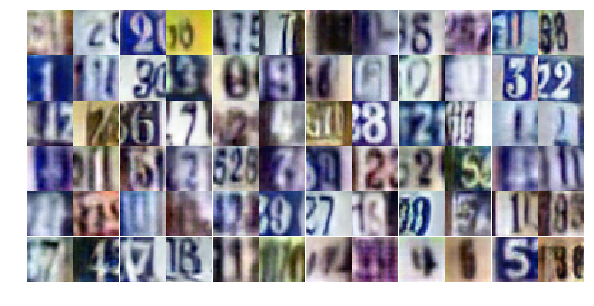

Epoch 25/25... Discriminator Loss: 1.3401... Generator Loss: 2.4095
Epoch 25/25... Discriminator Loss: 0.8256... Generator Loss: 0.8827
Epoch 25/25... Discriminator Loss: 0.6329... Generator Loss: 1.4452
Epoch 25/25... Discriminator Loss: 0.8637... Generator Loss: 0.9075
Epoch 25/25... Discriminator Loss: 0.8695... Generator Loss: 0.9079
Epoch 25/25... Discriminator Loss: 0.4627... Generator Loss: 1.5782
Epoch 25/25... Discriminator Loss: 1.1502... Generator Loss: 0.6049
Epoch 25/25... Discriminator Loss: 0.5114... Generator Loss: 1.5046
Epoch 25/25... Discriminator Loss: 0.7248... Generator Loss: 1.0545
Epoch 25/25... Discriminator Loss: 0.8662... Generator Loss: 0.7664


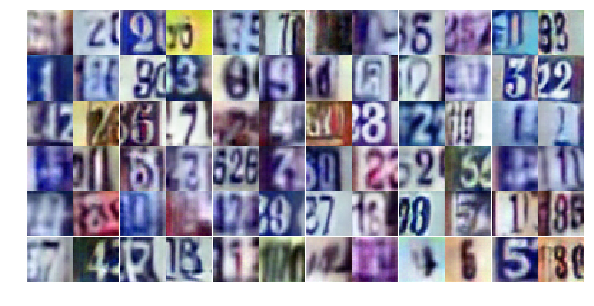

Epoch 25/25... Discriminator Loss: 0.5912... Generator Loss: 1.3723
Epoch 25/25... Discriminator Loss: 1.4290... Generator Loss: 0.3761


In [39]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

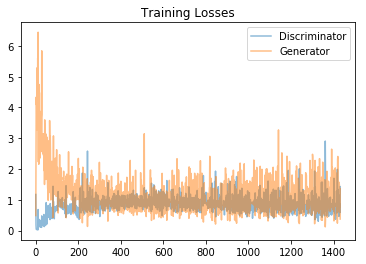

In [40]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

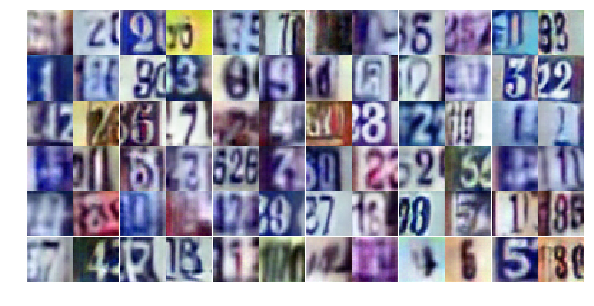

In [41]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))